<a href="https://colab.research.google.com/github/babymlin/Tf_style_transfer_gan/blob/main/ImPiccso_pytorch_1100617.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
%matplotlib inline
import matplotlib
import matplotlib.pyplot as plt
from IPython import display

# 大藝術家 (pytorch)

In [ ]:
import os
import builtins
os.environ['TRIDENT_BACKEND'] = 'pytorch'
!pip install tridentx --upgrade
import trident as T
from trident import *
from trident.data.data_provider import DataProvider
from trident.models import vgg

     |████████████████████████████████| 1.2MB 7.4MB/s 


trident 0.7.3.4


Using Pytorch backend.
Image Data Format: channels_first.
Image Channel Order: rgb.
Pytorch version:1.8.1+cu101.
Automatic Mixed Precision Support:True.


Opencv version:4.1.2.
Pillow version:7.1.2.


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


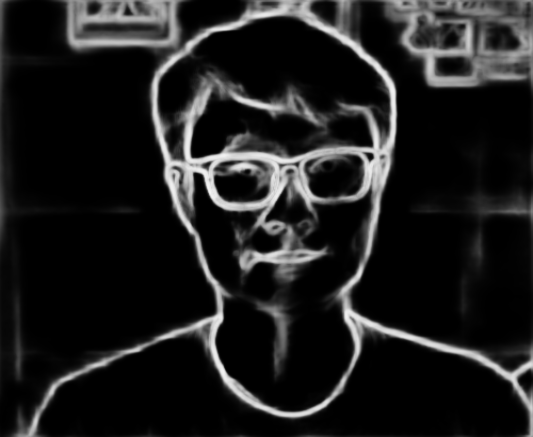

In [ ]:
display.Image('/content/drive/MyDrive/Colab Notebooks/style_transform_gan/gan_image/content2_hed.png',width=300)

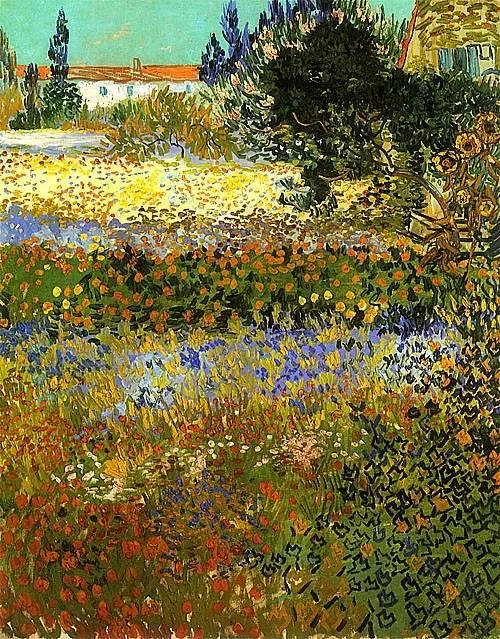

In [ ]:
display.Image('/content/drive/MyDrive/Colab Notebooks/style_transform_gan/gan_image/vangogh_4.jpg',width=300)

In [ ]:

content_img_path='/content/drive/MyDrive/Colab Notebooks/style_transform_gan/gan_image/content2_hed.png'
style_img_path='/content/drive/MyDrive/Colab Notebooks/style_transform_gan/gan_image/vangogh_4.jpg'

content_array=image2array(content_img_path) #讀取一下取得尺寸資訊
H,W,C=content_array.shape


#ImageDataset可以直接輸入圖檔路徑的清單，即可自動轉換成圖檔向量，且依照backend擺放通道位置
content_dataset=ImageDataset(images=[content_img_path]*1000,symbol='content')
style_dataset=ImageDataset(images=[style_img_path]*1000,symbol='style')



iter_data=Iterator(data=ZipDataset(content_dataset,style_dataset),batch_size=1)
         
data_provider=DataProvider(traindata=iter_data)
data_provider.image_transform_funcs=[
                     resize((H,W),keep_aspect=False),
                     normalize(0,255),
                     normalize([0.485, 0.456, 0.406],[0.229, 0.224, 0.225])]
print(data_provider.signature)


content_img,style_img=data_provider.next()
print(content_img.shape)
print(style_img.shape)






data_provider( ) -> content: Tensor[(None, 3, 437, 533)] (ObjectType.rgb), style: Tensor[(None, 3, 437, 533)] (ObjectType.rgb) 
(1, 3, 437, 533)
(1, 3, 437, 533)


In [ ]:
process_img=to_tensor(content_img.copy(),requires_grad=True)

inputs=OrderedDict()
inputs['content']=content_img
inputs['style']=style_img

style_transfer=Model(inputs=inputs,output=process_img)
print(style_transfer.signature)

None( content: Tensor[(None, 3, 437, 533)] , style: Tensor[(None, 3, 437, 533)] ) -> output: Tensor[(None, 3, 437, 533)] (ObjectType.rgb) 


In [ ]:
vgg16=vgg.VGG16(include_top=False,pretrained=True,freeze_features=True)
vgg16.summary()

vgg16.pth: 16.9kMB [00:10, 1.58kMB/s]
model file is downloaded and validated.
138357544 parameters have set untrainable
4097000 parameters have set trainable
16781312 parameters have set trainable
102764544 parameters have set trainable
--------------------------------------------------------------------------------------------------------------------------------
          Layer (type)            Output Shape               Weight                          Bias      Param #   FLOPS #                  
block1_conv1  [Conv2d]            [None, 64, 224, 224]       'weight', [64, 3, 3, 3]         'bias', [64]  1,792  179,730,432  
block1_relu1  [Relu]              [None, 64, 224, 224]                                                 0  0  
block1_conv2  [Conv2d]            [None, 64, 224, 224]       'weight', [64, 64, 3, 3]        'bias', [64]  36,928  3,705,698,304  
block1_relu2  [Relu]              [None, 64, 224, 224]                                                 0  0  
block1_pool  [Ma

ImageClassificationModel()

In [ ]:
#content_features_layers = ['block2_conv2', 'block4_conv2']　＃比較寫實
content_features_layers = [ 'block4_conv2','block5_conv2'] #比較抽象

style_feature_layers = OrderedDict()
style_feature_layers['block1_conv1'] = 0.75
style_feature_layers['block2_conv1'] = 1
style_feature_layers['block3_conv1'] = 2
style_feature_layers['block3_conv3'] = 2
style_feature_layers['block4_conv1'] = 2
style_feature_layers['block4_conv3'] = 2
style_feature_layers['block5_conv1'] = 2
style_feature_layers['block5_conv3'] = 2

In [ ]:

for name, Layer in vgg16.model.named_modules():
    if name in content_features_layers or name in style_feature_layers:
        Layer.keep_output = True

In [ ]:

def content_loss(output, content):
    content.detach()
    content_features = OrderedDict()
    output_features = OrderedDict()
    
    # 將內容圖送入vgg16
    _ = vgg16.model(content)

    # 把剛才設定了keep_output的結果都保存起
    for name, Layer in vgg16.model.named_modules():
        if name in content_features_layers:
            content_features[name] = Layer.output.detach()

    # 將output送入vgg16
    _ = vgg16.model(output)

    # 把剛才設定了keep_output的結果都保存起來
    for name, Layer in vgg16.model.named_modules():
        if name in content_features_layers:
            output_features[name] = Layer.output

    loss = 0
    # 將內容相關神經層取出，計算均方差
    total = (1 - 0.8 ** (len(style_feature_layers) + 1)) / (1 - 0.8)
    for i in range(len(content_features_layers)):
        name=content_features_layers[i]

        #content_loss[name]=\
        weight = 0.8 ** (i + 1) / total
        loss=loss+weight*(((output_features[name] - content_features[name]) ** 2).sum())/(3*H*W)
    return loss


def style_loss(output, style):
    style.detach()
    style_features = OrderedDict()
    output_features = OrderedDict()

    # 將風格圖送入vgg16
    _ = vgg16.model(style)
    # 把剛才設定了keep_output的結果都保存起來
    for name, Layer in vgg16.model.named_modules():
        if name in style_feature_layers:
            style_features[name] = Layer.output.detach()

    # 將output送入vgg16
    _ = vgg16.model(output)
    # 把剛才設定了keep_output的結果都保存起來
    for name, Layer in vgg16.model.named_modules():
        if name in style_feature_layers:
            output_features[name] = Layer.output

    loss = 0
    # 將內容相關神經層取出，計算均方差(除以該神經層的圖片尺寸與通道數)，並乘上對應權重
    #這次加入了各層的加權遞增(越後面越抽象越重要)
    
    total = (1 - 0.8 ** (len(style_feature_layers) +1)) / (1 - 0.8)
    for i in range(len(style_feature_layers)):
        name=style_feature_layers.key_list[i]
        b, c, h, w = style_features[name].shape
        weight = style_feature_layers[name]*(0.8**(len(style_feature_layers)-i)/total)
        
        g1=gram_matrix(output_features[name]-output_features[name].mean())
        
        g2=gram_matrix(style_features[name]-style_features[name].mean())
        
        gg=((g1 - g2.detach()) ** 2).sum()/(c*h*w)
        
        loss=loss+weight *gg

    return loss



In [ ]:
#為了觀察圖片的變化程度，因此自訂一個函數，來計算輸出圖片與原始內容圖的差異程度

def diff(output,content):
    return (output-content).abs().mean()/content.abs().mean()

In [ ]:
def print_loss(training_context):
    #從training_context中取出個別損失函數數值
    print('content_loss',training_context['losses']['content_loss'][-1][-1],
    'style_loss',training_context['losses']['style_loss'][-1][-1])

style_transfer.with_optimizer(optimizer='LBFGS')\
    .with_loss(content_loss,5)\
    .with_loss(style_loss, 120)\
    .with_metric(diff)\
    .trigger_when('on_batch_end',10,action=print_loss)\
    .with_regularizer('total_variation_norm_reg',reg_weight=1)\
    .with_callbacks(TileImageCallback(frequency=50, unit='batch', row=1, reverse_image_transform=data_provider.reverse_image_transform, include_input=False, include_output=True,
                      include_mask=False, include_target=False, imshow=True))

#將data_provider送出數據的第0個做為輸出
#使用LBFGS作為優化器
#設定內容損失，權重為1~250之間
#設定風格損失，權重為1~250之間

#設定diff做為評估指標
#設定total_variation_loss，權重為0.1
#設定TileImageCallback，每隔50個批次畫一次圖，只需要納入輸出，一次顯示一列(也就是每個圖都顯示一張)

content_loss( output: Tensor[None] , content: Tensor[None] ) -> output: Tensor[(None,)]  
style_loss( output: Tensor[None] , style: Tensor[None] ) -> output: Tensor[(None,)]  
diff( output: Tensor[None] , content: Tensor[None] ) -> output: Tensor[(None,)]  


Model(
  (_losses): <function content_loss at 0x7fbfa9c5a4d0>
  (_losses): <function style_loss at 0x7fbfa9a30440>
  (_metrics): <function diff at 0x7fbfa806d950>
  (loss_weights): 5.0
  (loss_weights): 120.0
  (_regs): <function total_variation_norm_reg at 0x7fbfa9d73e60>
)

In [ ]:

plan = TrainingPlan().add_training_item(style_transfer, name='style_transfer')\
    .with_data_loader(data_provider)\
    .repeat_epochs(10)\
    .with_batch_size(1)\
    .print_progress_scheduling(10,unit='batch')

#將前面設定好的style_transfer作為training item
#設定data_provider
#epoch設定為5 (可以視產出結果進行調整)
#批次大小為1
#每隔5個批次列印一次進度

data_feed for style_transfer :
{
    "content": "content",
    "output": "output",
    "style": "style",
    "target": [
        "content",
        "style"
    ]
}
{ content_loss: 0.0, style_loss: 2.54e+11, total_variation_norm_reg_Loss: 0.352, total_losses: 2.54e+11 }
content_loss 0.0 style_loss 254089134080.0
style_transfer     Step: 318ms    | Loss: 1.7e+11 | diff: 10.394%  | lr: 1.000e+00  | epoch: 0  ( 10/1000 )
content_loss 247.14801025390625 style_loss 170452025344.0
style_transfer     Step: 217ms    | Loss: 3.49e+10 | diff: 15.702%  | lr: 1.000e+00  | epoch: 0  ( 20/1000 )
content_loss 273.3688049316406 style_loss 34942275584.0
style_transfer     Step: 219ms    | Loss: 1.14e+10 | diff: 18.751%  | lr: 1.000e+00  | epoch: 0  ( 30/1000 )
content_loss 287.3361511230469 style_loss 11437592576.0
style_transfer     Step: 221ms    | Loss: 5.92e+09 | diff: 20.431%  | lr: 1.000e+00  | epoch: 0  ( 40/1000 )
content_loss 285.468505859375 style_loss 5916617216.0


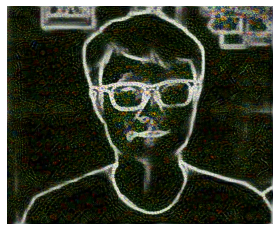

style_transfer     Step: 242ms    | Loss: 3.46e+09 | diff: 21.931%  | lr: 1.000e+00  | epoch: 0  ( 50/1000 )
content_loss 294.9604797363281 style_loss 3462441472.0
style_transfer     Step: 225ms    | Loss: 2.23e+09 | diff: 23.528%  | lr: 1.000e+00  | epoch: 0  ( 60/1000 )
content_loss 295.38275146484375 style_loss 2225998848.0
style_transfer     Step: 228ms    | Loss: 1.54e+09 | diff: 25.182%  | lr: 1.000e+00  | epoch: 0  ( 70/1000 )
content_loss 296.62884521484375 style_loss 1539606144.0
style_transfer     Step: 229ms    | Loss: 1.14e+09 | diff: 26.623%  | lr: 1.000e+00  | epoch: 0  ( 80/1000 )
content_loss 300.6513977050781 style_loss 1140190976.0
style_transfer     Step: 231ms    | Loss: 8.87e+08 | diff: 27.983%  | lr: 1.000e+00  | epoch: 0  ( 90/1000 )
content_loss 300.27899169921875 style_loss 886809152.0


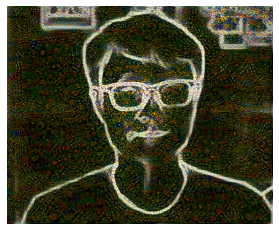

style_transfer     Step: 250ms    | Loss: 6.93e+08 | diff: 29.407%  | lr: 1.000e+00  | epoch: 0  ( 100/1000 )
content_loss 303.2689514160156 style_loss 693152064.0
style_transfer     Step: 235ms    | Loss: 5.62e+08 | diff: 30.440%  | lr: 1.000e+00  | epoch: 0  ( 110/1000 )
content_loss 302.6823425292969 style_loss 562057984.0
style_transfer     Step: 236ms    | Loss: 4.68e+08 | diff: 31.473%  | lr: 1.000e+00  | epoch: 0  ( 120/1000 )
content_loss 303.258544921875 style_loss 468157184.0
style_transfer     Step: 235ms    | Loss: 3.95e+08 | diff: 32.638%  | lr: 1.000e+00  | epoch: 0  ( 130/1000 )
content_loss 304.6072692871094 style_loss 395073664.0
style_transfer     Step: 238ms    | Loss: 3.41e+08 | diff: 33.398%  | lr: 1.000e+00  | epoch: 0  ( 140/1000 )
content_loss 304.2324523925781 style_loss 341399456.0


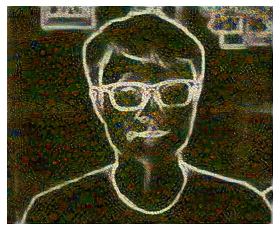

style_transfer     Step: 260ms    | Loss: 2.95e+08 | diff: 34.290%  | lr: 1.000e+00  | epoch: 0  ( 150/1000 )
content_loss 305.321533203125 style_loss 294867424.0
style_transfer     Step: 239ms    | Loss: 2.54e+08 | diff: 35.230%  | lr: 1.000e+00  | epoch: 0  ( 160/1000 )
content_loss 306.61236572265625 style_loss 253759104.0
style_transfer     Step: 239ms    | Loss: 2.23e+08 | diff: 36.047%  | lr: 1.000e+00  | epoch: 0  ( 170/1000 )
content_loss 306.795166015625 style_loss 222951408.0
style_transfer     Step: 239ms    | Loss: 1.97e+08 | diff: 37.031%  | lr: 1.000e+00  | epoch: 0  ( 180/1000 )
content_loss 307.4361572265625 style_loss 197266496.0
style_transfer     Step: 240ms    | Loss: 1.75e+08 | diff: 37.827%  | lr: 1.000e+00  | epoch: 0  ( 190/1000 )
content_loss 307.2952575683594 style_loss 174747488.0


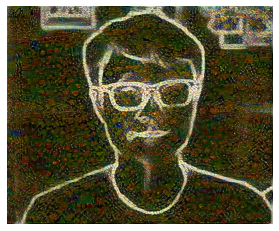

style_transfer     Step: 254ms    | Loss: 1.56e+08 | diff: 38.649%  | lr: 1.000e+00  | epoch: 0  ( 200/1000 )
content_loss 308.21722412109375 style_loss 156126976.0
style_transfer     Step: 240ms    | Loss: 1.41e+08 | diff: 39.326%  | lr: 1.000e+00  | epoch: 0  ( 210/1000 )
content_loss 308.0812072753906 style_loss 140853568.0
style_transfer     Step: 241ms    | Loss: 1.27e+08 | diff: 40.091%  | lr: 1.000e+00  | epoch: 0  ( 220/1000 )
content_loss 308.4284973144531 style_loss 127458256.0
style_transfer     Step: 242ms    | Loss: 1.16e+08 | diff: 40.893%  | lr: 1.000e+00  | epoch: 0  ( 230/1000 )
content_loss 308.6270751953125 style_loss 115652120.0
style_transfer     Step: 242ms    | Loss: 1.06e+08 | diff: 41.614%  | lr: 1.000e+00  | epoch: 0  ( 240/1000 )
content_loss 308.7566223144531 style_loss 106118408.0


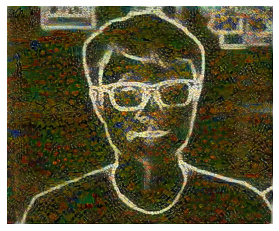

style_transfer     Step: 259ms    | Loss: 9.85e+07 | diff: 42.164%  | lr: 1.000e+00  | epoch: 0  ( 250/1000 )
content_loss 309.0673828125 style_loss 98532376.0
style_transfer     Step: 244ms    | Loss: 9.1e+07 | diff: 42.776%  | lr: 1.000e+00  | epoch: 0  ( 260/1000 )
content_loss 309.2889404296875 style_loss 91001592.0
style_transfer     Step: 244ms    | Loss: 8.49e+07 | diff: 43.326%  | lr: 1.000e+00  | epoch: 0  ( 270/1000 )
content_loss 309.36895751953125 style_loss 84879776.0
style_transfer     Step: 243ms    | Loss: 7.95e+07 | diff: 43.957%  | lr: 1.000e+00  | epoch: 0  ( 280/1000 )
content_loss 309.47943115234375 style_loss 79495856.0
style_transfer     Step: 243ms    | Loss: 7.5e+07 | diff: 44.528%  | lr: 1.000e+00  | epoch: 0  ( 290/1000 )
content_loss 309.5673522949219 style_loss 74961240.0


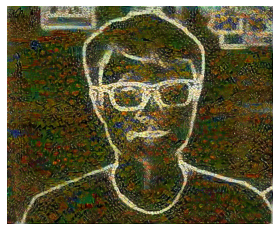

style_transfer     Step: 259ms    | Loss: 7.02e+07 | diff: 45.071%  | lr: 1.000e+00  | epoch: 0  ( 300/1000 )
content_loss 309.89752197265625 style_loss 70215424.0
style_transfer     Step: 246ms    | Loss: 6.67e+07 | diff: 45.505%  | lr: 1.000e+00  | epoch: 0  ( 310/1000 )
content_loss 310.1020202636719 style_loss 66665348.0
style_transfer     Step: 247ms    | Loss: 6.34e+07 | diff: 45.939%  | lr: 1.000e+00  | epoch: 0  ( 320/1000 )
content_loss 310.2613220214844 style_loss 63421536.0
style_transfer     Step: 247ms    | Loss: 6.03e+07 | diff: 46.423%  | lr: 1.000e+00  | epoch: 0  ( 330/1000 )
content_loss 309.9932556152344 style_loss 60253844.0
style_transfer     Step: 247ms    | Loss: 5.75e+07 | diff: 46.852%  | lr: 1.000e+00  | epoch: 0  ( 340/1000 )
content_loss 310.332763671875 style_loss 57450752.0


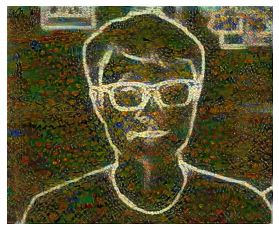

style_transfer     Step: 263ms    | Loss: 5.5e+07 | diff: 47.260%  | lr: 1.000e+00  | epoch: 0  ( 350/1000 )
content_loss 310.5247497558594 style_loss 55018284.0
style_transfer     Step: 247ms    | Loss: 5.29e+07 | diff: 47.610%  | lr: 1.000e+00  | epoch: 0  ( 360/1000 )
content_loss 310.53887939453125 style_loss 52898004.0
style_transfer     Step: 246ms    | Loss: 5.07e+07 | diff: 47.989%  | lr: 1.000e+00  | epoch: 0  ( 370/1000 )
content_loss 310.6644592285156 style_loss 50684364.0
style_transfer     Step: 246ms    | Loss: 4.86e+07 | diff: 48.359%  | lr: 1.000e+00  | epoch: 0  ( 380/1000 )
content_loss 310.7215270996094 style_loss 48621588.0
style_transfer     Step: 246ms    | Loss: 4.68e+07 | diff: 48.729%  | lr: 1.000e+00  | epoch: 0  ( 390/1000 )
content_loss 310.8130187988281 style_loss 46804976.0


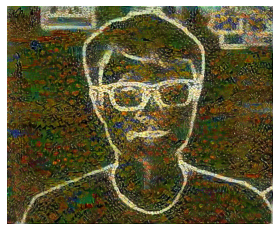

style_transfer     Step: 261ms    | Loss: 4.51e+07 | diff: 49.068%  | lr: 1.000e+00  | epoch: 0  ( 400/1000 )
content_loss 310.9647521972656 style_loss 45099876.0
style_transfer     Step: 245ms    | Loss: 4.35e+07 | diff: 49.404%  | lr: 1.000e+00  | epoch: 0  ( 410/1000 )
content_loss 311.1929626464844 style_loss 43464004.0
style_transfer     Step: 245ms    | Loss: 4.2e+07 | diff: 49.727%  | lr: 1.000e+00  | epoch: 0  ( 420/1000 )
content_loss 311.1541748046875 style_loss 41953692.0
style_transfer     Step: 244ms    | Loss: 4.08e+07 | diff: 50.005%  | lr: 1.000e+00  | epoch: 0  ( 430/1000 )
content_loss 311.24737548828125 style_loss 40794224.0
style_transfer     Step: 244ms    | Loss: 3.94e+07 | diff: 50.321%  | lr: 1.000e+00  | epoch: 0  ( 440/1000 )
content_loss 311.2378234863281 style_loss 39418164.0


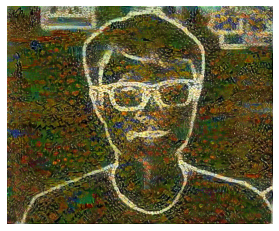

style_transfer     Step: 259ms    | Loss: 3.83e+07 | diff: 50.582%  | lr: 1.000e+00  | epoch: 0  ( 450/1000 )
content_loss 311.3087463378906 style_loss 38313356.0
style_transfer     Step: 245ms    | Loss: 3.72e+07 | diff: 50.915%  | lr: 1.000e+00  | epoch: 0  ( 460/1000 )
content_loss 311.45068359375 style_loss 37229712.0
style_transfer     Step: 244ms    | Loss: 3.63e+07 | diff: 51.135%  | lr: 1.000e+00  | epoch: 0  ( 470/1000 )
content_loss 311.36669921875 style_loss 36331064.0
style_transfer     Step: 245ms    | Loss: 3.53e+07 | diff: 51.408%  | lr: 1.000e+00  | epoch: 0  ( 480/1000 )
content_loss 311.3404541015625 style_loss 35298120.0
style_transfer     Step: 244ms    | Loss: 3.44e+07 | diff: 51.657%  | lr: 1.000e+00  | epoch: 0  ( 490/1000 )
content_loss 311.1542053222656 style_loss 34369472.0


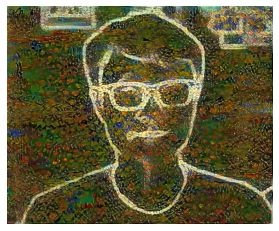

style_transfer     Step: 257ms    | Loss: 3.36e+07 | diff: 51.899%  | lr: 1.000e+00  | epoch: 0  ( 500/1000 )
content_loss 311.2502746582031 style_loss 33560436.0
style_transfer     Step: 244ms    | Loss: 3.28e+07 | diff: 52.158%  | lr: 1.000e+00  | epoch: 0  ( 510/1000 )
content_loss 311.4360046386719 style_loss 32783384.0
style_transfer     Step: 244ms    | Loss: 3.2e+07 | diff: 52.402%  | lr: 1.000e+00  | epoch: 0  ( 520/1000 )
content_loss 311.5462646484375 style_loss 31996208.0
style_transfer     Step: 243ms    | Loss: 3.13e+07 | diff: 52.636%  | lr: 1.000e+00  | epoch: 0  ( 530/1000 )
content_loss 311.5932312011719 style_loss 31290536.0
style_transfer     Step: 243ms    | Loss: 3.06e+07 | diff: 52.854%  | lr: 1.000e+00  | epoch: 0  ( 540/1000 )
content_loss 311.5157470703125 style_loss 30582218.0


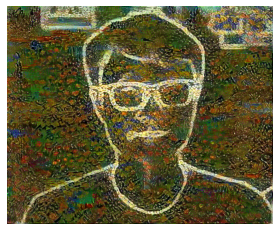

style_transfer     Step: 257ms    | Loss: 3e+07 | diff: 53.060%  | lr: 1.000e+00  | epoch: 0  ( 550/1000 )
content_loss 311.55712890625 style_loss 29954312.0
style_transfer     Step: 244ms    | Loss: 2.93e+07 | diff: 53.297%  | lr: 1.000e+00  | epoch: 0  ( 560/1000 )
content_loss 311.7893981933594 style_loss 29343224.0
style_transfer     Step: 244ms    | Loss: 2.88e+07 | diff: 53.495%  | lr: 1.000e+00  | epoch: 0  ( 570/1000 )
content_loss 311.8262023925781 style_loss 28791116.0
style_transfer     Step: 243ms    | Loss: 2.82e+07 | diff: 53.699%  | lr: 1.000e+00  | epoch: 0  ( 580/1000 )
content_loss 311.8925476074219 style_loss 28225376.0
style_transfer     Step: 244ms    | Loss: 2.77e+07 | diff: 53.891%  | lr: 1.000e+00  | epoch: 0  ( 590/1000 )
content_loss 311.8999328613281 style_loss 27686408.0


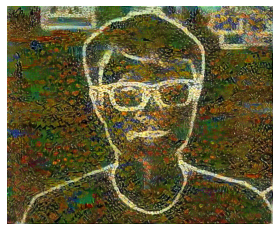

style_transfer     Step: 258ms    | Loss: 2.72e+07 | diff: 54.086%  | lr: 1.000e+00  | epoch: 0  ( 600/1000 )
content_loss 311.888916015625 style_loss 27216612.0
style_transfer     Step: 245ms    | Loss: 2.67e+07 | diff: 54.282%  | lr: 1.000e+00  | epoch: 0  ( 610/1000 )
content_loss 312.0156555175781 style_loss 26700086.0
style_transfer     Step: 245ms    | Loss: 2.62e+07 | diff: 54.436%  | lr: 1.000e+00  | epoch: 0  ( 620/1000 )
content_loss 311.9696960449219 style_loss 26233390.0
style_transfer     Step: 244ms    | Loss: 2.58e+07 | diff: 54.629%  | lr: 1.000e+00  | epoch: 0  ( 630/1000 )
content_loss 312.13494873046875 style_loss 25814522.0
style_transfer     Step: 244ms    | Loss: 2.54e+07 | diff: 54.799%  | lr: 1.000e+00  | epoch: 0  ( 640/1000 )
content_loss 312.19451904296875 style_loss 25381688.0


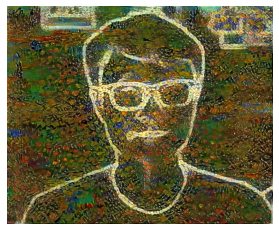

style_transfer     Step: 259ms    | Loss: 2.5e+07 | diff: 54.967%  | lr: 1.000e+00  | epoch: 0  ( 650/1000 )
content_loss 312.2288818359375 style_loss 24992788.0
style_transfer     Step: 245ms    | Loss: 2.46e+07 | diff: 55.139%  | lr: 1.000e+00  | epoch: 0  ( 660/1000 )
content_loss 312.3169860839844 style_loss 24605868.0
style_transfer     Step: 246ms    | Loss: 2.43e+07 | diff: 55.280%  | lr: 1.000e+00  | epoch: 0  ( 670/1000 )
content_loss 312.35333251953125 style_loss 24277838.0
style_transfer     Step: 245ms    | Loss: 2.39e+07 | diff: 55.432%  | lr: 1.000e+00  | epoch: 0  ( 680/1000 )
content_loss 312.4126892089844 style_loss 23911258.0
style_transfer     Step: 245ms    | Loss: 2.36e+07 | diff: 55.577%  | lr: 1.000e+00  | epoch: 0  ( 690/1000 )
content_loss 312.4236755371094 style_loss 23590290.0


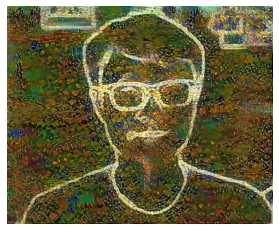

style_transfer     Step: 258ms    | Loss: 2.32e+07 | diff: 55.732%  | lr: 1.000e+00  | epoch: 0  ( 700/1000 )
content_loss 312.4694519042969 style_loss 23241676.0
style_transfer     Step: 244ms    | Loss: 2.3e+07 | diff: 55.871%  | lr: 1.000e+00  | epoch: 0  ( 710/1000 )
content_loss 312.5489196777344 style_loss 22979426.0
style_transfer     Step: 245ms    | Loss: 2.27e+07 | diff: 56.015%  | lr: 1.000e+00  | epoch: 0  ( 720/1000 )
content_loss 312.6018371582031 style_loss 22672928.0
style_transfer     Step: 245ms    | Loss: 2.24e+07 | diff: 56.161%  | lr: 1.000e+00  | epoch: 0  ( 730/1000 )
content_loss 312.6549987792969 style_loss 22382044.0
style_transfer     Step: 245ms    | Loss: 2.21e+07 | diff: 56.328%  | lr: 1.000e+00  | epoch: 0  ( 740/1000 )
content_loss 312.70477294921875 style_loss 22103308.0


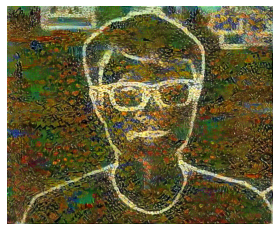

style_transfer     Step: 259ms    | Loss: 2.18e+07 | diff: 56.474%  | lr: 1.000e+00  | epoch: 0  ( 750/1000 )
content_loss 312.7353820800781 style_loss 21790260.0
style_transfer     Step: 245ms    | Loss: 2.15e+07 | diff: 56.617%  | lr: 1.000e+00  | epoch: 0  ( 760/1000 )
content_loss 312.740234375 style_loss 21525520.0
style_transfer     Step: 244ms    | Loss: 2.13e+07 | diff: 56.739%  | lr: 1.000e+00  | epoch: 0  ( 770/1000 )
content_loss 312.81988525390625 style_loss 21275360.0
style_transfer     Step: 244ms    | Loss: 2.1e+07 | diff: 56.865%  | lr: 1.000e+00  | epoch: 0  ( 780/1000 )
content_loss 312.88214111328125 style_loss 21014384.0
style_transfer     Step: 244ms    | Loss: 2.08e+07 | diff: 56.984%  | lr: 1.000e+00  | epoch: 0  ( 790/1000 )
content_loss 312.9036865234375 style_loss 20779902.0


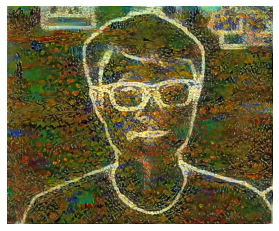

style_transfer     Step: 257ms    | Loss: 2.06e+07 | diff: 57.104%  | lr: 1.000e+00  | epoch: 0  ( 800/1000 )
content_loss 312.9199523925781 style_loss 20571712.0
style_transfer     Step: 245ms    | Loss: 2.03e+07 | diff: 57.224%  | lr: 1.000e+00  | epoch: 0  ( 810/1000 )
content_loss 312.8720397949219 style_loss 20339656.0
style_transfer     Step: 244ms    | Loss: 2.01e+07 | diff: 57.347%  | lr: 1.000e+00  | epoch: 0  ( 820/1000 )
content_loss 312.932861328125 style_loss 20139418.0
style_transfer     Step: 245ms    | Loss: 1.99e+07 | diff: 57.485%  | lr: 1.000e+00  | epoch: 0  ( 830/1000 )
content_loss 312.9405517578125 style_loss 19905400.0
style_transfer     Step: 244ms    | Loss: 1.97e+07 | diff: 57.611%  | lr: 1.000e+00  | epoch: 0  ( 840/1000 )
content_loss 312.9308166503906 style_loss 19694244.0


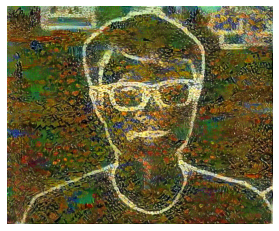

style_transfer     Step: 260ms    | Loss: 1.95e+07 | diff: 57.721%  | lr: 1.000e+00  | epoch: 0  ( 850/1000 )
content_loss 312.9266052246094 style_loss 19489476.0
style_transfer     Step: 245ms    | Loss: 1.93e+07 | diff: 57.849%  | lr: 1.000e+00  | epoch: 0  ( 860/1000 )
content_loss 313.0038146972656 style_loss 19296432.0
style_transfer     Step: 244ms    | Loss: 1.91e+07 | diff: 57.947%  | lr: 1.000e+00  | epoch: 0  ( 870/1000 )
content_loss 313.0770263671875 style_loss 19107798.0
style_transfer     Step: 245ms    | Loss: 1.89e+07 | diff: 58.066%  | lr: 1.000e+00  | epoch: 0  ( 880/1000 )
content_loss 313.07745361328125 style_loss 18928280.0
style_transfer     Step: 245ms    | Loss: 1.88e+07 | diff: 58.176%  | lr: 1.000e+00  | epoch: 0  ( 890/1000 )
content_loss 313.1037292480469 style_loss 18751058.0


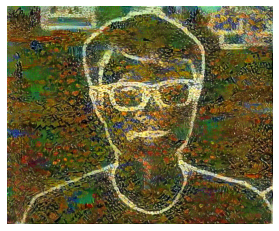

style_transfer     Step: 259ms    | Loss: 1.86e+07 | diff: 58.262%  | lr: 1.000e+00  | epoch: 0  ( 900/1000 )
content_loss 313.1116027832031 style_loss 18597882.0
style_transfer     Step: 246ms    | Loss: 1.84e+07 | diff: 58.363%  | lr: 1.000e+00  | epoch: 0  ( 910/1000 )
content_loss 313.20166015625 style_loss 18427924.0
style_transfer     Step: 246ms    | Loss: 1.83e+07 | diff: 58.489%  | lr: 1.000e+00  | epoch: 0  ( 920/1000 )
content_loss 313.22369384765625 style_loss 18282710.0
style_transfer     Step: 244ms    | Loss: 1.81e+07 | diff: 58.561%  | lr: 1.000e+00  | epoch: 0  ( 930/1000 )
content_loss 313.2748107910156 style_loss 18140116.0
style_transfer     Step: 246ms    | Loss: 1.8e+07 | diff: 58.653%  | lr: 1.000e+00  | epoch: 0  ( 940/1000 )
content_loss 313.3020324707031 style_loss 17994740.0


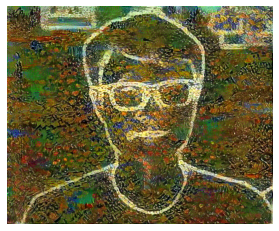

style_transfer     Step: 258ms    | Loss: 1.78e+07 | diff: 58.752%  | lr: 1.000e+00  | epoch: 0  ( 950/1000 )
content_loss 313.36712646484375 style_loss 17848016.0
style_transfer     Step: 245ms    | Loss: 1.77e+07 | diff: 58.856%  | lr: 1.000e+00  | epoch: 0  ( 960/1000 )
content_loss 313.40045166015625 style_loss 17707278.0
style_transfer     Step: 245ms    | Loss: 1.76e+07 | diff: 58.950%  | lr: 1.000e+00  | epoch: 0  ( 970/1000 )
content_loss 313.4353942871094 style_loss 17554960.0
style_transfer     Step: 246ms    | Loss: 1.74e+07 | diff: 59.053%  | lr: 1.000e+00  | epoch: 0  ( 980/1000 )
content_loss 313.49176025390625 style_loss 17413002.0
style_transfer     Step: 245ms    | Loss: 1.73e+07 | diff: 59.141%  | lr: 1.000e+00  | epoch: 0  ( 990/1000 )
content_loss 313.5177307128906 style_loss 17274826.0


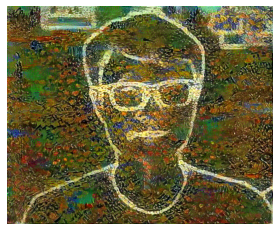

{ content_loss: 3.14e+02, style_loss: 1.72e+07, total_variation_norm_reg_Loss: 5.03, total_losses: 1.72e+07 }
content_loss 313.57080078125 style_loss 17150840.0
style_transfer     Step: 459ms    | Loss: 1.7e+07 | diff: 59.321%  | lr: 1.000e+00  | epoch: 1  ( 10/1000 )
content_loss 313.587890625 style_loss 17033102.0
style_transfer     Step: 246ms    | Loss: 1.69e+07 | diff: 59.413%  | lr: 1.000e+00  | epoch: 1  ( 20/1000 )
content_loss 313.6017150878906 style_loss 16908192.0
style_transfer     Step: 246ms    | Loss: 1.68e+07 | diff: 59.491%  | lr: 1.000e+00  | epoch: 1  ( 30/1000 )
content_loss 313.6172180175781 style_loss 16791456.0
style_transfer     Step: 245ms    | Loss: 1.67e+07 | diff: 59.590%  | lr: 1.000e+00  | epoch: 1  ( 40/1000 )
content_loss 313.6415710449219 style_loss 16666993.0


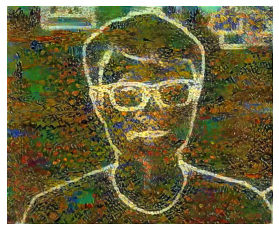

style_transfer     Step: 259ms    | Loss: 1.65e+07 | diff: 59.681%  | lr: 1.000e+00  | epoch: 1  ( 50/1000 )
content_loss 313.6239013671875 style_loss 16535361.0
style_transfer     Step: 245ms    | Loss: 1.64e+07 | diff: 59.776%  | lr: 1.000e+00  | epoch: 1  ( 60/1000 )
content_loss 313.6768798828125 style_loss 16425360.0
style_transfer     Step: 245ms    | Loss: 1.63e+07 | diff: 59.840%  | lr: 1.000e+00  | epoch: 1  ( 70/1000 )
content_loss 313.645263671875 style_loss 16324907.0
style_transfer     Step: 246ms    | Loss: 1.62e+07 | diff: 59.926%  | lr: 1.000e+00  | epoch: 1  ( 80/1000 )
content_loss 313.7243957519531 style_loss 16220734.0
style_transfer     Step: 245ms    | Loss: 1.61e+07 | diff: 60.005%  | lr: 1.000e+00  | epoch: 1  ( 90/1000 )
content_loss 313.6731262207031 style_loss 16111633.0


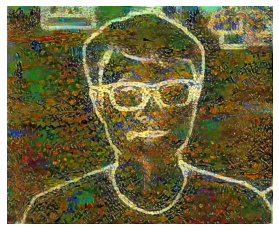

style_transfer     Step: 258ms    | Loss: 1.6e+07 | diff: 60.094%  | lr: 1.000e+00  | epoch: 1  ( 100/1000 )
content_loss 313.7135314941406 style_loss 15997549.0
style_transfer     Step: 245ms    | Loss: 1.59e+07 | diff: 60.173%  | lr: 1.000e+00  | epoch: 1  ( 110/1000 )
content_loss 313.79669189453125 style_loss 15894336.0
style_transfer     Step: 245ms    | Loss: 1.58e+07 | diff: 60.250%  | lr: 1.000e+00  | epoch: 1  ( 120/1000 )
content_loss 313.8218688964844 style_loss 15801596.0
style_transfer     Step: 245ms    | Loss: 1.57e+07 | diff: 60.326%  | lr: 1.000e+00  | epoch: 1  ( 130/1000 )
content_loss 313.8693542480469 style_loss 15703474.0
style_transfer     Step: 246ms    | Loss: 1.56e+07 | diff: 60.397%  | lr: 1.000e+00  | epoch: 1  ( 140/1000 )
content_loss 313.9296875 style_loss 15606212.0


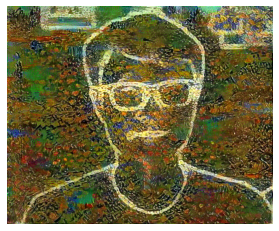

style_transfer     Step: 259ms    | Loss: 1.55e+07 | diff: 60.479%  | lr: 1.000e+00  | epoch: 1  ( 150/1000 )
content_loss 313.9359130859375 style_loss 15509229.0
style_transfer     Step: 245ms    | Loss: 1.54e+07 | diff: 60.566%  | lr: 1.000e+00  | epoch: 1  ( 160/1000 )
content_loss 313.9307861328125 style_loss 15416061.0
style_transfer     Step: 246ms    | Loss: 1.53e+07 | diff: 60.630%  | lr: 1.000e+00  | epoch: 1  ( 170/1000 )
content_loss 313.9550476074219 style_loss 15326696.0
style_transfer     Step: 246ms    | Loss: 1.52e+07 | diff: 60.704%  | lr: 1.000e+00  | epoch: 1  ( 180/1000 )
content_loss 313.9757385253906 style_loss 15238624.0
style_transfer     Step: 245ms    | Loss: 1.52e+07 | diff: 60.771%  | lr: 1.000e+00  | epoch: 1  ( 190/1000 )
content_loss 313.9957275390625 style_loss 15154508.0


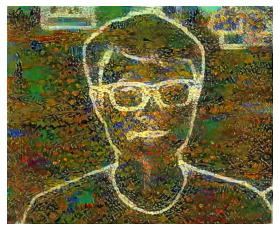

style_transfer     Step: 260ms    | Loss: 1.51e+07 | diff: 60.856%  | lr: 1.000e+00  | epoch: 1  ( 200/1000 )
content_loss 314.0003356933594 style_loss 15064200.0
style_transfer     Step: 246ms    | Loss: 1.5e+07 | diff: 60.921%  | lr: 1.000e+00  | epoch: 1  ( 210/1000 )
content_loss 313.9739685058594 style_loss 14985088.0
style_transfer     Step: 245ms    | Loss: 1.49e+07 | diff: 60.989%  | lr: 1.000e+00  | epoch: 1  ( 220/1000 )
content_loss 313.997314453125 style_loss 14902503.0
style_transfer     Step: 245ms    | Loss: 1.48e+07 | diff: 61.050%  | lr: 1.000e+00  | epoch: 1  ( 230/1000 )
content_loss 314.0037841796875 style_loss 14828518.0
style_transfer     Step: 245ms    | Loss: 1.48e+07 | diff: 61.122%  | lr: 1.000e+00  | epoch: 1  ( 240/1000 )
content_loss 314.0618591308594 style_loss 14751040.0


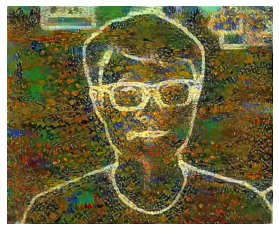

style_transfer     Step: 260ms    | Loss: 1.47e+07 | diff: 61.181%  | lr: 1.000e+00  | epoch: 1  ( 250/1000 )
content_loss 314.0240173339844 style_loss 14680413.0
style_transfer     Step: 245ms    | Loss: 1.46e+07 | diff: 61.248%  | lr: 1.000e+00  | epoch: 1  ( 260/1000 )
content_loss 314.0542297363281 style_loss 14602238.0
style_transfer     Step: 246ms    | Loss: 1.45e+07 | diff: 61.321%  | lr: 1.000e+00  | epoch: 1  ( 270/1000 )
content_loss 314.08770751953125 style_loss 14531670.0
style_transfer     Step: 246ms    | Loss: 1.45e+07 | diff: 61.392%  | lr: 1.000e+00  | epoch: 1  ( 280/1000 )
content_loss 314.0998229980469 style_loss 14457874.0
style_transfer     Step: 245ms    | Loss: 1.44e+07 | diff: 61.454%  | lr: 1.000e+00  | epoch: 1  ( 290/1000 )
content_loss 314.0979919433594 style_loss 14390145.0


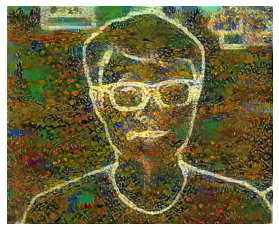

style_transfer     Step: 267ms    | Loss: 1.43e+07 | diff: 61.521%  | lr: 1.000e+00  | epoch: 1  ( 300/1000 )
content_loss 314.095947265625 style_loss 14318763.0
style_transfer     Step: 245ms    | Loss: 1.43e+07 | diff: 61.584%  | lr: 1.000e+00  | epoch: 1  ( 310/1000 )
content_loss 314.1143493652344 style_loss 14249702.0
style_transfer     Step: 245ms    | Loss: 1.42e+07 | diff: 61.644%  | lr: 1.000e+00  | epoch: 1  ( 320/1000 )
content_loss 314.125244140625 style_loss 14182460.0
style_transfer     Step: 245ms    | Loss: 1.41e+07 | diff: 61.709%  | lr: 1.000e+00  | epoch: 1  ( 330/1000 )
content_loss 314.1517028808594 style_loss 14122755.0
style_transfer     Step: 246ms    | Loss: 1.41e+07 | diff: 61.755%  | lr: 1.000e+00  | epoch: 1  ( 340/1000 )
content_loss 314.20233154296875 style_loss 14061608.0


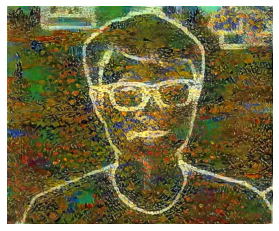

style_transfer     Step: 259ms    | Loss: 1.4e+07 | diff: 61.822%  | lr: 1.000e+00  | epoch: 1  ( 350/1000 )
content_loss 314.20159912109375 style_loss 14000750.0
style_transfer     Step: 245ms    | Loss: 1.39e+07 | diff: 61.881%  | lr: 1.000e+00  | epoch: 1  ( 360/1000 )
content_loss 314.22869873046875 style_loss 13939398.0
style_transfer     Step: 246ms    | Loss: 1.39e+07 | diff: 61.948%  | lr: 1.000e+00  | epoch: 1  ( 370/1000 )
content_loss 314.2674560546875 style_loss 13873440.0
style_transfer     Step: 245ms    | Loss: 1.38e+07 | diff: 62.008%  | lr: 1.000e+00  | epoch: 1  ( 380/1000 )
content_loss 314.2646484375 style_loss 13810440.0
style_transfer     Step: 245ms    | Loss: 1.38e+07 | diff: 62.068%  | lr: 1.000e+00  | epoch: 1  ( 390/1000 )
content_loss 314.2464599609375 style_loss 13755475.0


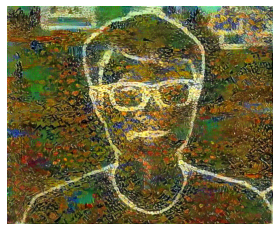

style_transfer     Step: 258ms    | Loss: 1.37e+07 | diff: 62.122%  | lr: 1.000e+00  | epoch: 1  ( 400/1000 )
content_loss 314.2353210449219 style_loss 13695899.0
style_transfer     Step: 245ms    | Loss: 1.36e+07 | diff: 62.187%  | lr: 1.000e+00  | epoch: 1  ( 410/1000 )
content_loss 314.25592041015625 style_loss 13633999.0
style_transfer     Step: 245ms    | Loss: 1.36e+07 | diff: 62.244%  | lr: 1.000e+00  | epoch: 1  ( 420/1000 )
content_loss 314.2499694824219 style_loss 13575253.0
style_transfer     Step: 245ms    | Loss: 1.35e+07 | diff: 62.310%  | lr: 1.000e+00  | epoch: 1  ( 430/1000 )
content_loss 314.2340393066406 style_loss 13519765.0
style_transfer     Step: 246ms    | Loss: 1.35e+07 | diff: 62.363%  | lr: 1.000e+00  | epoch: 1  ( 440/1000 )
content_loss 314.2747497558594 style_loss 13464832.0


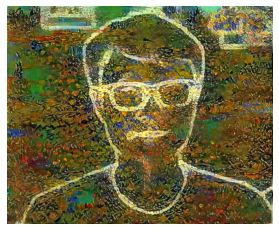

style_transfer     Step: 259ms    | Loss: 1.34e+07 | diff: 62.415%  | lr: 1.000e+00  | epoch: 1  ( 450/1000 )
content_loss 314.3006286621094 style_loss 13413632.0
style_transfer     Step: 245ms    | Loss: 1.34e+07 | diff: 62.481%  | lr: 1.000e+00  | epoch: 1  ( 460/1000 )
content_loss 314.330810546875 style_loss 13356240.0
style_transfer     Step: 245ms    | Loss: 1.33e+07 | diff: 62.533%  | lr: 1.000e+00  | epoch: 1  ( 470/1000 )
content_loss 314.3277587890625 style_loss 13310931.0
style_transfer     Step: 245ms    | Loss: 1.33e+07 | diff: 62.584%  | lr: 1.000e+00  | epoch: 1  ( 480/1000 )
content_loss 314.3324890136719 style_loss 13259174.0
style_transfer     Step: 245ms    | Loss: 1.32e+07 | diff: 62.635%  | lr: 1.000e+00  | epoch: 1  ( 490/1000 )
content_loss 314.3299560546875 style_loss 13213882.0


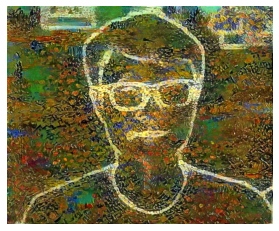

style_transfer     Step: 258ms    | Loss: 1.32e+07 | diff: 62.690%  | lr: 1.000e+00  | epoch: 1  ( 500/1000 )
content_loss 314.3447265625 style_loss 13162291.0
style_transfer     Step: 246ms    | Loss: 1.31e+07 | diff: 62.749%  | lr: 1.000e+00  | epoch: 1  ( 510/1000 )
content_loss 314.38861083984375 style_loss 13113659.0
style_transfer     Step: 245ms    | Loss: 1.31e+07 | diff: 62.800%  | lr: 1.000e+00  | epoch: 1  ( 520/1000 )
content_loss 314.3846130371094 style_loss 13061891.0
style_transfer     Step: 245ms    | Loss: 1.3e+07 | diff: 62.856%  | lr: 1.000e+00  | epoch: 1  ( 530/1000 )
content_loss 314.4437255859375 style_loss 13011621.0
style_transfer     Step: 245ms    | Loss: 1.3e+07 | diff: 62.912%  | lr: 1.000e+00  | epoch: 1  ( 540/1000 )
content_loss 314.41693115234375 style_loss 12963563.0


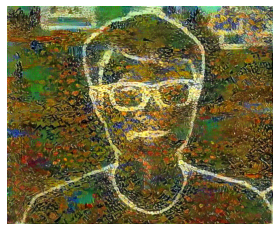

style_transfer     Step: 259ms    | Loss: 1.29e+07 | diff: 62.962%  | lr: 1.000e+00  | epoch: 1  ( 550/1000 )
content_loss 314.43670654296875 style_loss 12919914.0
style_transfer     Step: 245ms    | Loss: 1.29e+07 | diff: 63.011%  | lr: 1.000e+00  | epoch: 1  ( 560/1000 )
content_loss 314.4449157714844 style_loss 12881422.0
style_transfer     Step: 245ms    | Loss: 1.28e+07 | diff: 63.063%  | lr: 1.000e+00  | epoch: 1  ( 570/1000 )
content_loss 314.4533996582031 style_loss 12835310.0
style_transfer     Step: 245ms    | Loss: 1.28e+07 | diff: 63.113%  | lr: 1.000e+00  | epoch: 1  ( 580/1000 )
content_loss 314.478271484375 style_loss 12791865.0
style_transfer     Step: 245ms    | Loss: 1.27e+07 | diff: 63.168%  | lr: 1.000e+00  | epoch: 1  ( 590/1000 )
content_loss 314.466064453125 style_loss 12745879.0


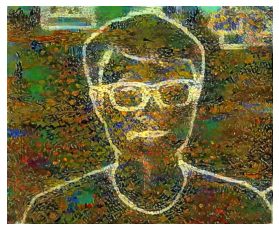

style_transfer     Step: 259ms    | Loss: 1.27e+07 | diff: 63.222%  | lr: 1.000e+00  | epoch: 1  ( 600/1000 )
content_loss 314.462890625 style_loss 12701775.0
style_transfer     Step: 246ms    | Loss: 1.27e+07 | diff: 63.266%  | lr: 1.000e+00  | epoch: 1  ( 610/1000 )
content_loss 314.4390869140625 style_loss 12658295.0
style_transfer     Step: 246ms    | Loss: 1.26e+07 | diff: 63.334%  | lr: 1.000e+00  | epoch: 1  ( 620/1000 )
content_loss 314.47943115234375 style_loss 12609452.0
style_transfer     Step: 246ms    | Loss: 1.26e+07 | diff: 63.376%  | lr: 1.000e+00  | epoch: 1  ( 630/1000 )
content_loss 314.50634765625 style_loss 12570235.0
style_transfer     Step: 245ms    | Loss: 1.25e+07 | diff: 63.425%  | lr: 1.000e+00  | epoch: 1  ( 640/1000 )
content_loss 314.53302001953125 style_loss 12527157.0


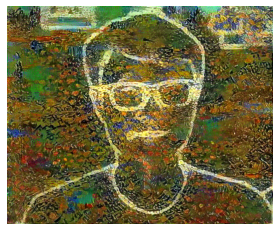

style_transfer     Step: 259ms    | Loss: 1.25e+07 | diff: 63.480%  | lr: 1.000e+00  | epoch: 1  ( 650/1000 )
content_loss 314.5829162597656 style_loss 12484279.0
style_transfer     Step: 245ms    | Loss: 1.24e+07 | diff: 63.525%  | lr: 1.000e+00  | epoch: 1  ( 660/1000 )
content_loss 314.609130859375 style_loss 12443169.0
style_transfer     Step: 246ms    | Loss: 1.24e+07 | diff: 63.570%  | lr: 1.000e+00  | epoch: 1  ( 670/1000 )
content_loss 314.60009765625 style_loss 12408166.0
style_transfer     Step: 245ms    | Loss: 1.24e+07 | diff: 63.621%  | lr: 1.000e+00  | epoch: 1  ( 680/1000 )
content_loss 314.61468505859375 style_loss 12368225.0
style_transfer     Step: 245ms    | Loss: 1.23e+07 | diff: 63.676%  | lr: 1.000e+00  | epoch: 1  ( 690/1000 )
content_loss 314.6000671386719 style_loss 12329715.0


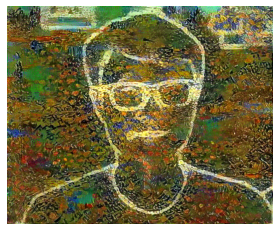

style_transfer     Step: 258ms    | Loss: 1.23e+07 | diff: 63.721%  | lr: 1.000e+00  | epoch: 1  ( 700/1000 )
content_loss 314.5727844238281 style_loss 12290532.0
style_transfer     Step: 245ms    | Loss: 1.23e+07 | diff: 63.771%  | lr: 1.000e+00  | epoch: 1  ( 710/1000 )
content_loss 314.5683288574219 style_loss 12252451.0
style_transfer     Step: 245ms    | Loss: 1.22e+07 | diff: 63.829%  | lr: 1.000e+00  | epoch: 1  ( 720/1000 )
content_loss 314.574951171875 style_loss 12210581.0
style_transfer     Step: 245ms    | Loss: 1.22e+07 | diff: 63.865%  | lr: 1.000e+00  | epoch: 1  ( 730/1000 )
content_loss 314.60980224609375 style_loss 12176673.0
style_transfer     Step: 246ms    | Loss: 1.21e+07 | diff: 63.919%  | lr: 1.000e+00  | epoch: 1  ( 740/1000 )
content_loss 314.6139831542969 style_loss 12139538.0


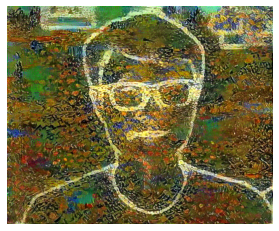

style_transfer     Step: 258ms    | Loss: 1.21e+07 | diff: 63.968%  | lr: 1.000e+00  | epoch: 1  ( 750/1000 )
content_loss 314.59893798828125 style_loss 12102345.0
style_transfer     Step: 246ms    | Loss: 1.21e+07 | diff: 64.005%  | lr: 1.000e+00  | epoch: 1  ( 760/1000 )
content_loss 314.6329650878906 style_loss 12069754.0
style_transfer     Step: 246ms    | Loss: 1.2e+07 | diff: 64.049%  | lr: 1.000e+00  | epoch: 1  ( 770/1000 )
content_loss 314.6576843261719 style_loss 12037668.0
style_transfer     Step: 245ms    | Loss: 1.2e+07 | diff: 64.098%  | lr: 1.000e+00  | epoch: 1  ( 780/1000 )
content_loss 314.6708679199219 style_loss 12003904.0
style_transfer     Step: 245ms    | Loss: 1.2e+07 | diff: 64.135%  | lr: 1.000e+00  | epoch: 1  ( 790/1000 )
content_loss 314.646484375 style_loss 11971112.0


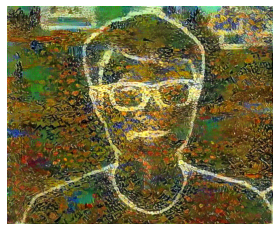

style_transfer     Step: 259ms    | Loss: 1.19e+07 | diff: 64.176%  | lr: 1.000e+00  | epoch: 1  ( 800/1000 )
content_loss 314.6895751953125 style_loss 11941131.0
style_transfer     Step: 245ms    | Loss: 1.19e+07 | diff: 64.222%  | lr: 1.000e+00  | epoch: 1  ( 810/1000 )
content_loss 314.7082214355469 style_loss 11907942.0
style_transfer     Step: 245ms    | Loss: 1.19e+07 | diff: 64.263%  | lr: 1.000e+00  | epoch: 1  ( 820/1000 )
content_loss 314.69921875 style_loss 11876757.0
style_transfer     Step: 247ms    | Loss: 1.18e+07 | diff: 64.312%  | lr: 1.000e+00  | epoch: 1  ( 830/1000 )
content_loss 314.67730712890625 style_loss 11842400.0
style_transfer     Step: 246ms    | Loss: 1.18e+07 | diff: 64.351%  | lr: 1.000e+00  | epoch: 1  ( 840/1000 )
content_loss 314.70849609375 style_loss 11809779.0


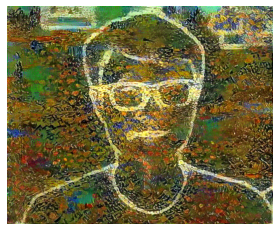

style_transfer     Step: 259ms    | Loss: 1.18e+07 | diff: 64.395%  | lr: 1.000e+00  | epoch: 1  ( 850/1000 )
content_loss 314.7031555175781 style_loss 11776589.0
style_transfer     Step: 245ms    | Loss: 1.17e+07 | diff: 64.437%  | lr: 1.000e+00  | epoch: 1  ( 860/1000 )
content_loss 314.7333679199219 style_loss 11746264.0
style_transfer     Step: 246ms    | Loss: 1.17e+07 | diff: 64.479%  | lr: 1.000e+00  | epoch: 1  ( 870/1000 )
content_loss 314.740478515625 style_loss 11716927.0
style_transfer     Step: 245ms    | Loss: 1.17e+07 | diff: 64.515%  | lr: 1.000e+00  | epoch: 1  ( 880/1000 )
content_loss 314.7790832519531 style_loss 11689360.0
style_transfer     Step: 246ms    | Loss: 1.17e+07 | diff: 64.559%  | lr: 1.000e+00  | epoch: 1  ( 890/1000 )
content_loss 314.7969970703125 style_loss 11659594.0


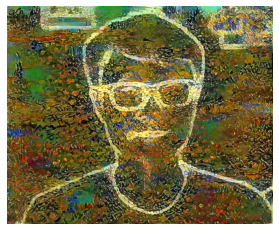

style_transfer     Step: 259ms    | Loss: 1.16e+07 | diff: 64.604%  | lr: 1.000e+00  | epoch: 1  ( 900/1000 )
content_loss 314.8047790527344 style_loss 11627817.0
style_transfer     Step: 245ms    | Loss: 1.16e+07 | diff: 64.639%  | lr: 1.000e+00  | epoch: 1  ( 910/1000 )
content_loss 314.8023681640625 style_loss 11600318.0
style_transfer     Step: 244ms    | Loss: 1.16e+07 | diff: 64.679%  | lr: 1.000e+00  | epoch: 1  ( 920/1000 )
content_loss 314.78875732421875 style_loss 11574671.0
style_transfer     Step: 247ms    | Loss: 1.15e+07 | diff: 64.713%  | lr: 1.000e+00  | epoch: 1  ( 930/1000 )
content_loss 314.80517578125 style_loss 11545377.0
style_transfer     Step: 245ms    | Loss: 1.15e+07 | diff: 64.757%  | lr: 1.000e+00  | epoch: 1  ( 940/1000 )
content_loss 314.8282775878906 style_loss 11518990.0


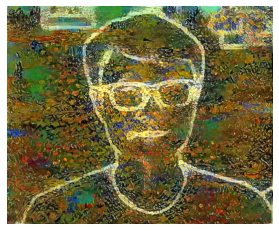

style_transfer     Step: 258ms    | Loss: 1.15e+07 | diff: 64.800%  | lr: 1.000e+00  | epoch: 1  ( 950/1000 )
content_loss 314.8551025390625 style_loss 11487854.0
style_transfer     Step: 245ms    | Loss: 1.15e+07 | diff: 64.836%  | lr: 1.000e+00  | epoch: 1  ( 960/1000 )
content_loss 314.8713073730469 style_loss 11462164.0
style_transfer     Step: 245ms    | Loss: 1.14e+07 | diff: 64.878%  | lr: 1.000e+00  | epoch: 1  ( 970/1000 )
content_loss 314.8894958496094 style_loss 11434917.0
style_transfer     Step: 245ms    | Loss: 1.14e+07 | diff: 64.913%  | lr: 1.000e+00  | epoch: 1  ( 980/1000 )
content_loss 314.90625 style_loss 11407812.0
style_transfer     Step: 245ms    | Loss: 1.14e+07 | diff: 64.947%  | lr: 1.000e+00  | epoch: 1  ( 990/1000 )
content_loss 314.9068603515625 style_loss 11384797.0


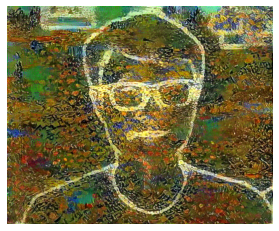

{ content_loss: 3.15e+02, style_loss: 1.14e+07, total_variation_norm_reg_Loss: 5.17, total_losses: 1.14e+07 }
content_loss 314.93267822265625 style_loss 11359194.0
style_transfer     Step: 458ms    | Loss: 1.13e+07 | diff: 65.024%  | lr: 1.000e+00  | epoch: 2  ( 10/1000 )
content_loss 314.9295349121094 style_loss 11332768.0
style_transfer     Step: 245ms    | Loss: 1.13e+07 | diff: 65.065%  | lr: 1.000e+00  | epoch: 2  ( 20/1000 )
content_loss 314.943115234375 style_loss 11307278.0
style_transfer     Step: 247ms    | Loss: 1.13e+07 | diff: 65.101%  | lr: 1.000e+00  | epoch: 2  ( 30/1000 )
content_loss 314.9363708496094 style_loss 11281056.0
style_transfer     Step: 246ms    | Loss: 1.13e+07 | diff: 65.134%  | lr: 1.000e+00  | epoch: 2  ( 40/1000 )
content_loss 314.9255065917969 style_loss 11255858.0


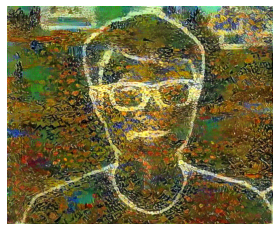

style_transfer     Step: 259ms    | Loss: 1.12e+07 | diff: 65.180%  | lr: 1.000e+00  | epoch: 2  ( 50/1000 )
content_loss 314.9343566894531 style_loss 11229704.0
style_transfer     Step: 246ms    | Loss: 1.12e+07 | diff: 65.216%  | lr: 1.000e+00  | epoch: 2  ( 60/1000 )
content_loss 314.9251708984375 style_loss 11204998.0
style_transfer     Step: 246ms    | Loss: 1.12e+07 | diff: 65.249%  | lr: 1.000e+00  | epoch: 2  ( 70/1000 )
content_loss 314.9151611328125 style_loss 11179238.0
style_transfer     Step: 246ms    | Loss: 1.12e+07 | diff: 65.295%  | lr: 1.000e+00  | epoch: 2  ( 80/1000 )
content_loss 314.9283447265625 style_loss 11153303.0
style_transfer     Step: 246ms    | Loss: 1.11e+07 | diff: 65.323%  | lr: 1.000e+00  | epoch: 2  ( 90/1000 )
content_loss 314.93048095703125 style_loss 11130831.0


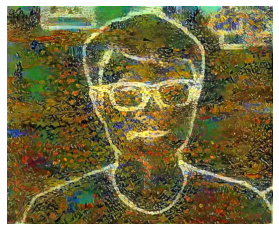

style_transfer     Step: 259ms    | Loss: 1.11e+07 | diff: 65.350%  | lr: 1.000e+00  | epoch: 2  ( 100/1000 )
content_loss 314.9559631347656 style_loss 11109204.0
style_transfer     Step: 244ms    | Loss: 1.11e+07 | diff: 65.392%  | lr: 1.000e+00  | epoch: 2  ( 110/1000 )
content_loss 314.9549560546875 style_loss 11083369.0
style_transfer     Step: 246ms    | Loss: 1.11e+07 | diff: 65.428%  | lr: 1.000e+00  | epoch: 2  ( 120/1000 )
content_loss 314.9808349609375 style_loss 11058302.0
style_transfer     Step: 246ms    | Loss: 1.1e+07 | diff: 65.463%  | lr: 1.000e+00  | epoch: 2  ( 130/1000 )
content_loss 314.98883056640625 style_loss 11035668.0
style_transfer     Step: 247ms    | Loss: 1.1e+07 | diff: 65.499%  | lr: 1.000e+00  | epoch: 2  ( 140/1000 )
content_loss 314.9737854003906 style_loss 11011009.0


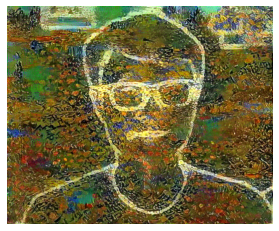

style_transfer     Step: 259ms    | Loss: 1.1e+07 | diff: 65.537%  | lr: 1.000e+00  | epoch: 2  ( 150/1000 )
content_loss 314.9841003417969 style_loss 10988415.0
style_transfer     Step: 246ms    | Loss: 1.1e+07 | diff: 65.574%  | lr: 1.000e+00  | epoch: 2  ( 160/1000 )
content_loss 314.99420166015625 style_loss 10965371.0
style_transfer     Step: 245ms    | Loss: 1.09e+07 | diff: 65.609%  | lr: 1.000e+00  | epoch: 2  ( 170/1000 )
content_loss 314.9812316894531 style_loss 10944006.0
style_transfer     Step: 246ms    | Loss: 1.09e+07 | diff: 65.634%  | lr: 1.000e+00  | epoch: 2  ( 180/1000 )
content_loss 315.00750732421875 style_loss 10924895.0
style_transfer     Step: 246ms    | Loss: 1.09e+07 | diff: 65.674%  | lr: 1.000e+00  | epoch: 2  ( 190/1000 )
content_loss 315.0329895019531 style_loss 10902253.0


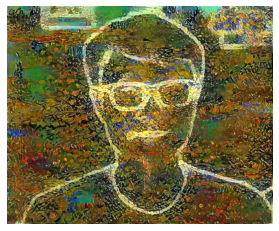

style_transfer     Step: 258ms    | Loss: 1.09e+07 | diff: 65.704%  | lr: 1.000e+00  | epoch: 2  ( 200/1000 )
content_loss 315.0193786621094 style_loss 10881530.0
style_transfer     Step: 246ms    | Loss: 1.09e+07 | diff: 65.739%  | lr: 1.000e+00  | epoch: 2  ( 210/1000 )
content_loss 315.017822265625 style_loss 10860103.0
style_transfer     Step: 246ms    | Loss: 1.08e+07 | diff: 65.770%  | lr: 1.000e+00  | epoch: 2  ( 220/1000 )
content_loss 315.02484130859375 style_loss 10840719.0
style_transfer     Step: 245ms    | Loss: 1.08e+07 | diff: 65.806%  | lr: 1.000e+00  | epoch: 2  ( 230/1000 )
content_loss 315.0252685546875 style_loss 10817748.0
style_transfer     Step: 246ms    | Loss: 1.08e+07 | diff: 65.841%  | lr: 1.000e+00  | epoch: 2  ( 240/1000 )
content_loss 315.05133056640625 style_loss 10797735.0


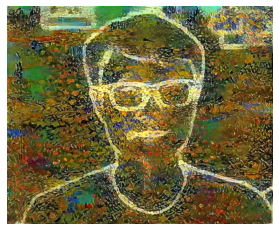

style_transfer     Step: 259ms    | Loss: 1.08e+07 | diff: 65.870%  | lr: 1.000e+00  | epoch: 2  ( 250/1000 )
content_loss 315.0299377441406 style_loss 10778001.0
style_transfer     Step: 246ms    | Loss: 1.08e+07 | diff: 65.909%  | lr: 1.000e+00  | epoch: 2  ( 260/1000 )
content_loss 315.0539855957031 style_loss 10757210.0
style_transfer     Step: 246ms    | Loss: 1.07e+07 | diff: 65.939%  | lr: 1.000e+00  | epoch: 2  ( 270/1000 )
content_loss 315.05419921875 style_loss 10736137.0
style_transfer     Step: 246ms    | Loss: 1.07e+07 | diff: 65.968%  | lr: 1.000e+00  | epoch: 2  ( 280/1000 )
content_loss 315.0718994140625 style_loss 10716271.0
style_transfer     Step: 246ms    | Loss: 1.07e+07 | diff: 66.015%  | lr: 1.000e+00  | epoch: 2  ( 290/1000 )
content_loss 315.09967041015625 style_loss 10695027.0


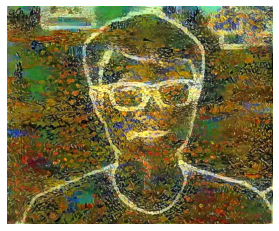

style_transfer     Step: 260ms    | Loss: 1.07e+07 | diff: 66.036%  | lr: 1.000e+00  | epoch: 2  ( 300/1000 )
content_loss 315.1186828613281 style_loss 10675930.0
style_transfer     Step: 245ms    | Loss: 1.07e+07 | diff: 66.070%  | lr: 1.000e+00  | epoch: 2  ( 310/1000 )
content_loss 315.1324768066406 style_loss 10657812.0
style_transfer     Step: 245ms    | Loss: 1.06e+07 | diff: 66.098%  | lr: 1.000e+00  | epoch: 2  ( 320/1000 )
content_loss 315.1254577636719 style_loss 10640436.0
style_transfer     Step: 245ms    | Loss: 1.06e+07 | diff: 66.128%  | lr: 1.000e+00  | epoch: 2  ( 330/1000 )
content_loss 315.131103515625 style_loss 10621685.0
style_transfer     Step: 246ms    | Loss: 1.06e+07 | diff: 66.158%  | lr: 1.000e+00  | epoch: 2  ( 340/1000 )
content_loss 315.13433837890625 style_loss 10602769.0


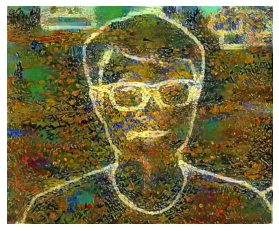

style_transfer     Step: 258ms    | Loss: 1.06e+07 | diff: 66.194%  | lr: 1.000e+00  | epoch: 2  ( 350/1000 )
content_loss 315.1458435058594 style_loss 10582576.0
style_transfer     Step: 246ms    | Loss: 1.06e+07 | diff: 66.220%  | lr: 1.000e+00  | epoch: 2  ( 360/1000 )
content_loss 315.1693115234375 style_loss 10563974.0
style_transfer     Step: 246ms    | Loss: 1.05e+07 | diff: 66.256%  | lr: 1.000e+00  | epoch: 2  ( 370/1000 )
content_loss 315.1826171875 style_loss 10545008.0
style_transfer     Step: 246ms    | Loss: 1.05e+07 | diff: 66.288%  | lr: 1.000e+00  | epoch: 2  ( 380/1000 )
content_loss 315.1983337402344 style_loss 10527434.0
style_transfer     Step: 246ms    | Loss: 1.05e+07 | diff: 66.316%  | lr: 1.000e+00  | epoch: 2  ( 390/1000 )
content_loss 315.1861267089844 style_loss 10509857.0


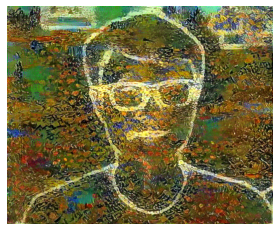

style_transfer     Step: 268ms    | Loss: 1.05e+07 | diff: 66.347%  | lr: 1.000e+00  | epoch: 2  ( 400/1000 )
content_loss 315.1971435546875 style_loss 10490694.0
style_transfer     Step: 245ms    | Loss: 1.05e+07 | diff: 66.377%  | lr: 1.000e+00  | epoch: 2  ( 410/1000 )
content_loss 315.20684814453125 style_loss 10473157.0
style_transfer     Step: 247ms    | Loss: 1.05e+07 | diff: 66.403%  | lr: 1.000e+00  | epoch: 2  ( 420/1000 )
content_loss 315.2140197753906 style_loss 10457929.0
style_transfer     Step: 244ms    | Loss: 1.04e+07 | diff: 66.429%  | lr: 1.000e+00  | epoch: 2  ( 430/1000 )
content_loss 315.224853515625 style_loss 10442708.0
style_transfer     Step: 246ms    | Loss: 1.04e+07 | diff: 66.459%  | lr: 1.000e+00  | epoch: 2  ( 440/1000 )
content_loss 315.257080078125 style_loss 10424678.0


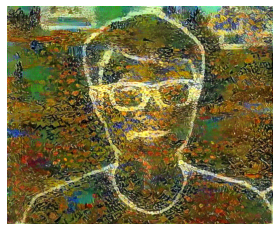

style_transfer     Step: 258ms    | Loss: 1.04e+07 | diff: 66.492%  | lr: 1.000e+00  | epoch: 2  ( 450/1000 )
content_loss 315.28033447265625 style_loss 10405495.0
style_transfer     Step: 246ms    | Loss: 1.04e+07 | diff: 66.519%  | lr: 1.000e+00  | epoch: 2  ( 460/1000 )
content_loss 315.2763671875 style_loss 10386918.0
style_transfer     Step: 246ms    | Loss: 1.04e+07 | diff: 66.546%  | lr: 1.000e+00  | epoch: 2  ( 470/1000 )
content_loss 315.30419921875 style_loss 10370580.0
style_transfer     Step: 246ms    | Loss: 1.04e+07 | diff: 66.580%  | lr: 1.000e+00  | epoch: 2  ( 480/1000 )
content_loss 315.3173522949219 style_loss 10352987.0
style_transfer     Step: 245ms    | Loss: 1.03e+07 | diff: 66.607%  | lr: 1.000e+00  | epoch: 2  ( 490/1000 )
content_loss 315.3253479003906 style_loss 10335413.0


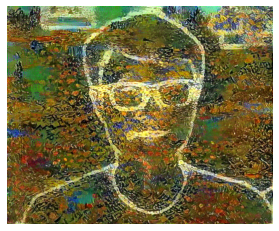

style_transfer     Step: 259ms    | Loss: 1.03e+07 | diff: 66.633%  | lr: 1.000e+00  | epoch: 2  ( 500/1000 )
content_loss 315.358154296875 style_loss 10319383.0
style_transfer     Step: 245ms    | Loss: 1.03e+07 | diff: 66.663%  | lr: 1.000e+00  | epoch: 2  ( 510/1000 )
content_loss 315.3612976074219 style_loss 10302243.0
style_transfer     Step: 245ms    | Loss: 1.03e+07 | diff: 66.697%  | lr: 1.000e+00  | epoch: 2  ( 520/1000 )
content_loss 315.38287353515625 style_loss 10286686.0
style_transfer     Step: 245ms    | Loss: 1.03e+07 | diff: 66.720%  | lr: 1.000e+00  | epoch: 2  ( 530/1000 )
content_loss 315.395751953125 style_loss 10271385.0
style_transfer     Step: 246ms    | Loss: 1.03e+07 | diff: 66.741%  | lr: 1.000e+00  | epoch: 2  ( 540/1000 )
content_loss 315.4071350097656 style_loss 10256779.0


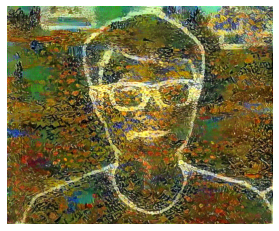

style_transfer     Step: 259ms    | Loss: 1.02e+07 | diff: 66.767%  | lr: 1.000e+00  | epoch: 2  ( 550/1000 )
content_loss 315.40625 style_loss 10242772.0
style_transfer     Step: 246ms    | Loss: 1.02e+07 | diff: 66.793%  | lr: 1.000e+00  | epoch: 2  ( 560/1000 )
content_loss 315.4010009765625 style_loss 10225978.0
style_transfer     Step: 245ms    | Loss: 1.02e+07 | diff: 66.828%  | lr: 1.000e+00  | epoch: 2  ( 570/1000 )
content_loss 315.42352294921875 style_loss 10208813.0
style_transfer     Step: 246ms    | Loss: 1.02e+07 | diff: 66.851%  | lr: 1.000e+00  | epoch: 2  ( 580/1000 )
content_loss 315.42840576171875 style_loss 10194056.0
style_transfer     Step: 245ms    | Loss: 1.02e+07 | diff: 66.878%  | lr: 1.000e+00  | epoch: 2  ( 590/1000 )
content_loss 315.43621826171875 style_loss 10177863.0


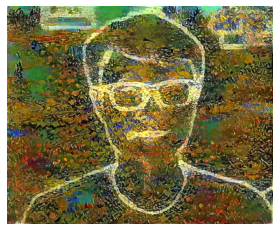

style_transfer     Step: 260ms    | Loss: 1.02e+07 | diff: 66.908%  | lr: 1.000e+00  | epoch: 2  ( 600/1000 )
content_loss 315.4501037597656 style_loss 10160517.0
style_transfer     Step: 244ms    | Loss: 1.01e+07 | diff: 66.936%  | lr: 1.000e+00  | epoch: 2  ( 610/1000 )
content_loss 315.4479064941406 style_loss 10143598.0
style_transfer     Step: 245ms    | Loss: 1.01e+07 | diff: 66.963%  | lr: 1.000e+00  | epoch: 2  ( 620/1000 )
content_loss 315.44708251953125 style_loss 10127322.0
style_transfer     Step: 246ms    | Loss: 1.01e+07 | diff: 66.990%  | lr: 1.000e+00  | epoch: 2  ( 630/1000 )
content_loss 315.4534912109375 style_loss 10112891.0
style_transfer     Step: 246ms    | Loss: 1.01e+07 | diff: 67.011%  | lr: 1.000e+00  | epoch: 2  ( 640/1000 )
content_loss 315.4650573730469 style_loss 10099127.0


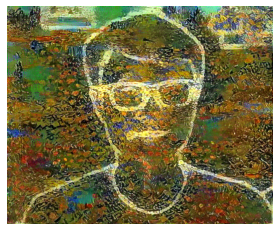

style_transfer     Step: 260ms    | Loss: 1.01e+07 | diff: 67.036%  | lr: 1.000e+00  | epoch: 2  ( 650/1000 )
content_loss 315.46221923828125 style_loss 10083622.0
style_transfer     Step: 246ms    | Loss: 1.01e+07 | diff: 67.064%  | lr: 1.000e+00  | epoch: 2  ( 660/1000 )
content_loss 315.4577331542969 style_loss 10070375.0
style_transfer     Step: 246ms    | Loss: 1.01e+07 | diff: 67.091%  | lr: 1.000e+00  | epoch: 2  ( 670/1000 )
content_loss 315.4506530761719 style_loss 10053930.0
style_transfer     Step: 246ms    | Loss: 1e+07 | diff: 67.115%  | lr: 1.000e+00  | epoch: 2  ( 680/1000 )
content_loss 315.44476318359375 style_loss 10039590.0
style_transfer     Step: 246ms    | Loss: 1e+07 | diff: 67.140%  | lr: 1.000e+00  | epoch: 2  ( 690/1000 )
content_loss 315.4497375488281 style_loss 10023576.0


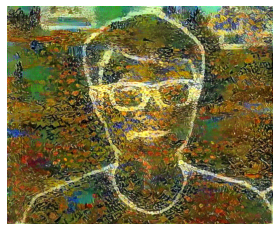

style_transfer     Step: 259ms    | Loss: 1e+07 | diff: 67.168%  | lr: 1.000e+00  | epoch: 2  ( 700/1000 )
content_loss 315.4619140625 style_loss 10008573.0
style_transfer     Step: 245ms    | Loss: 9.99e+06 | diff: 67.200%  | lr: 1.000e+00  | epoch: 2  ( 710/1000 )
content_loss 315.4656982421875 style_loss 9991490.0
style_transfer     Step: 246ms    | Loss: 9.98e+06 | diff: 67.223%  | lr: 1.000e+00  | epoch: 2  ( 720/1000 )
content_loss 315.46820068359375 style_loss 9977634.0
style_transfer     Step: 245ms    | Loss: 9.96e+06 | diff: 67.245%  | lr: 1.000e+00  | epoch: 2  ( 730/1000 )
content_loss 315.4595031738281 style_loss 9962858.0
style_transfer     Step: 245ms    | Loss: 9.95e+06 | diff: 67.270%  | lr: 1.000e+00  | epoch: 2  ( 740/1000 )
content_loss 315.4561767578125 style_loss 9949749.0


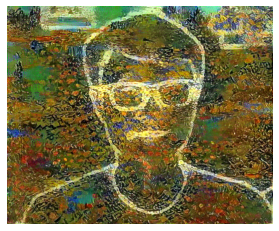

style_transfer     Step: 259ms    | Loss: 9.94e+06 | diff: 67.292%  | lr: 1.000e+00  | epoch: 2  ( 750/1000 )
content_loss 315.4684143066406 style_loss 9937051.0
style_transfer     Step: 246ms    | Loss: 9.92e+06 | diff: 67.314%  | lr: 1.000e+00  | epoch: 2  ( 760/1000 )
content_loss 315.47509765625 style_loss 9924092.0
style_transfer     Step: 245ms    | Loss: 9.91e+06 | diff: 67.341%  | lr: 1.000e+00  | epoch: 2  ( 770/1000 )
content_loss 315.481201171875 style_loss 9910446.0
style_transfer     Step: 246ms    | Loss: 9.9e+06 | diff: 67.365%  | lr: 1.000e+00  | epoch: 2  ( 780/1000 )
content_loss 315.4867858886719 style_loss 9896801.0
style_transfer     Step: 245ms    | Loss: 9.89e+06 | diff: 67.386%  | lr: 1.000e+00  | epoch: 2  ( 790/1000 )
content_loss 315.4886169433594 style_loss 9885463.0


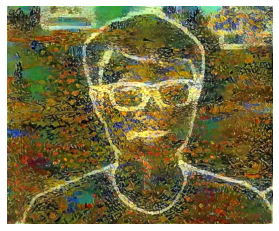

style_transfer     Step: 259ms    | Loss: 9.87e+06 | diff: 67.410%  | lr: 1.000e+00  | epoch: 2  ( 800/1000 )
content_loss 315.4873352050781 style_loss 9871288.0
style_transfer     Step: 245ms    | Loss: 9.86e+06 | diff: 67.435%  | lr: 1.000e+00  | epoch: 2  ( 810/1000 )
content_loss 315.4976806640625 style_loss 9856705.0
style_transfer     Step: 245ms    | Loss: 9.84e+06 | diff: 67.460%  | lr: 1.000e+00  | epoch: 2  ( 820/1000 )
content_loss 315.5267639160156 style_loss 9843375.0
style_transfer     Step: 246ms    | Loss: 9.83e+06 | diff: 67.481%  | lr: 1.000e+00  | epoch: 2  ( 830/1000 )
content_loss 315.5296630859375 style_loss 9830992.0
style_transfer     Step: 245ms    | Loss: 9.82e+06 | diff: 67.500%  | lr: 1.000e+00  | epoch: 2  ( 840/1000 )
content_loss 315.5484619140625 style_loss 9819521.0


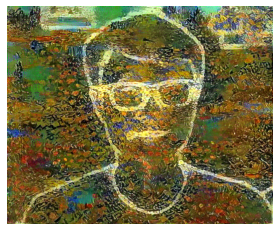

style_transfer     Step: 259ms    | Loss: 9.81e+06 | diff: 67.521%  | lr: 1.000e+00  | epoch: 2  ( 850/1000 )
content_loss 315.550537109375 style_loss 9808346.0
style_transfer     Step: 246ms    | Loss: 9.8e+06 | diff: 67.547%  | lr: 1.000e+00  | epoch: 2  ( 860/1000 )
content_loss 315.5549011230469 style_loss 9796492.0
style_transfer     Step: 245ms    | Loss: 9.79e+06 | diff: 67.567%  | lr: 1.000e+00  | epoch: 2  ( 870/1000 )
content_loss 315.5722351074219 style_loss 9785872.0
style_transfer     Step: 245ms    | Loss: 9.77e+06 | diff: 67.588%  | lr: 1.000e+00  | epoch: 2  ( 880/1000 )
content_loss 315.57867431640625 style_loss 9772592.0
style_transfer     Step: 246ms    | Loss: 9.76e+06 | diff: 67.610%  | lr: 1.000e+00  | epoch: 2  ( 890/1000 )
content_loss 315.5826416015625 style_loss 9760710.0


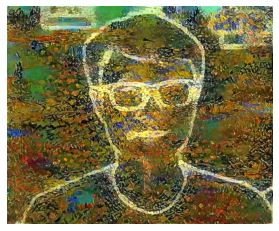

style_transfer     Step: 260ms    | Loss: 9.75e+06 | diff: 67.630%  | lr: 1.000e+00  | epoch: 2  ( 900/1000 )
content_loss 315.5845031738281 style_loss 9749133.0
style_transfer     Step: 246ms    | Loss: 9.74e+06 | diff: 67.652%  | lr: 1.000e+00  | epoch: 2  ( 910/1000 )
content_loss 315.5931396484375 style_loss 9736298.0
style_transfer     Step: 245ms    | Loss: 9.72e+06 | diff: 67.680%  | lr: 1.000e+00  | epoch: 2  ( 920/1000 )
content_loss 315.60357666015625 style_loss 9723979.0
style_transfer     Step: 246ms    | Loss: 9.71e+06 | diff: 67.700%  | lr: 1.000e+00  | epoch: 2  ( 930/1000 )
content_loss 315.6202087402344 style_loss 9711160.0
style_transfer     Step: 246ms    | Loss: 9.7e+06 | diff: 67.718%  | lr: 1.000e+00  | epoch: 2  ( 940/1000 )
content_loss 315.62005615234375 style_loss 9699893.0


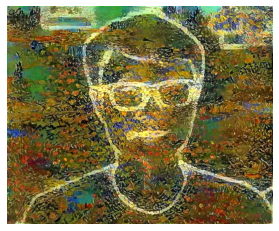

style_transfer     Step: 259ms    | Loss: 9.69e+06 | diff: 67.738%  | lr: 1.000e+00  | epoch: 2  ( 950/1000 )
content_loss 315.62701416015625 style_loss 9689900.0
style_transfer     Step: 246ms    | Loss: 9.68e+06 | diff: 67.759%  | lr: 1.000e+00  | epoch: 2  ( 960/1000 )
content_loss 315.6170349121094 style_loss 9679367.0
style_transfer     Step: 246ms    | Loss: 9.67e+06 | diff: 67.777%  | lr: 1.000e+00  | epoch: 2  ( 970/1000 )
content_loss 315.6259460449219 style_loss 9668875.0
style_transfer     Step: 246ms    | Loss: 9.66e+06 | diff: 67.796%  | lr: 1.000e+00  | epoch: 2  ( 980/1000 )
content_loss 315.632080078125 style_loss 9657285.0
style_transfer     Step: 246ms    | Loss: 9.65e+06 | diff: 67.817%  | lr: 1.000e+00  | epoch: 2  ( 990/1000 )
content_loss 315.63079833984375 style_loss 9646043.0


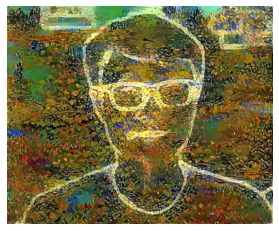

{ content_loss: 3.16e+02, style_loss: 9.64e+06, total_variation_norm_reg_Loss: 5.28, total_losses: 9.64e+06 }
content_loss 315.6332702636719 style_loss 9635903.0
style_transfer     Step: 460ms    | Loss: 9.62e+06 | diff: 67.859%  | lr: 1.000e+00  | epoch: 3  ( 10/1000 )
content_loss 315.63818359375 style_loss 9623577.0
style_transfer     Step: 246ms    | Loss: 9.61e+06 | diff: 67.887%  | lr: 1.000e+00  | epoch: 3  ( 20/1000 )
content_loss 315.63031005859375 style_loss 9611319.0
style_transfer     Step: 246ms    | Loss: 9.6e+06 | diff: 67.902%  | lr: 1.000e+00  | epoch: 3  ( 30/1000 )
content_loss 315.6314392089844 style_loss 9600125.0
style_transfer     Step: 246ms    | Loss: 9.59e+06 | diff: 67.925%  | lr: 1.000e+00  | epoch: 3  ( 40/1000 )
content_loss 315.642578125 style_loss 9587896.0


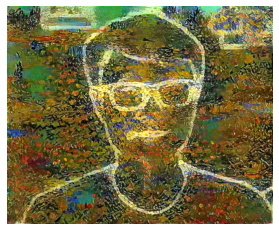

style_transfer     Step: 260ms    | Loss: 9.58e+06 | diff: 67.943%  | lr: 1.000e+00  | epoch: 3  ( 50/1000 )
content_loss 315.63409423828125 style_loss 9578144.0
style_transfer     Step: 246ms    | Loss: 9.57e+06 | diff: 67.965%  | lr: 1.000e+00  | epoch: 3  ( 60/1000 )
content_loss 315.6317443847656 style_loss 9567568.0
style_transfer     Step: 246ms    | Loss: 9.56e+06 | diff: 67.985%  | lr: 1.000e+00  | epoch: 3  ( 70/1000 )
content_loss 315.63848876953125 style_loss 9555672.0
style_transfer     Step: 247ms    | Loss: 9.55e+06 | diff: 68.003%  | lr: 1.000e+00  | epoch: 3  ( 80/1000 )
content_loss 315.64508056640625 style_loss 9546179.0
style_transfer     Step: 247ms    | Loss: 9.54e+06 | diff: 68.022%  | lr: 1.000e+00  | epoch: 3  ( 90/1000 )
content_loss 315.64837646484375 style_loss 9534701.0


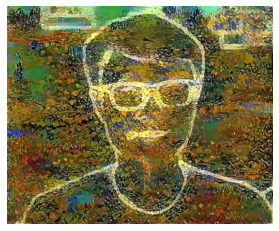

style_transfer     Step: 259ms    | Loss: 9.52e+06 | diff: 68.041%  | lr: 1.000e+00  | epoch: 3  ( 100/1000 )
content_loss 315.6572265625 style_loss 9523507.0
style_transfer     Step: 246ms    | Loss: 9.51e+06 | diff: 68.065%  | lr: 1.000e+00  | epoch: 3  ( 110/1000 )
content_loss 315.666259765625 style_loss 9512993.0
style_transfer     Step: 246ms    | Loss: 9.5e+06 | diff: 68.083%  | lr: 1.000e+00  | epoch: 3  ( 120/1000 )
content_loss 315.67236328125 style_loss 9502557.0
style_transfer     Step: 246ms    | Loss: 9.49e+06 | diff: 68.103%  | lr: 1.000e+00  | epoch: 3  ( 130/1000 )
content_loss 315.6720275878906 style_loss 9491519.0
style_transfer     Step: 245ms    | Loss: 9.48e+06 | diff: 68.123%  | lr: 1.000e+00  | epoch: 3  ( 140/1000 )
content_loss 315.6945495605469 style_loss 9481250.0


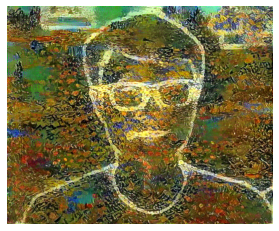

style_transfer     Step: 260ms    | Loss: 9.47e+06 | diff: 68.142%  | lr: 1.000e+00  | epoch: 3  ( 150/1000 )
content_loss 315.6822204589844 style_loss 9470276.0
style_transfer     Step: 245ms    | Loss: 9.46e+06 | diff: 68.159%  | lr: 1.000e+00  | epoch: 3  ( 160/1000 )
content_loss 315.6990661621094 style_loss 9460893.0
style_transfer     Step: 246ms    | Loss: 9.45e+06 | diff: 68.180%  | lr: 1.000e+00  | epoch: 3  ( 170/1000 )
content_loss 315.70947265625 style_loss 9449629.0
style_transfer     Step: 246ms    | Loss: 9.44e+06 | diff: 68.199%  | lr: 1.000e+00  | epoch: 3  ( 180/1000 )
content_loss 315.7167053222656 style_loss 9440128.0
style_transfer     Step: 246ms    | Loss: 9.43e+06 | diff: 68.217%  | lr: 1.000e+00  | epoch: 3  ( 190/1000 )
content_loss 315.7051696777344 style_loss 9429937.0


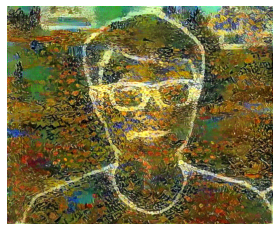

style_transfer     Step: 259ms    | Loss: 9.42e+06 | diff: 68.240%  | lr: 1.000e+00  | epoch: 3  ( 200/1000 )
content_loss 315.7024841308594 style_loss 9419653.0
style_transfer     Step: 246ms    | Loss: 9.41e+06 | diff: 68.255%  | lr: 1.000e+00  | epoch: 3  ( 210/1000 )
content_loss 315.70306396484375 style_loss 9410386.0
style_transfer     Step: 245ms    | Loss: 9.4e+06 | diff: 68.272%  | lr: 1.000e+00  | epoch: 3  ( 220/1000 )
content_loss 315.71490478515625 style_loss 9400653.0
style_transfer     Step: 245ms    | Loss: 9.39e+06 | diff: 68.292%  | lr: 1.000e+00  | epoch: 3  ( 230/1000 )
content_loss 315.72021484375 style_loss 9389635.0
style_transfer     Step: 245ms    | Loss: 9.38e+06 | diff: 68.312%  | lr: 1.000e+00  | epoch: 3  ( 240/1000 )
content_loss 315.7123718261719 style_loss 9378917.0


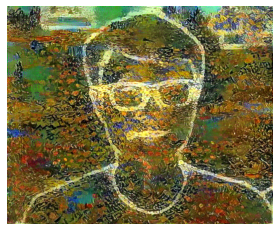

style_transfer     Step: 260ms    | Loss: 9.37e+06 | diff: 68.330%  | lr: 1.000e+00  | epoch: 3  ( 250/1000 )
content_loss 315.7070007324219 style_loss 9369268.0
style_transfer     Step: 246ms    | Loss: 9.36e+06 | diff: 68.350%  | lr: 1.000e+00  | epoch: 3  ( 260/1000 )
content_loss 315.7215270996094 style_loss 9359743.0
style_transfer     Step: 246ms    | Loss: 9.35e+06 | diff: 68.364%  | lr: 1.000e+00  | epoch: 3  ( 270/1000 )
content_loss 315.7165222167969 style_loss 9351499.0
style_transfer     Step: 245ms    | Loss: 9.34e+06 | diff: 68.384%  | lr: 1.000e+00  | epoch: 3  ( 280/1000 )
content_loss 315.7215576171875 style_loss 9341894.0
style_transfer     Step: 246ms    | Loss: 9.33e+06 | diff: 68.401%  | lr: 1.000e+00  | epoch: 3  ( 290/1000 )
content_loss 315.70562744140625 style_loss 9332303.0


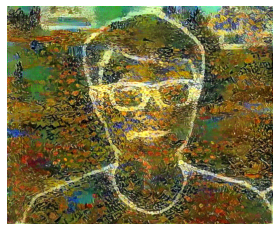

style_transfer     Step: 260ms    | Loss: 9.32e+06 | diff: 68.417%  | lr: 1.000e+00  | epoch: 3  ( 300/1000 )
content_loss 315.70416259765625 style_loss 9322658.0
style_transfer     Step: 247ms    | Loss: 9.31e+06 | diff: 68.434%  | lr: 1.000e+00  | epoch: 3  ( 310/1000 )
content_loss 315.7149353027344 style_loss 9314298.0
style_transfer     Step: 246ms    | Loss: 9.31e+06 | diff: 68.453%  | lr: 1.000e+00  | epoch: 3  ( 320/1000 )
content_loss 315.71551513671875 style_loss 9304742.0
style_transfer     Step: 256ms    | Loss: 9.29e+06 | diff: 68.471%  | lr: 1.000e+00  | epoch: 3  ( 330/1000 )
content_loss 315.7158508300781 style_loss 9294646.0
style_transfer     Step: 246ms    | Loss: 9.28e+06 | diff: 68.494%  | lr: 1.000e+00  | epoch: 3  ( 340/1000 )
content_loss 315.72393798828125 style_loss 9284388.0


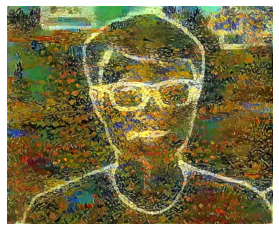

style_transfer     Step: 259ms    | Loss: 9.28e+06 | diff: 68.506%  | lr: 1.000e+00  | epoch: 3  ( 350/1000 )
content_loss 315.72308349609375 style_loss 9275618.0
style_transfer     Step: 246ms    | Loss: 9.27e+06 | diff: 68.526%  | lr: 1.000e+00  | epoch: 3  ( 360/1000 )
content_loss 315.7174987792969 style_loss 9265957.0
style_transfer     Step: 245ms    | Loss: 9.26e+06 | diff: 68.543%  | lr: 1.000e+00  | epoch: 3  ( 370/1000 )
content_loss 315.7217102050781 style_loss 9257876.0
style_transfer     Step: 246ms    | Loss: 9.25e+06 | diff: 68.559%  | lr: 1.000e+00  | epoch: 3  ( 380/1000 )
content_loss 315.72100830078125 style_loss 9248529.0
style_transfer     Step: 246ms    | Loss: 9.24e+06 | diff: 68.575%  | lr: 1.000e+00  | epoch: 3  ( 390/1000 )
content_loss 315.73345947265625 style_loss 9239864.0


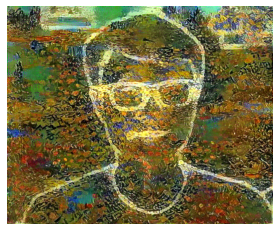

style_transfer     Step: 259ms    | Loss: 9.23e+06 | diff: 68.593%  | lr: 1.000e+00  | epoch: 3  ( 400/1000 )
content_loss 315.7374267578125 style_loss 9229958.0
style_transfer     Step: 246ms    | Loss: 9.22e+06 | diff: 68.610%  | lr: 1.000e+00  | epoch: 3  ( 410/1000 )
content_loss 315.739013671875 style_loss 9221746.0
style_transfer     Step: 245ms    | Loss: 9.21e+06 | diff: 68.626%  | lr: 1.000e+00  | epoch: 3  ( 420/1000 )
content_loss 315.7305603027344 style_loss 9213059.0
style_transfer     Step: 246ms    | Loss: 9.2e+06 | diff: 68.643%  | lr: 1.000e+00  | epoch: 3  ( 430/1000 )
content_loss 315.7306213378906 style_loss 9204075.0
style_transfer     Step: 246ms    | Loss: 9.2e+06 | diff: 68.660%  | lr: 1.000e+00  | epoch: 3  ( 440/1000 )
content_loss 315.7451171875 style_loss 9195306.0


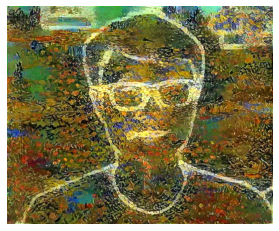

style_transfer     Step: 259ms    | Loss: 9.19e+06 | diff: 68.680%  | lr: 1.000e+00  | epoch: 3  ( 450/1000 )
content_loss 315.73199462890625 style_loss 9186034.0
style_transfer     Step: 246ms    | Loss: 9.18e+06 | diff: 68.695%  | lr: 1.000e+00  | epoch: 3  ( 460/1000 )
content_loss 315.734375 style_loss 9177206.0
style_transfer     Step: 247ms    | Loss: 9.17e+06 | diff: 68.708%  | lr: 1.000e+00  | epoch: 3  ( 470/1000 )
content_loss 315.7245178222656 style_loss 9168688.0
style_transfer     Step: 246ms    | Loss: 9.16e+06 | diff: 68.723%  | lr: 1.000e+00  | epoch: 3  ( 480/1000 )
content_loss 315.7205810546875 style_loss 9161396.0
style_transfer     Step: 246ms    | Loss: 9.15e+06 | diff: 68.739%  | lr: 1.000e+00  | epoch: 3  ( 490/1000 )
content_loss 315.72686767578125 style_loss 9153541.0


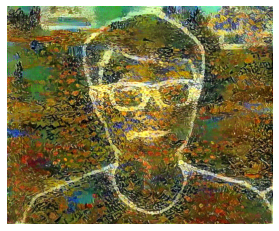

style_transfer     Step: 259ms    | Loss: 9.14e+06 | diff: 68.759%  | lr: 1.000e+00  | epoch: 3  ( 500/1000 )
content_loss 315.7337646484375 style_loss 9144374.0
style_transfer     Step: 246ms    | Loss: 9.14e+06 | diff: 68.773%  | lr: 1.000e+00  | epoch: 3  ( 510/1000 )
content_loss 315.74237060546875 style_loss 9136816.0
style_transfer     Step: 245ms    | Loss: 9.13e+06 | diff: 68.789%  | lr: 1.000e+00  | epoch: 3  ( 520/1000 )
content_loss 315.7463073730469 style_loss 9128864.0
style_transfer     Step: 246ms    | Loss: 9.12e+06 | diff: 68.805%  | lr: 1.000e+00  | epoch: 3  ( 530/1000 )
content_loss 315.7542419433594 style_loss 9119711.0
style_transfer     Step: 246ms    | Loss: 9.11e+06 | diff: 68.823%  | lr: 1.000e+00  | epoch: 3  ( 540/1000 )
content_loss 315.76611328125 style_loss 9111371.0


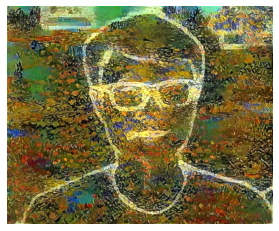

style_transfer     Step: 259ms    | Loss: 9.1e+06 | diff: 68.838%  | lr: 1.000e+00  | epoch: 3  ( 550/1000 )
content_loss 315.7755126953125 style_loss 9102685.0
style_transfer     Step: 246ms    | Loss: 9.09e+06 | diff: 68.856%  | lr: 1.000e+00  | epoch: 3  ( 560/1000 )
content_loss 315.77313232421875 style_loss 9094056.0
style_transfer     Step: 246ms    | Loss: 9.09e+06 | diff: 68.870%  | lr: 1.000e+00  | epoch: 3  ( 570/1000 )
content_loss 315.79296875 style_loss 9086332.0
style_transfer     Step: 246ms    | Loss: 9.08e+06 | diff: 68.887%  | lr: 1.000e+00  | epoch: 3  ( 580/1000 )
content_loss 315.7899475097656 style_loss 9078296.0
style_transfer     Step: 247ms    | Loss: 9.07e+06 | diff: 68.902%  | lr: 1.000e+00  | epoch: 3  ( 590/1000 )
content_loss 315.7890625 style_loss 9071081.0


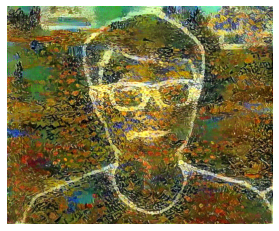

style_transfer     Step: 269ms    | Loss: 9.06e+06 | diff: 68.912%  | lr: 1.000e+00  | epoch: 3  ( 600/1000 )
content_loss 315.7866516113281 style_loss 9063863.0
style_transfer     Step: 246ms    | Loss: 9.06e+06 | diff: 68.926%  | lr: 1.000e+00  | epoch: 3  ( 610/1000 )
content_loss 315.7922668457031 style_loss 9056417.0
style_transfer     Step: 245ms    | Loss: 9.05e+06 | diff: 68.942%  | lr: 1.000e+00  | epoch: 3  ( 620/1000 )
content_loss 315.7946472167969 style_loss 9049536.0
style_transfer     Step: 245ms    | Loss: 9.04e+06 | diff: 68.956%  | lr: 1.000e+00  | epoch: 3  ( 630/1000 )
content_loss 315.7868347167969 style_loss 9041794.0
style_transfer     Step: 245ms    | Loss: 9.03e+06 | diff: 68.971%  | lr: 1.000e+00  | epoch: 3  ( 640/1000 )
content_loss 315.7761535644531 style_loss 9034598.0


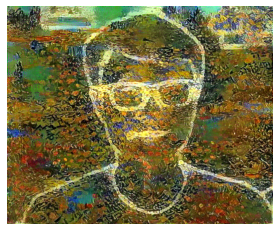

style_transfer     Step: 260ms    | Loss: 9.03e+06 | diff: 68.985%  | lr: 1.000e+00  | epoch: 3  ( 650/1000 )
content_loss 315.7684631347656 style_loss 9027278.0
style_transfer     Step: 247ms    | Loss: 9.02e+06 | diff: 69.000%  | lr: 1.000e+00  | epoch: 3  ( 660/1000 )
content_loss 315.7782287597656 style_loss 9019115.0
style_transfer     Step: 246ms    | Loss: 9.01e+06 | diff: 69.016%  | lr: 1.000e+00  | epoch: 3  ( 670/1000 )
content_loss 315.7966613769531 style_loss 9012094.0
style_transfer     Step: 246ms    | Loss: 9.01e+06 | diff: 69.027%  | lr: 1.000e+00  | epoch: 3  ( 680/1000 )
content_loss 315.7993469238281 style_loss 9005454.0
style_transfer     Step: 247ms    | Loss: 9e+06 | diff: 69.041%  | lr: 1.000e+00  | epoch: 3  ( 690/1000 )
content_loss 315.7980651855469 style_loss 8998094.0


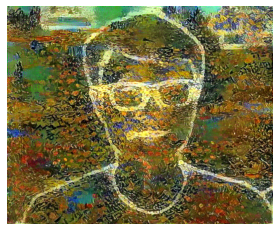

style_transfer     Step: 260ms    | Loss: 8.99e+06 | diff: 69.055%  | lr: 1.000e+00  | epoch: 3  ( 700/1000 )
content_loss 315.792236328125 style_loss 8990760.0
style_transfer     Step: 246ms    | Loss: 8.98e+06 | diff: 69.071%  | lr: 1.000e+00  | epoch: 3  ( 710/1000 )
content_loss 315.79290771484375 style_loss 8983533.0
style_transfer     Step: 246ms    | Loss: 8.98e+06 | diff: 69.084%  | lr: 1.000e+00  | epoch: 3  ( 720/1000 )
content_loss 315.7923583984375 style_loss 8976103.0
style_transfer     Step: 246ms    | Loss: 8.97e+06 | diff: 69.099%  | lr: 1.000e+00  | epoch: 3  ( 730/1000 )
content_loss 315.791015625 style_loss 8969366.0
style_transfer     Step: 247ms    | Loss: 8.96e+06 | diff: 69.112%  | lr: 1.000e+00  | epoch: 3  ( 740/1000 )
content_loss 315.7928771972656 style_loss 8961508.0


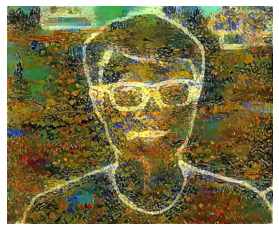

style_transfer     Step: 262ms    | Loss: 8.95e+06 | diff: 69.129%  | lr: 1.000e+00  | epoch: 3  ( 750/1000 )
content_loss 315.791259765625 style_loss 8953701.0
style_transfer     Step: 247ms    | Loss: 8.95e+06 | diff: 69.143%  | lr: 1.000e+00  | epoch: 3  ( 760/1000 )
content_loss 315.8096618652344 style_loss 8946530.0
style_transfer     Step: 248ms    | Loss: 8.94e+06 | diff: 69.156%  | lr: 1.000e+00  | epoch: 3  ( 770/1000 )
content_loss 315.8073425292969 style_loss 8939337.0
style_transfer     Step: 247ms    | Loss: 8.93e+06 | diff: 69.168%  | lr: 1.000e+00  | epoch: 3  ( 780/1000 )
content_loss 315.8143005371094 style_loss 8933550.0
style_transfer     Step: 246ms    | Loss: 8.93e+06 | diff: 69.185%  | lr: 1.000e+00  | epoch: 3  ( 790/1000 )
content_loss 315.79705810546875 style_loss 8925134.0


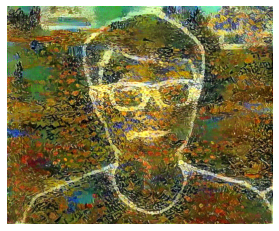

style_transfer     Step: 259ms    | Loss: 8.92e+06 | diff: 69.198%  | lr: 1.000e+00  | epoch: 3  ( 800/1000 )
content_loss 315.79534912109375 style_loss 8919013.0
style_transfer     Step: 248ms    | Loss: 8.91e+06 | diff: 69.211%  | lr: 1.000e+00  | epoch: 3  ( 810/1000 )
content_loss 315.80548095703125 style_loss 8912357.0
style_transfer     Step: 246ms    | Loss: 8.91e+06 | diff: 69.224%  | lr: 1.000e+00  | epoch: 3  ( 820/1000 )
content_loss 315.80230712890625 style_loss 8904802.0
style_transfer     Step: 246ms    | Loss: 8.9e+06 | diff: 69.238%  | lr: 1.000e+00  | epoch: 3  ( 830/1000 )
content_loss 315.79736328125 style_loss 8897764.0
style_transfer     Step: 247ms    | Loss: 8.89e+06 | diff: 69.252%  | lr: 1.000e+00  | epoch: 3  ( 840/1000 )
content_loss 315.80804443359375 style_loss 8891756.0


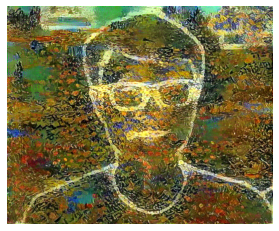

style_transfer     Step: 270ms    | Loss: 8.89e+06 | diff: 69.266%  | lr: 1.000e+00  | epoch: 3  ( 850/1000 )
content_loss 315.8056335449219 style_loss 8884753.0
style_transfer     Step: 245ms    | Loss: 8.88e+06 | diff: 69.279%  | lr: 1.000e+00  | epoch: 3  ( 860/1000 )
content_loss 315.81317138671875 style_loss 8877889.0
style_transfer     Step: 246ms    | Loss: 8.87e+06 | diff: 69.294%  | lr: 1.000e+00  | epoch: 3  ( 870/1000 )
content_loss 315.8095703125 style_loss 8870648.0
style_transfer     Step: 245ms    | Loss: 8.86e+06 | diff: 69.309%  | lr: 1.000e+00  | epoch: 3  ( 880/1000 )
content_loss 315.8092956542969 style_loss 8863410.0
style_transfer     Step: 246ms    | Loss: 8.86e+06 | diff: 69.323%  | lr: 1.000e+00  | epoch: 3  ( 890/1000 )
content_loss 315.8120422363281 style_loss 8857467.0


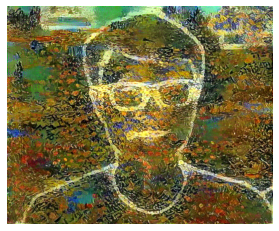

style_transfer     Step: 259ms    | Loss: 8.85e+06 | diff: 69.335%  | lr: 1.000e+00  | epoch: 3  ( 900/1000 )
content_loss 315.81402587890625 style_loss 8850952.0
style_transfer     Step: 245ms    | Loss: 8.84e+06 | diff: 69.350%  | lr: 1.000e+00  | epoch: 3  ( 910/1000 )
content_loss 315.80877685546875 style_loss 8844427.0
style_transfer     Step: 245ms    | Loss: 8.84e+06 | diff: 69.362%  | lr: 1.000e+00  | epoch: 3  ( 920/1000 )
content_loss 315.8236083984375 style_loss 8837768.0
style_transfer     Step: 246ms    | Loss: 8.83e+06 | diff: 69.376%  | lr: 1.000e+00  | epoch: 3  ( 930/1000 )
content_loss 315.8346252441406 style_loss 8831253.0
style_transfer     Step: 245ms    | Loss: 8.83e+06 | diff: 69.388%  | lr: 1.000e+00  | epoch: 3  ( 940/1000 )
content_loss 315.83203125 style_loss 8824887.0


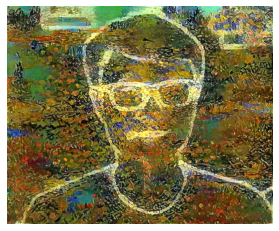

style_transfer     Step: 259ms    | Loss: 8.82e+06 | diff: 69.404%  | lr: 1.000e+00  | epoch: 3  ( 950/1000 )
content_loss 315.8424072265625 style_loss 8817941.0
style_transfer     Step: 245ms    | Loss: 8.81e+06 | diff: 69.418%  | lr: 1.000e+00  | epoch: 3  ( 960/1000 )
content_loss 315.84478759765625 style_loss 8810608.0
style_transfer     Step: 246ms    | Loss: 8.8e+06 | diff: 69.432%  | lr: 1.000e+00  | epoch: 3  ( 970/1000 )
content_loss 315.84051513671875 style_loss 8804124.0
style_transfer     Step: 245ms    | Loss: 8.8e+06 | diff: 69.445%  | lr: 1.000e+00  | epoch: 3  ( 980/1000 )
content_loss 315.8421630859375 style_loss 8797948.0
style_transfer     Step: 245ms    | Loss: 8.79e+06 | diff: 69.456%  | lr: 1.000e+00  | epoch: 3  ( 990/1000 )
content_loss 315.85845947265625 style_loss 8791479.0


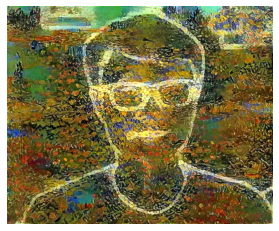

{ content_loss: 3.16e+02, style_loss: 8.79e+06, total_variation_norm_reg_Loss: 5.37, total_losses: 8.79e+06 }
content_loss 315.85858154296875 style_loss 8785685.0
style_transfer     Step: 458ms    | Loss: 8.78e+06 | diff: 69.481%  | lr: 1.000e+00  | epoch: 4  ( 10/1000 )
content_loss 315.85321044921875 style_loss 8779307.0
style_transfer     Step: 245ms    | Loss: 8.77e+06 | diff: 69.494%  | lr: 1.000e+00  | epoch: 4  ( 20/1000 )
content_loss 315.85406494140625 style_loss 8773649.0
style_transfer     Step: 245ms    | Loss: 8.77e+06 | diff: 69.505%  | lr: 1.000e+00  | epoch: 4  ( 30/1000 )
content_loss 315.8556823730469 style_loss 8768048.0
style_transfer     Step: 246ms    | Loss: 8.76e+06 | diff: 69.517%  | lr: 1.000e+00  | epoch: 4  ( 40/1000 )
content_loss 315.8703308105469 style_loss 8762334.0


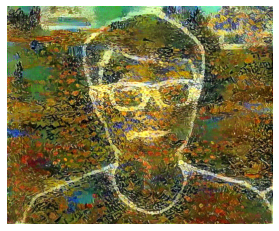

style_transfer     Step: 259ms    | Loss: 8.76e+06 | diff: 69.527%  | lr: 1.000e+00  | epoch: 4  ( 50/1000 )
content_loss 315.8790283203125 style_loss 8756333.0
style_transfer     Step: 246ms    | Loss: 8.75e+06 | diff: 69.542%  | lr: 1.000e+00  | epoch: 4  ( 60/1000 )
content_loss 315.87518310546875 style_loss 8748931.0
style_transfer     Step: 245ms    | Loss: 8.74e+06 | diff: 69.554%  | lr: 1.000e+00  | epoch: 4  ( 70/1000 )
content_loss 315.8686828613281 style_loss 8743019.0
style_transfer     Step: 246ms    | Loss: 8.74e+06 | diff: 69.568%  | lr: 1.000e+00  | epoch: 4  ( 80/1000 )
content_loss 315.8616943359375 style_loss 8737121.0
style_transfer     Step: 245ms    | Loss: 8.73e+06 | diff: 69.580%  | lr: 1.000e+00  | epoch: 4  ( 90/1000 )
content_loss 315.8695068359375 style_loss 8730838.0


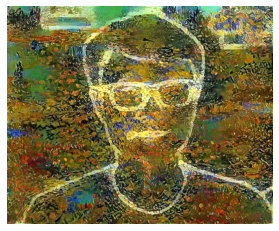

style_transfer     Step: 267ms    | Loss: 8.73e+06 | diff: 69.592%  | lr: 1.000e+00  | epoch: 4  ( 100/1000 )
content_loss 315.87811279296875 style_loss 8725343.0
style_transfer     Step: 246ms    | Loss: 8.72e+06 | diff: 69.605%  | lr: 1.000e+00  | epoch: 4  ( 110/1000 )
content_loss 315.8758850097656 style_loss 8719517.0
style_transfer     Step: 245ms    | Loss: 8.71e+06 | diff: 69.619%  | lr: 1.000e+00  | epoch: 4  ( 120/1000 )
content_loss 315.8836669921875 style_loss 8712857.0
style_transfer     Step: 245ms    | Loss: 8.71e+06 | diff: 69.631%  | lr: 1.000e+00  | epoch: 4  ( 130/1000 )
content_loss 315.88092041015625 style_loss 8706830.0
style_transfer     Step: 246ms    | Loss: 8.7e+06 | diff: 69.644%  | lr: 1.000e+00  | epoch: 4  ( 140/1000 )
content_loss 315.8904724121094 style_loss 8700638.0


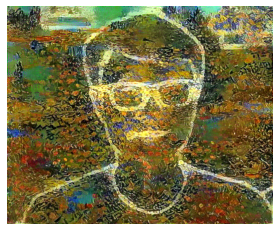

style_transfer     Step: 258ms    | Loss: 8.69e+06 | diff: 69.659%  | lr: 1.000e+00  | epoch: 4  ( 150/1000 )
content_loss 315.8862609863281 style_loss 8693751.0
style_transfer     Step: 246ms    | Loss: 8.69e+06 | diff: 69.673%  | lr: 1.000e+00  | epoch: 4  ( 160/1000 )
content_loss 315.8904113769531 style_loss 8687028.0
style_transfer     Step: 245ms    | Loss: 8.68e+06 | diff: 69.683%  | lr: 1.000e+00  | epoch: 4  ( 170/1000 )
content_loss 315.8874206542969 style_loss 8681044.0
style_transfer     Step: 246ms    | Loss: 8.68e+06 | diff: 69.695%  | lr: 1.000e+00  | epoch: 4  ( 180/1000 )
content_loss 315.8916015625 style_loss 8675396.0
style_transfer     Step: 245ms    | Loss: 8.67e+06 | diff: 69.708%  | lr: 1.000e+00  | epoch: 4  ( 190/1000 )
content_loss 315.89190673828125 style_loss 8669157.0


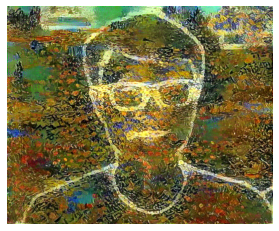

style_transfer     Step: 259ms    | Loss: 8.66e+06 | diff: 69.719%  | lr: 1.000e+00  | epoch: 4  ( 200/1000 )
content_loss 315.8822326660156 style_loss 8664250.0
style_transfer     Step: 246ms    | Loss: 8.66e+06 | diff: 69.732%  | lr: 1.000e+00  | epoch: 4  ( 210/1000 )
content_loss 315.89068603515625 style_loss 8658453.0
style_transfer     Step: 245ms    | Loss: 8.65e+06 | diff: 69.744%  | lr: 1.000e+00  | epoch: 4  ( 220/1000 )
content_loss 315.8877258300781 style_loss 8653090.0
style_transfer     Step: 246ms    | Loss: 8.65e+06 | diff: 69.756%  | lr: 1.000e+00  | epoch: 4  ( 230/1000 )
content_loss 315.88897705078125 style_loss 8647151.0
style_transfer     Step: 245ms    | Loss: 8.64e+06 | diff: 69.765%  | lr: 1.000e+00  | epoch: 4  ( 240/1000 )
content_loss 315.8904724121094 style_loss 8641877.0


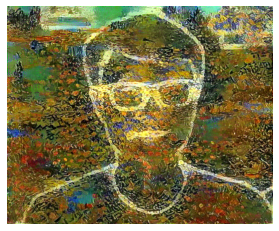

style_transfer     Step: 267ms    | Loss: 8.64e+06 | diff: 69.779%  | lr: 1.000e+00  | epoch: 4  ( 250/1000 )
content_loss 315.8941650390625 style_loss 8636501.0
style_transfer     Step: 246ms    | Loss: 8.63e+06 | diff: 69.790%  | lr: 1.000e+00  | epoch: 4  ( 260/1000 )
content_loss 315.9015197753906 style_loss 8630574.0
style_transfer     Step: 245ms    | Loss: 8.63e+06 | diff: 69.801%  | lr: 1.000e+00  | epoch: 4  ( 270/1000 )
content_loss 315.8947448730469 style_loss 8625354.0
style_transfer     Step: 246ms    | Loss: 8.62e+06 | diff: 69.815%  | lr: 1.000e+00  | epoch: 4  ( 280/1000 )
content_loss 315.88970947265625 style_loss 8619219.0
style_transfer     Step: 245ms    | Loss: 8.61e+06 | diff: 69.825%  | lr: 1.000e+00  | epoch: 4  ( 290/1000 )
content_loss 315.8858337402344 style_loss 8613797.0


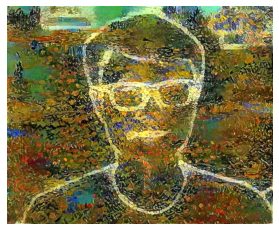

style_transfer     Step: 259ms    | Loss: 8.61e+06 | diff: 69.837%  | lr: 1.000e+00  | epoch: 4  ( 300/1000 )
content_loss 315.89697265625 style_loss 8608119.0
style_transfer     Step: 245ms    | Loss: 8.6e+06 | diff: 69.849%  | lr: 1.000e+00  | epoch: 4  ( 310/1000 )
content_loss 315.892578125 style_loss 8602836.0
style_transfer     Step: 245ms    | Loss: 8.6e+06 | diff: 69.859%  | lr: 1.000e+00  | epoch: 4  ( 320/1000 )
content_loss 315.8834533691406 style_loss 8596836.0
style_transfer     Step: 245ms    | Loss: 8.59e+06 | diff: 69.872%  | lr: 1.000e+00  | epoch: 4  ( 330/1000 )
content_loss 315.8851013183594 style_loss 8591209.0
style_transfer     Step: 245ms    | Loss: 8.59e+06 | diff: 69.881%  | lr: 1.000e+00  | epoch: 4  ( 340/1000 )
content_loss 315.8944396972656 style_loss 8586026.0


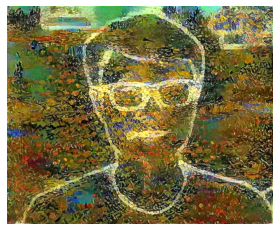

style_transfer     Step: 261ms    | Loss: 8.58e+06 | diff: 69.894%  | lr: 1.000e+00  | epoch: 4  ( 350/1000 )
content_loss 315.8910217285156 style_loss 8579953.0
style_transfer     Step: 246ms    | Loss: 8.58e+06 | diff: 69.904%  | lr: 1.000e+00  | epoch: 4  ( 360/1000 )
content_loss 315.8905334472656 style_loss 8574967.0
style_transfer     Step: 245ms    | Loss: 8.57e+06 | diff: 69.915%  | lr: 1.000e+00  | epoch: 4  ( 370/1000 )
content_loss 315.8934326171875 style_loss 8569348.0
style_transfer     Step: 246ms    | Loss: 8.56e+06 | diff: 69.927%  | lr: 1.000e+00  | epoch: 4  ( 380/1000 )
content_loss 315.89764404296875 style_loss 8563182.0
style_transfer     Step: 246ms    | Loss: 8.56e+06 | diff: 69.939%  | lr: 1.000e+00  | epoch: 4  ( 390/1000 )
content_loss 315.9011535644531 style_loss 8558172.0


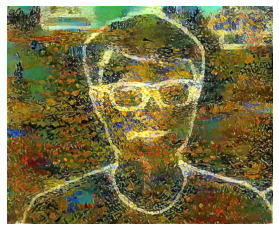

style_transfer     Step: 267ms    | Loss: 8.55e+06 | diff: 69.950%  | lr: 1.000e+00  | epoch: 4  ( 400/1000 )
content_loss 315.8958435058594 style_loss 8552445.0
style_transfer     Step: 245ms    | Loss: 8.55e+06 | diff: 69.962%  | lr: 1.000e+00  | epoch: 4  ( 410/1000 )
content_loss 315.88983154296875 style_loss 8547337.0
style_transfer     Step: 247ms    | Loss: 8.54e+06 | diff: 69.972%  | lr: 1.000e+00  | epoch: 4  ( 420/1000 )
content_loss 315.8841247558594 style_loss 8541872.0
style_transfer     Step: 247ms    | Loss: 8.54e+06 | diff: 69.982%  | lr: 1.000e+00  | epoch: 4  ( 430/1000 )
content_loss 315.8858642578125 style_loss 8537122.0
style_transfer     Step: 245ms    | Loss: 8.53e+06 | diff: 69.994%  | lr: 1.000e+00  | epoch: 4  ( 440/1000 )
content_loss 315.88995361328125 style_loss 8531383.0


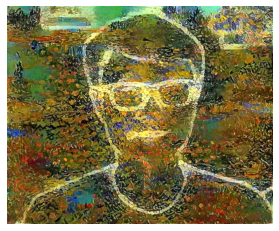

style_transfer     Step: 259ms    | Loss: 8.53e+06 | diff: 70.005%  | lr: 1.000e+00  | epoch: 4  ( 450/1000 )
content_loss 315.883544921875 style_loss 8526081.0
style_transfer     Step: 247ms    | Loss: 8.52e+06 | diff: 70.013%  | lr: 1.000e+00  | epoch: 4  ( 460/1000 )
content_loss 315.89251708984375 style_loss 8521415.0
style_transfer     Step: 246ms    | Loss: 8.52e+06 | diff: 70.025%  | lr: 1.000e+00  | epoch: 4  ( 470/1000 )
content_loss 315.8893127441406 style_loss 8516088.0
style_transfer     Step: 246ms    | Loss: 8.51e+06 | diff: 70.035%  | lr: 1.000e+00  | epoch: 4  ( 480/1000 )
content_loss 315.8897705078125 style_loss 8511088.0
style_transfer     Step: 248ms    | Loss: 8.51e+06 | diff: 70.044%  | lr: 1.000e+00  | epoch: 4  ( 490/1000 )
content_loss 315.89447021484375 style_loss 8505860.0


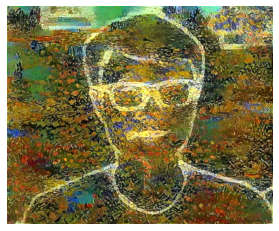

style_transfer     Step: 259ms    | Loss: 8.5e+06 | diff: 70.056%  | lr: 1.000e+00  | epoch: 4  ( 500/1000 )
content_loss 315.90411376953125 style_loss 8500806.0
style_transfer     Step: 256ms    | Loss: 8.5e+06 | diff: 70.065%  | lr: 1.000e+00  | epoch: 4  ( 510/1000 )
content_loss 315.8995056152344 style_loss 8495762.0
style_transfer     Step: 246ms    | Loss: 8.49e+06 | diff: 70.076%  | lr: 1.000e+00  | epoch: 4  ( 520/1000 )
content_loss 315.9012145996094 style_loss 8490592.0
style_transfer     Step: 246ms    | Loss: 8.49e+06 | diff: 70.089%  | lr: 1.000e+00  | epoch: 4  ( 530/1000 )
content_loss 315.90594482421875 style_loss 8485900.0
style_transfer     Step: 247ms    | Loss: 8.48e+06 | diff: 70.096%  | lr: 1.000e+00  | epoch: 4  ( 540/1000 )
content_loss 315.90753173828125 style_loss 8480788.0


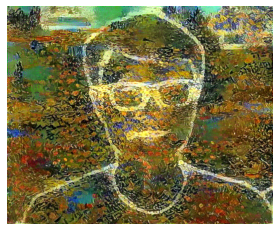

style_transfer     Step: 260ms    | Loss: 8.48e+06 | diff: 70.107%  | lr: 1.000e+00  | epoch: 4  ( 550/1000 )
content_loss 315.9139404296875 style_loss 8475674.0
style_transfer     Step: 247ms    | Loss: 8.47e+06 | diff: 70.119%  | lr: 1.000e+00  | epoch: 4  ( 560/1000 )
content_loss 315.90643310546875 style_loss 8470234.0
style_transfer     Step: 246ms    | Loss: 8.47e+06 | diff: 70.129%  | lr: 1.000e+00  | epoch: 4  ( 570/1000 )
content_loss 315.9041442871094 style_loss 8465240.0
style_transfer     Step: 246ms    | Loss: 8.46e+06 | diff: 70.140%  | lr: 1.000e+00  | epoch: 4  ( 580/1000 )
content_loss 315.9009704589844 style_loss 8459896.0
style_transfer     Step: 246ms    | Loss: 8.45e+06 | diff: 70.152%  | lr: 1.000e+00  | epoch: 4  ( 590/1000 )
content_loss 315.8955078125 style_loss 8454572.0


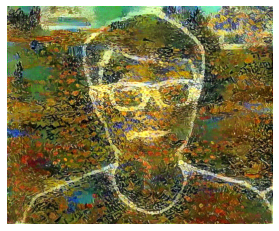

style_transfer     Step: 258ms    | Loss: 8.45e+06 | diff: 70.163%  | lr: 1.000e+00  | epoch: 4  ( 600/1000 )
content_loss 315.89837646484375 style_loss 8449773.0
style_transfer     Step: 246ms    | Loss: 8.44e+06 | diff: 70.173%  | lr: 1.000e+00  | epoch: 4  ( 610/1000 )
content_loss 315.897705078125 style_loss 8444673.0
style_transfer     Step: 246ms    | Loss: 8.44e+06 | diff: 70.180%  | lr: 1.000e+00  | epoch: 4  ( 620/1000 )
content_loss 315.90045166015625 style_loss 8440481.0
style_transfer     Step: 246ms    | Loss: 8.44e+06 | diff: 70.191%  | lr: 1.000e+00  | epoch: 4  ( 630/1000 )
content_loss 315.90435791015625 style_loss 8435337.0
style_transfer     Step: 246ms    | Loss: 8.43e+06 | diff: 70.201%  | lr: 1.000e+00  | epoch: 4  ( 640/1000 )
content_loss 315.9053039550781 style_loss 8431222.0


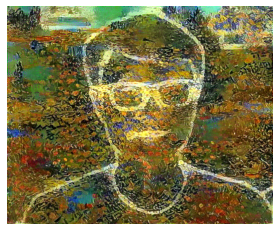

style_transfer     Step: 270ms    | Loss: 8.43e+06 | diff: 70.210%  | lr: 1.000e+00  | epoch: 4  ( 650/1000 )
content_loss 315.8999328613281 style_loss 8426149.0
style_transfer     Step: 246ms    | Loss: 8.42e+06 | diff: 70.220%  | lr: 1.000e+00  | epoch: 4  ( 660/1000 )
content_loss 315.8988342285156 style_loss 8421421.0
style_transfer     Step: 247ms    | Loss: 8.42e+06 | diff: 70.229%  | lr: 1.000e+00  | epoch: 4  ( 670/1000 )
content_loss 315.91119384765625 style_loss 8416994.0
style_transfer     Step: 246ms    | Loss: 8.41e+06 | diff: 70.240%  | lr: 1.000e+00  | epoch: 4  ( 680/1000 )
content_loss 315.89837646484375 style_loss 8412526.0
style_transfer     Step: 246ms    | Loss: 8.41e+06 | diff: 70.248%  | lr: 1.000e+00  | epoch: 4  ( 690/1000 )
content_loss 315.91302490234375 style_loss 8408306.0


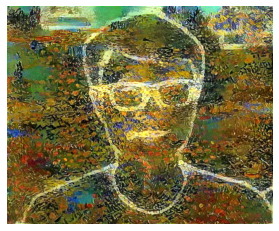

style_transfer     Step: 260ms    | Loss: 8.4e+06 | diff: 70.259%  | lr: 1.000e+00  | epoch: 4  ( 700/1000 )
content_loss 315.9163818359375 style_loss 8403227.0
style_transfer     Step: 246ms    | Loss: 8.4e+06 | diff: 70.270%  | lr: 1.000e+00  | epoch: 4  ( 710/1000 )
content_loss 315.9163818359375 style_loss 8398282.0
style_transfer     Step: 246ms    | Loss: 8.39e+06 | diff: 70.280%  | lr: 1.000e+00  | epoch: 4  ( 720/1000 )
content_loss 315.9106140136719 style_loss 8393376.0
style_transfer     Step: 246ms    | Loss: 8.39e+06 | diff: 70.289%  | lr: 1.000e+00  | epoch: 4  ( 730/1000 )
content_loss 315.9098205566406 style_loss 8388902.0
style_transfer     Step: 246ms    | Loss: 8.39e+06 | diff: 70.297%  | lr: 1.000e+00  | epoch: 4  ( 740/1000 )
content_loss 315.8995361328125 style_loss 8384795.5


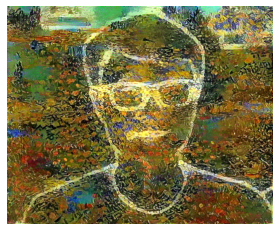

style_transfer     Step: 260ms    | Loss: 8.38e+06 | diff: 70.308%  | lr: 1.000e+00  | epoch: 4  ( 750/1000 )
content_loss 315.90240478515625 style_loss 8380115.5
style_transfer     Step: 246ms    | Loss: 8.38e+06 | diff: 70.318%  | lr: 1.000e+00  | epoch: 4  ( 760/1000 )
content_loss 315.8993835449219 style_loss 8375554.0
style_transfer     Step: 257ms    | Loss: 8.37e+06 | diff: 70.327%  | lr: 1.000e+00  | epoch: 4  ( 770/1000 )
content_loss 315.9017639160156 style_loss 8371009.0
style_transfer     Step: 246ms    | Loss: 8.37e+06 | diff: 70.337%  | lr: 1.000e+00  | epoch: 4  ( 780/1000 )
content_loss 315.907958984375 style_loss 8366923.0
style_transfer     Step: 246ms    | Loss: 8.36e+06 | diff: 70.344%  | lr: 1.000e+00  | epoch: 4  ( 790/1000 )
content_loss 315.90869140625 style_loss 8362429.5


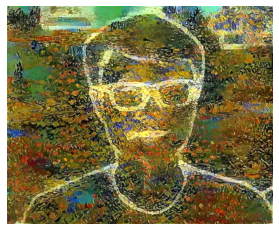

style_transfer     Step: 259ms    | Loss: 8.36e+06 | diff: 70.353%  | lr: 1.000e+00  | epoch: 4  ( 800/1000 )
content_loss 315.91046142578125 style_loss 8358307.5
style_transfer     Step: 245ms    | Loss: 8.35e+06 | diff: 70.363%  | lr: 1.000e+00  | epoch: 4  ( 810/1000 )
content_loss 315.9096374511719 style_loss 8353760.5
style_transfer     Step: 246ms    | Loss: 8.35e+06 | diff: 70.375%  | lr: 1.000e+00  | epoch: 4  ( 820/1000 )
content_loss 315.9149475097656 style_loss 8348760.0
style_transfer     Step: 246ms    | Loss: 8.34e+06 | diff: 70.385%  | lr: 1.000e+00  | epoch: 4  ( 830/1000 )
content_loss 315.9115295410156 style_loss 8344631.0
style_transfer     Step: 247ms    | Loss: 8.34e+06 | diff: 70.394%  | lr: 1.000e+00  | epoch: 4  ( 840/1000 )
content_loss 315.9149169921875 style_loss 8340235.5


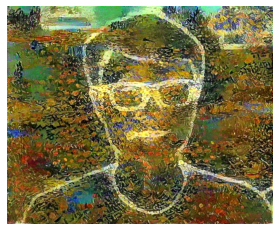

style_transfer     Step: 260ms    | Loss: 8.34e+06 | diff: 70.402%  | lr: 1.000e+00  | epoch: 4  ( 850/1000 )
content_loss 315.92645263671875 style_loss 8336067.0
style_transfer     Step: 246ms    | Loss: 8.33e+06 | diff: 70.412%  | lr: 1.000e+00  | epoch: 4  ( 860/1000 )
content_loss 315.9169921875 style_loss 8331585.0
style_transfer     Step: 246ms    | Loss: 8.33e+06 | diff: 70.422%  | lr: 1.000e+00  | epoch: 4  ( 870/1000 )
content_loss 315.9168701171875 style_loss 8326713.0
style_transfer     Step: 246ms    | Loss: 8.32e+06 | diff: 70.433%  | lr: 1.000e+00  | epoch: 4  ( 880/1000 )
content_loss 315.91363525390625 style_loss 8321779.0
style_transfer     Step: 246ms    | Loss: 8.32e+06 | diff: 70.445%  | lr: 1.000e+00  | epoch: 4  ( 890/1000 )
content_loss 315.9139404296875 style_loss 8316772.5


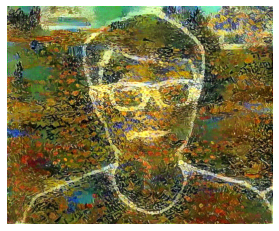

style_transfer     Step: 260ms    | Loss: 8.31e+06 | diff: 70.454%  | lr: 1.000e+00  | epoch: 4  ( 900/1000 )
content_loss 315.92529296875 style_loss 8312011.0
style_transfer     Step: 247ms    | Loss: 8.31e+06 | diff: 70.463%  | lr: 1.000e+00  | epoch: 4  ( 910/1000 )
content_loss 315.9234313964844 style_loss 8307724.5
style_transfer     Step: 247ms    | Loss: 8.3e+06 | diff: 70.473%  | lr: 1.000e+00  | epoch: 4  ( 920/1000 )
content_loss 315.9234619140625 style_loss 8303453.5
style_transfer     Step: 247ms    | Loss: 8.3e+06 | diff: 70.481%  | lr: 1.000e+00  | epoch: 4  ( 930/1000 )
content_loss 315.9119873046875 style_loss 8298987.0
style_transfer     Step: 247ms    | Loss: 8.29e+06 | diff: 70.492%  | lr: 1.000e+00  | epoch: 4  ( 940/1000 )
content_loss 315.9141540527344 style_loss 8294620.5


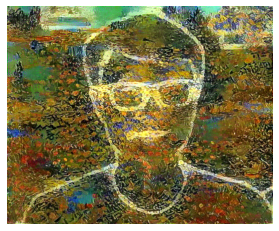

style_transfer     Step: 261ms    | Loss: 8.29e+06 | diff: 70.499%  | lr: 1.000e+00  | epoch: 4  ( 950/1000 )
content_loss 315.9127502441406 style_loss 8290468.0
style_transfer     Step: 246ms    | Loss: 8.29e+06 | diff: 70.509%  | lr: 1.000e+00  | epoch: 4  ( 960/1000 )
content_loss 315.91729736328125 style_loss 8286376.0
style_transfer     Step: 246ms    | Loss: 8.28e+06 | diff: 70.518%  | lr: 1.000e+00  | epoch: 4  ( 970/1000 )
content_loss 315.9120178222656 style_loss 8281998.0
style_transfer     Step: 247ms    | Loss: 8.28e+06 | diff: 70.528%  | lr: 1.000e+00  | epoch: 4  ( 980/1000 )
content_loss 315.9174499511719 style_loss 8277570.0
style_transfer     Step: 246ms    | Loss: 8.27e+06 | diff: 70.537%  | lr: 1.000e+00  | epoch: 4  ( 990/1000 )
content_loss 315.9158020019531 style_loss 8273644.5


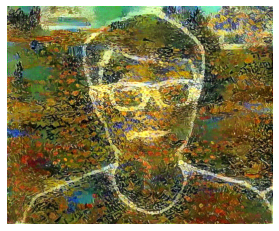

{ content_loss: 3.16e+02, style_loss: 8.27e+06, total_variation_norm_reg_Loss: 5.47, total_losses: 8.27e+06 }
content_loss 315.9183349609375 style_loss 8269590.0
style_transfer     Step: 461ms    | Loss: 8.27e+06 | diff: 70.553%  | lr: 1.000e+00  | epoch: 5  ( 10/1000 )
content_loss 315.92218017578125 style_loss 8265797.0
style_transfer     Step: 247ms    | Loss: 8.26e+06 | diff: 70.562%  | lr: 1.000e+00  | epoch: 5  ( 20/1000 )
content_loss 315.9255676269531 style_loss 8261677.5
style_transfer     Step: 246ms    | Loss: 8.26e+06 | diff: 70.572%  | lr: 1.000e+00  | epoch: 5  ( 30/1000 )
content_loss 315.9292297363281 style_loss 8257310.5
style_transfer     Step: 245ms    | Loss: 8.25e+06 | diff: 70.579%  | lr: 1.000e+00  | epoch: 5  ( 40/1000 )
content_loss 315.9229736328125 style_loss 8253187.5


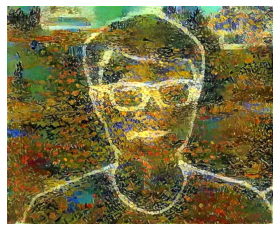

style_transfer     Step: 259ms    | Loss: 8.25e+06 | diff: 70.589%  | lr: 1.000e+00  | epoch: 5  ( 50/1000 )
content_loss 315.9186706542969 style_loss 8249039.0
style_transfer     Step: 247ms    | Loss: 8.25e+06 | diff: 70.597%  | lr: 1.000e+00  | epoch: 5  ( 60/1000 )
content_loss 315.91839599609375 style_loss 8245060.5
style_transfer     Step: 247ms    | Loss: 8.24e+06 | diff: 70.605%  | lr: 1.000e+00  | epoch: 5  ( 70/1000 )
content_loss 315.9202880859375 style_loss 8241418.0
style_transfer     Step: 247ms    | Loss: 8.24e+06 | diff: 70.615%  | lr: 1.000e+00  | epoch: 5  ( 80/1000 )
content_loss 315.92333984375 style_loss 8237201.0
style_transfer     Step: 247ms    | Loss: 8.23e+06 | diff: 70.623%  | lr: 1.000e+00  | epoch: 5  ( 90/1000 )
content_loss 315.929931640625 style_loss 8233023.0


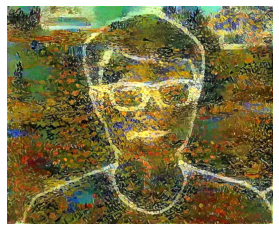

style_transfer     Step: 259ms    | Loss: 8.23e+06 | diff: 70.632%  | lr: 1.000e+00  | epoch: 5  ( 100/1000 )
content_loss 315.93011474609375 style_loss 8229025.5
style_transfer     Step: 247ms    | Loss: 8.23e+06 | diff: 70.641%  | lr: 1.000e+00  | epoch: 5  ( 110/1000 )
content_loss 315.93310546875 style_loss 8225164.0
style_transfer     Step: 246ms    | Loss: 8.22e+06 | diff: 70.649%  | lr: 1.000e+00  | epoch: 5  ( 120/1000 )
content_loss 315.9386291503906 style_loss 8221402.5
style_transfer     Step: 246ms    | Loss: 8.22e+06 | diff: 70.656%  | lr: 1.000e+00  | epoch: 5  ( 130/1000 )
content_loss 315.9291076660156 style_loss 8217585.0
style_transfer     Step: 246ms    | Loss: 8.21e+06 | diff: 70.666%  | lr: 1.000e+00  | epoch: 5  ( 140/1000 )
content_loss 315.9300537109375 style_loss 8213655.0


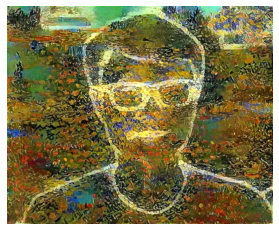

style_transfer     Step: 259ms    | Loss: 8.21e+06 | diff: 70.676%  | lr: 1.000e+00  | epoch: 5  ( 150/1000 )
content_loss 315.9320373535156 style_loss 8209529.0
style_transfer     Step: 247ms    | Loss: 8.21e+06 | diff: 70.683%  | lr: 1.000e+00  | epoch: 5  ( 160/1000 )
content_loss 315.9325866699219 style_loss 8205744.5
style_transfer     Step: 247ms    | Loss: 8.2e+06 | diff: 70.692%  | lr: 1.000e+00  | epoch: 5  ( 170/1000 )
content_loss 315.9297790527344 style_loss 8201563.0
style_transfer     Step: 247ms    | Loss: 8.2e+06 | diff: 70.701%  | lr: 1.000e+00  | epoch: 5  ( 180/1000 )
content_loss 315.927001953125 style_loss 8197291.0
style_transfer     Step: 247ms    | Loss: 8.19e+06 | diff: 70.710%  | lr: 1.000e+00  | epoch: 5  ( 190/1000 )
content_loss 315.9346008300781 style_loss 8193439.5


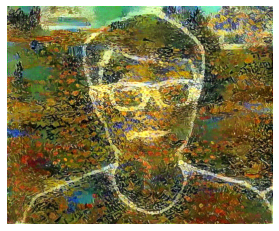

style_transfer     Step: 259ms    | Loss: 8.19e+06 | diff: 70.718%  | lr: 1.000e+00  | epoch: 5  ( 200/1000 )
content_loss 315.9423828125 style_loss 8189613.0
style_transfer     Step: 246ms    | Loss: 8.19e+06 | diff: 70.728%  | lr: 1.000e+00  | epoch: 5  ( 210/1000 )
content_loss 315.9530944824219 style_loss 8185755.0
style_transfer     Step: 246ms    | Loss: 8.18e+06 | diff: 70.735%  | lr: 1.000e+00  | epoch: 5  ( 220/1000 )
content_loss 315.9511413574219 style_loss 8182334.0
style_transfer     Step: 247ms    | Loss: 8.18e+06 | diff: 70.743%  | lr: 1.000e+00  | epoch: 5  ( 230/1000 )
content_loss 315.9493103027344 style_loss 8178002.0
style_transfer     Step: 247ms    | Loss: 8.17e+06 | diff: 70.751%  | lr: 1.000e+00  | epoch: 5  ( 240/1000 )
content_loss 315.954833984375 style_loss 8173994.0


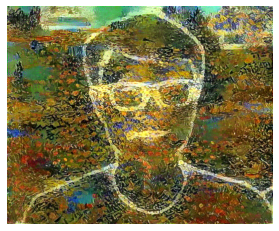

style_transfer     Step: 259ms    | Loss: 8.17e+06 | diff: 70.762%  | lr: 1.000e+00  | epoch: 5  ( 250/1000 )
content_loss 315.9530944824219 style_loss 8169752.0
style_transfer     Step: 247ms    | Loss: 8.17e+06 | diff: 70.769%  | lr: 1.000e+00  | epoch: 5  ( 260/1000 )
content_loss 315.955078125 style_loss 8166180.0
style_transfer     Step: 246ms    | Loss: 8.16e+06 | diff: 70.777%  | lr: 1.000e+00  | epoch: 5  ( 270/1000 )
content_loss 315.9510498046875 style_loss 8162292.0
style_transfer     Step: 246ms    | Loss: 8.16e+06 | diff: 70.785%  | lr: 1.000e+00  | epoch: 5  ( 280/1000 )
content_loss 315.9547119140625 style_loss 8158665.0
style_transfer     Step: 247ms    | Loss: 8.15e+06 | diff: 70.794%  | lr: 1.000e+00  | epoch: 5  ( 290/1000 )
content_loss 315.95361328125 style_loss 8154620.5


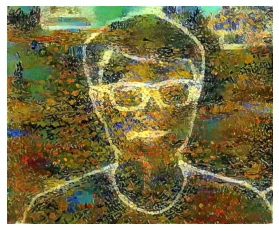

style_transfer     Step: 261ms    | Loss: 8.15e+06 | diff: 70.802%  | lr: 1.000e+00  | epoch: 5  ( 300/1000 )
content_loss 315.948974609375 style_loss 8150729.0
style_transfer     Step: 248ms    | Loss: 8.15e+06 | diff: 70.810%  | lr: 1.000e+00  | epoch: 5  ( 310/1000 )
content_loss 315.9442138671875 style_loss 8146846.0
style_transfer     Step: 246ms    | Loss: 8.14e+06 | diff: 70.820%  | lr: 1.000e+00  | epoch: 5  ( 320/1000 )
content_loss 315.9558410644531 style_loss 8143141.0
style_transfer     Step: 247ms    | Loss: 8.14e+06 | diff: 70.829%  | lr: 1.000e+00  | epoch: 5  ( 330/1000 )
content_loss 315.9582214355469 style_loss 8138852.0
style_transfer     Step: 247ms    | Loss: 8.14e+06 | diff: 70.837%  | lr: 1.000e+00  | epoch: 5  ( 340/1000 )
content_loss 315.95184326171875 style_loss 8134781.0


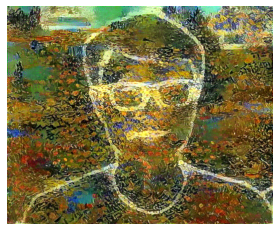

style_transfer     Step: 263ms    | Loss: 8.13e+06 | diff: 70.847%  | lr: 1.000e+00  | epoch: 5  ( 350/1000 )
content_loss 315.95233154296875 style_loss 8131173.0
style_transfer     Step: 246ms    | Loss: 8.13e+06 | diff: 70.854%  | lr: 1.000e+00  | epoch: 5  ( 360/1000 )
content_loss 315.95135498046875 style_loss 8127514.0
style_transfer     Step: 246ms    | Loss: 8.12e+06 | diff: 70.861%  | lr: 1.000e+00  | epoch: 5  ( 370/1000 )
content_loss 315.9605712890625 style_loss 8124145.5
style_transfer     Step: 246ms    | Loss: 8.12e+06 | diff: 70.871%  | lr: 1.000e+00  | epoch: 5  ( 380/1000 )
content_loss 315.9585266113281 style_loss 8120520.0
style_transfer     Step: 246ms    | Loss: 8.12e+06 | diff: 70.876%  | lr: 1.000e+00  | epoch: 5  ( 390/1000 )
content_loss 315.9691162109375 style_loss 8116836.5


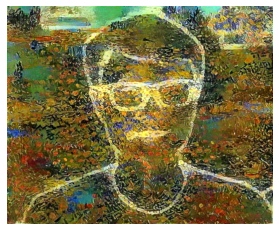

style_transfer     Step: 259ms    | Loss: 8.11e+06 | diff: 70.886%  | lr: 1.000e+00  | epoch: 5  ( 400/1000 )
content_loss 315.9751281738281 style_loss 8113110.0
style_transfer     Step: 247ms    | Loss: 8.11e+06 | diff: 70.892%  | lr: 1.000e+00  | epoch: 5  ( 410/1000 )
content_loss 315.9798889160156 style_loss 8110015.5
style_transfer     Step: 247ms    | Loss: 8.11e+06 | diff: 70.900%  | lr: 1.000e+00  | epoch: 5  ( 420/1000 )
content_loss 315.96990966796875 style_loss 8106475.5
style_transfer     Step: 246ms    | Loss: 8.1e+06 | diff: 70.906%  | lr: 1.000e+00  | epoch: 5  ( 430/1000 )
content_loss 315.9846496582031 style_loss 8103049.0
style_transfer     Step: 246ms    | Loss: 8.1e+06 | diff: 70.913%  | lr: 1.000e+00  | epoch: 5  ( 440/1000 )
content_loss 315.98712158203125 style_loss 8099808.0


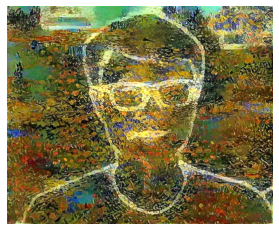

style_transfer     Step: 260ms    | Loss: 8.1e+06 | diff: 70.922%  | lr: 1.000e+00  | epoch: 5  ( 450/1000 )
content_loss 315.9914245605469 style_loss 8096091.5
style_transfer     Step: 247ms    | Loss: 8.09e+06 | diff: 70.930%  | lr: 1.000e+00  | epoch: 5  ( 460/1000 )
content_loss 315.9999084472656 style_loss 8092300.5
style_transfer     Step: 246ms    | Loss: 8.09e+06 | diff: 70.937%  | lr: 1.000e+00  | epoch: 5  ( 470/1000 )
content_loss 315.99627685546875 style_loss 8088633.0
style_transfer     Step: 246ms    | Loss: 8.09e+06 | diff: 70.946%  | lr: 1.000e+00  | epoch: 5  ( 480/1000 )
content_loss 315.9990234375 style_loss 8084964.5
style_transfer     Step: 247ms    | Loss: 8.08e+06 | diff: 70.954%  | lr: 1.000e+00  | epoch: 5  ( 490/1000 )
content_loss 315.9970397949219 style_loss 8081748.0


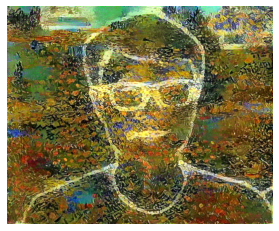

style_transfer     Step: 260ms    | Loss: 8.08e+06 | diff: 70.961%  | lr: 1.000e+00  | epoch: 5  ( 500/1000 )
content_loss 316.00103759765625 style_loss 8078188.0
style_transfer     Step: 247ms    | Loss: 8.08e+06 | diff: 70.969%  | lr: 1.000e+00  | epoch: 5  ( 510/1000 )
content_loss 316.0010070800781 style_loss 8074793.5
style_transfer     Step: 256ms    | Loss: 8.07e+06 | diff: 70.976%  | lr: 1.000e+00  | epoch: 5  ( 520/1000 )
content_loss 315.9957580566406 style_loss 8071335.0
style_transfer     Step: 246ms    | Loss: 8.07e+06 | diff: 70.984%  | lr: 1.000e+00  | epoch: 5  ( 530/1000 )
content_loss 316.0046691894531 style_loss 8067743.5
style_transfer     Step: 246ms    | Loss: 8.07e+06 | diff: 70.990%  | lr: 1.000e+00  | epoch: 5  ( 540/1000 )
content_loss 315.9963684082031 style_loss 8064733.0


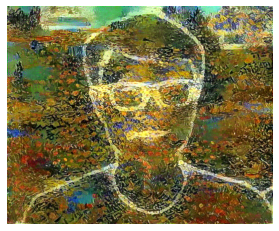

style_transfer     Step: 260ms    | Loss: 8.06e+06 | diff: 70.997%  | lr: 1.000e+00  | epoch: 5  ( 550/1000 )
content_loss 315.9905700683594 style_loss 8061314.0
style_transfer     Step: 247ms    | Loss: 8.06e+06 | diff: 71.005%  | lr: 1.000e+00  | epoch: 5  ( 560/1000 )
content_loss 316.0031433105469 style_loss 8058100.5
style_transfer     Step: 247ms    | Loss: 8.05e+06 | diff: 71.013%  | lr: 1.000e+00  | epoch: 5  ( 570/1000 )
content_loss 316.0002136230469 style_loss 8054643.0
style_transfer     Step: 246ms    | Loss: 8.05e+06 | diff: 71.021%  | lr: 1.000e+00  | epoch: 5  ( 580/1000 )
content_loss 316.00048828125 style_loss 8051157.0
style_transfer     Step: 246ms    | Loss: 8.05e+06 | diff: 71.030%  | lr: 1.000e+00  | epoch: 5  ( 590/1000 )
content_loss 316.0026550292969 style_loss 8047930.5


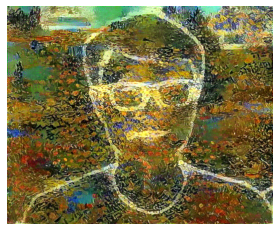

style_transfer     Step: 260ms    | Loss: 8.04e+06 | diff: 71.037%  | lr: 1.000e+00  | epoch: 5  ( 600/1000 )
content_loss 316.0013427734375 style_loss 8044459.0
style_transfer     Step: 246ms    | Loss: 8.04e+06 | diff: 71.044%  | lr: 1.000e+00  | epoch: 5  ( 610/1000 )
content_loss 315.9954528808594 style_loss 8041181.0
style_transfer     Step: 246ms    | Loss: 8.04e+06 | diff: 71.051%  | lr: 1.000e+00  | epoch: 5  ( 620/1000 )
content_loss 316.00518798828125 style_loss 8037599.0
style_transfer     Step: 247ms    | Loss: 8.03e+06 | diff: 71.059%  | lr: 1.000e+00  | epoch: 5  ( 630/1000 )
content_loss 316.0000915527344 style_loss 8034035.5
style_transfer     Step: 247ms    | Loss: 8.03e+06 | diff: 71.066%  | lr: 1.000e+00  | epoch: 5  ( 640/1000 )
content_loss 315.9937438964844 style_loss 8030699.0


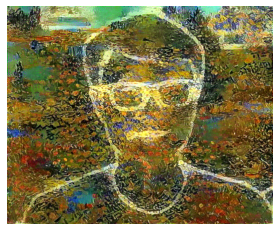

style_transfer     Step: 261ms    | Loss: 8.03e+06 | diff: 71.074%  | lr: 1.000e+00  | epoch: 5  ( 650/1000 )
content_loss 316.000244140625 style_loss 8027539.5
style_transfer     Step: 247ms    | Loss: 8.02e+06 | diff: 71.081%  | lr: 1.000e+00  | epoch: 5  ( 660/1000 )
content_loss 315.99920654296875 style_loss 8023699.5
style_transfer     Step: 246ms    | Loss: 8.02e+06 | diff: 71.090%  | lr: 1.000e+00  | epoch: 5  ( 670/1000 )
content_loss 315.9990234375 style_loss 8020627.5
style_transfer     Step: 247ms    | Loss: 8.02e+06 | diff: 71.096%  | lr: 1.000e+00  | epoch: 5  ( 680/1000 )
content_loss 315.99847412109375 style_loss 8017487.0
style_transfer     Step: 247ms    | Loss: 8.01e+06 | diff: 71.104%  | lr: 1.000e+00  | epoch: 5  ( 690/1000 )
content_loss 315.99078369140625 style_loss 8014065.0


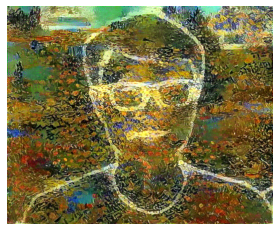

style_transfer     Step: 262ms    | Loss: 8.01e+06 | diff: 71.111%  | lr: 1.000e+00  | epoch: 5  ( 700/1000 )
content_loss 315.99462890625 style_loss 8010694.0
style_transfer     Step: 247ms    | Loss: 8.01e+06 | diff: 71.118%  | lr: 1.000e+00  | epoch: 5  ( 710/1000 )
content_loss 315.9951171875 style_loss 8007508.0
style_transfer     Step: 247ms    | Loss: 8e+06 | diff: 71.125%  | lr: 1.000e+00  | epoch: 5  ( 720/1000 )
content_loss 316.00048828125 style_loss 8004366.5
style_transfer     Step: 247ms    | Loss: 8e+06 | diff: 71.132%  | lr: 1.000e+00  | epoch: 5  ( 730/1000 )
content_loss 315.99871826171875 style_loss 8000824.0
style_transfer     Step: 247ms    | Loss: 8e+06 | diff: 71.140%  | lr: 1.000e+00  | epoch: 5  ( 740/1000 )
content_loss 315.99749755859375 style_loss 7997734.0


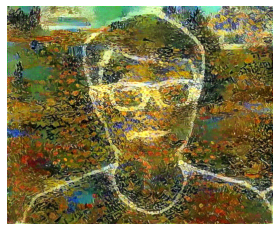

style_transfer     Step: 259ms    | Loss: 8e+06 | diff: 71.146%  | lr: 1.000e+00  | epoch: 5  ( 750/1000 )
content_loss 315.9950866699219 style_loss 7994918.5
style_transfer     Step: 247ms    | Loss: 7.99e+06 | diff: 71.153%  | lr: 1.000e+00  | epoch: 5  ( 760/1000 )
content_loss 316.0006103515625 style_loss 7991420.5
style_transfer     Step: 246ms    | Loss: 7.99e+06 | diff: 71.160%  | lr: 1.000e+00  | epoch: 5  ( 770/1000 )
content_loss 316.00433349609375 style_loss 7988465.5
style_transfer     Step: 246ms    | Loss: 7.99e+06 | diff: 71.167%  | lr: 1.000e+00  | epoch: 5  ( 780/1000 )
content_loss 316.00726318359375 style_loss 7985474.0
style_transfer     Step: 246ms    | Loss: 7.98e+06 | diff: 71.174%  | lr: 1.000e+00  | epoch: 5  ( 790/1000 )
content_loss 316.001953125 style_loss 7982596.0


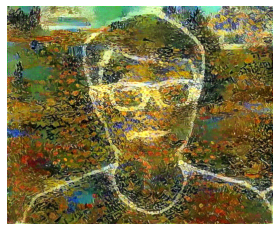

style_transfer     Step: 263ms    | Loss: 7.98e+06 | diff: 71.180%  | lr: 1.000e+00  | epoch: 5  ( 800/1000 )
content_loss 316.0046691894531 style_loss 7979456.0
style_transfer     Step: 246ms    | Loss: 7.98e+06 | diff: 71.188%  | lr: 1.000e+00  | epoch: 5  ( 810/1000 )
content_loss 316.0036926269531 style_loss 7976077.5
style_transfer     Step: 247ms    | Loss: 7.97e+06 | diff: 71.196%  | lr: 1.000e+00  | epoch: 5  ( 820/1000 )
content_loss 316.00457763671875 style_loss 7972927.5
style_transfer     Step: 247ms    | Loss: 7.97e+06 | diff: 71.203%  | lr: 1.000e+00  | epoch: 5  ( 830/1000 )
content_loss 316.010986328125 style_loss 7969553.5
style_transfer     Step: 246ms    | Loss: 7.97e+06 | diff: 71.209%  | lr: 1.000e+00  | epoch: 5  ( 840/1000 )
content_loss 316.0062255859375 style_loss 7966654.0


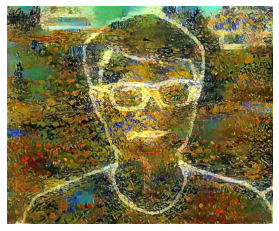

style_transfer     Step: 260ms    | Loss: 7.96e+06 | diff: 71.217%  | lr: 1.000e+00  | epoch: 5  ( 850/1000 )
content_loss 316.00372314453125 style_loss 7963212.0
style_transfer     Step: 247ms    | Loss: 7.96e+06 | diff: 71.223%  | lr: 1.000e+00  | epoch: 5  ( 860/1000 )
content_loss 316.00177001953125 style_loss 7960402.5
style_transfer     Step: 247ms    | Loss: 7.96e+06 | diff: 71.231%  | lr: 1.000e+00  | epoch: 5  ( 870/1000 )
content_loss 316.0025634765625 style_loss 7957353.0
style_transfer     Step: 249ms    | Loss: 7.95e+06 | diff: 71.238%  | lr: 1.000e+00  | epoch: 5  ( 880/1000 )
content_loss 316.00701904296875 style_loss 7954163.5
style_transfer     Step: 247ms    | Loss: 7.95e+06 | diff: 71.244%  | lr: 1.000e+00  | epoch: 5  ( 890/1000 )
content_loss 316.001708984375 style_loss 7951440.0


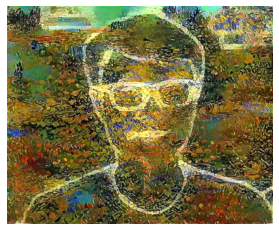

style_transfer     Step: 262ms    | Loss: 7.95e+06 | diff: 71.250%  | lr: 1.000e+00  | epoch: 5  ( 900/1000 )
content_loss 316.0066833496094 style_loss 7948552.5
style_transfer     Step: 247ms    | Loss: 7.95e+06 | diff: 71.258%  | lr: 1.000e+00  | epoch: 5  ( 910/1000 )
content_loss 316.00439453125 style_loss 7945283.5
style_transfer     Step: 246ms    | Loss: 7.94e+06 | diff: 71.264%  | lr: 1.000e+00  | epoch: 5  ( 920/1000 )
content_loss 316.0135498046875 style_loss 7942254.5
style_transfer     Step: 247ms    | Loss: 7.94e+06 | diff: 71.270%  | lr: 1.000e+00  | epoch: 5  ( 930/1000 )
content_loss 316.01715087890625 style_loss 7939330.5
style_transfer     Step: 247ms    | Loss: 7.94e+06 | diff: 71.277%  | lr: 1.000e+00  | epoch: 5  ( 940/1000 )
content_loss 316.0132751464844 style_loss 7936484.0


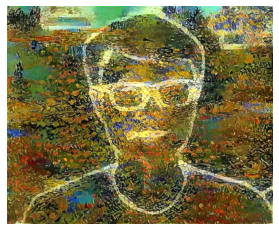

style_transfer     Step: 260ms    | Loss: 7.93e+06 | diff: 71.284%  | lr: 1.000e+00  | epoch: 5  ( 950/1000 )
content_loss 316.0178527832031 style_loss 7933444.5
style_transfer     Step: 247ms    | Loss: 7.93e+06 | diff: 71.291%  | lr: 1.000e+00  | epoch: 5  ( 960/1000 )
content_loss 316.01873779296875 style_loss 7930486.0
style_transfer     Step: 247ms    | Loss: 7.93e+06 | diff: 71.297%  | lr: 1.000e+00  | epoch: 5  ( 970/1000 )
content_loss 316.00885009765625 style_loss 7927791.5
style_transfer     Step: 248ms    | Loss: 7.93e+06 | diff: 71.304%  | lr: 1.000e+00  | epoch: 5  ( 980/1000 )
content_loss 316.01715087890625 style_loss 7924903.0
style_transfer     Step: 249ms    | Loss: 7.92e+06 | diff: 71.311%  | lr: 1.000e+00  | epoch: 5  ( 990/1000 )
content_loss 316.01922607421875 style_loss 7921817.0


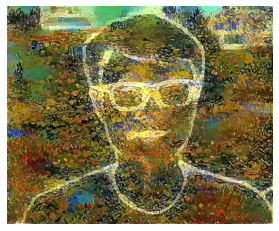

{ content_loss: 3.16e+02, style_loss: 7.92e+06, total_variation_norm_reg_Loss: 5.56, total_losses: 7.92e+06 }
content_loss 316.0240173339844 style_loss 7918738.0
style_transfer     Step: 460ms    | Loss: 7.92e+06 | diff: 71.323%  | lr: 1.000e+00  | epoch: 6  ( 10/1000 )
content_loss 316.02655029296875 style_loss 7915781.0
style_transfer     Step: 247ms    | Loss: 7.91e+06 | diff: 71.330%  | lr: 1.000e+00  | epoch: 6  ( 20/1000 )
content_loss 316.02960205078125 style_loss 7913106.5
style_transfer     Step: 256ms    | Loss: 7.91e+06 | diff: 71.337%  | lr: 1.000e+00  | epoch: 6  ( 30/1000 )
content_loss 316.030029296875 style_loss 7909968.0
style_transfer     Step: 247ms    | Loss: 7.91e+06 | diff: 71.344%  | lr: 1.000e+00  | epoch: 6  ( 40/1000 )
content_loss 316.0345764160156 style_loss 7906937.0


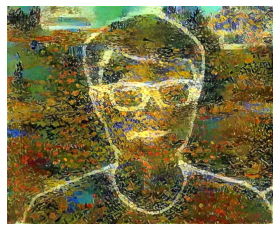

style_transfer     Step: 260ms    | Loss: 7.9e+06 | diff: 71.351%  | lr: 1.000e+00  | epoch: 6  ( 50/1000 )
content_loss 316.0403747558594 style_loss 7903863.0
style_transfer     Step: 250ms    | Loss: 7.9e+06 | diff: 71.358%  | lr: 1.000e+00  | epoch: 6  ( 60/1000 )
content_loss 316.03973388671875 style_loss 7900500.0
style_transfer     Step: 247ms    | Loss: 7.9e+06 | diff: 71.365%  | lr: 1.000e+00  | epoch: 6  ( 70/1000 )
content_loss 316.0383605957031 style_loss 7897518.0
style_transfer     Step: 247ms    | Loss: 7.9e+06 | diff: 71.371%  | lr: 1.000e+00  | epoch: 6  ( 80/1000 )
content_loss 316.046630859375 style_loss 7894770.0
style_transfer     Step: 246ms    | Loss: 7.89e+06 | diff: 71.378%  | lr: 1.000e+00  | epoch: 6  ( 90/1000 )
content_loss 316.0548095703125 style_loss 7891741.0


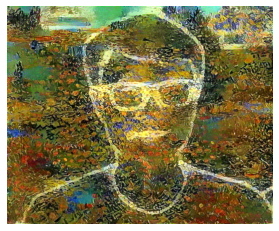

style_transfer     Step: 258ms    | Loss: 7.89e+06 | diff: 71.384%  | lr: 1.000e+00  | epoch: 6  ( 100/1000 )
content_loss 316.05963134765625 style_loss 7889092.5
style_transfer     Step: 248ms    | Loss: 7.89e+06 | diff: 71.390%  | lr: 1.000e+00  | epoch: 6  ( 110/1000 )
content_loss 316.0660400390625 style_loss 7886325.0
style_transfer     Step: 247ms    | Loss: 7.88e+06 | diff: 71.398%  | lr: 1.000e+00  | epoch: 6  ( 120/1000 )
content_loss 316.0711669921875 style_loss 7882923.0
style_transfer     Step: 247ms    | Loss: 7.88e+06 | diff: 71.405%  | lr: 1.000e+00  | epoch: 6  ( 130/1000 )
content_loss 316.075439453125 style_loss 7880252.0
style_transfer     Step: 247ms    | Loss: 7.88e+06 | diff: 71.411%  | lr: 1.000e+00  | epoch: 6  ( 140/1000 )
content_loss 316.07611083984375 style_loss 7877479.0


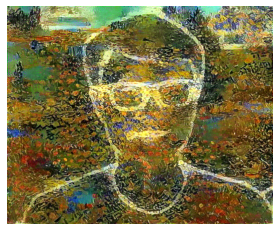

style_transfer     Step: 260ms    | Loss: 7.87e+06 | diff: 71.417%  | lr: 1.000e+00  | epoch: 6  ( 150/1000 )
content_loss 316.0826416015625 style_loss 7874634.5
style_transfer     Step: 246ms    | Loss: 7.87e+06 | diff: 71.422%  | lr: 1.000e+00  | epoch: 6  ( 160/1000 )
content_loss 316.0836486816406 style_loss 7871929.5
style_transfer     Step: 247ms    | Loss: 7.87e+06 | diff: 71.430%  | lr: 1.000e+00  | epoch: 6  ( 170/1000 )
content_loss 316.0950927734375 style_loss 7869161.0
style_transfer     Step: 246ms    | Loss: 7.87e+06 | diff: 71.436%  | lr: 1.000e+00  | epoch: 6  ( 180/1000 )
content_loss 316.090576171875 style_loss 7866277.5
style_transfer     Step: 246ms    | Loss: 7.86e+06 | diff: 71.443%  | lr: 1.000e+00  | epoch: 6  ( 190/1000 )
content_loss 316.09039306640625 style_loss 7863086.5


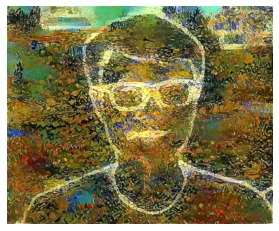

style_transfer     Step: 261ms    | Loss: 7.86e+06 | diff: 71.449%  | lr: 1.000e+00  | epoch: 6  ( 200/1000 )
content_loss 316.0931091308594 style_loss 7860456.0
style_transfer     Step: 248ms    | Loss: 7.86e+06 | diff: 71.455%  | lr: 1.000e+00  | epoch: 6  ( 210/1000 )
content_loss 316.09332275390625 style_loss 7857640.0
style_transfer     Step: 248ms    | Loss: 7.86e+06 | diff: 71.461%  | lr: 1.000e+00  | epoch: 6  ( 220/1000 )
content_loss 316.0956115722656 style_loss 7855177.5
style_transfer     Step: 247ms    | Loss: 7.85e+06 | diff: 71.467%  | lr: 1.000e+00  | epoch: 6  ( 230/1000 )
content_loss 316.0962219238281 style_loss 7852210.0
style_transfer     Step: 246ms    | Loss: 7.85e+06 | diff: 71.474%  | lr: 1.000e+00  | epoch: 6  ( 240/1000 )
content_loss 316.0985107421875 style_loss 7849806.0


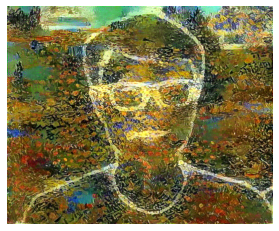

style_transfer     Step: 260ms    | Loss: 7.85e+06 | diff: 71.480%  | lr: 1.000e+00  | epoch: 6  ( 250/1000 )
content_loss 316.0989685058594 style_loss 7846872.5
style_transfer     Step: 247ms    | Loss: 7.84e+06 | diff: 71.487%  | lr: 1.000e+00  | epoch: 6  ( 260/1000 )
content_loss 316.0979309082031 style_loss 7843951.0
style_transfer     Step: 249ms    | Loss: 7.84e+06 | diff: 71.493%  | lr: 1.000e+00  | epoch: 6  ( 270/1000 )
content_loss 316.10052490234375 style_loss 7841180.5
style_transfer     Step: 247ms    | Loss: 7.84e+06 | diff: 71.500%  | lr: 1.000e+00  | epoch: 6  ( 280/1000 )
content_loss 316.09429931640625 style_loss 7838378.5
style_transfer     Step: 249ms    | Loss: 7.84e+06 | diff: 71.507%  | lr: 1.000e+00  | epoch: 6  ( 290/1000 )
content_loss 316.10357666015625 style_loss 7835394.5


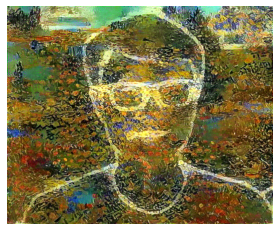

style_transfer     Step: 260ms    | Loss: 7.83e+06 | diff: 71.512%  | lr: 1.000e+00  | epoch: 6  ( 300/1000 )
content_loss 316.0990295410156 style_loss 7832775.5
style_transfer     Step: 247ms    | Loss: 7.83e+06 | diff: 71.518%  | lr: 1.000e+00  | epoch: 6  ( 310/1000 )
content_loss 316.0999755859375 style_loss 7830039.5
style_transfer     Step: 247ms    | Loss: 7.83e+06 | diff: 71.526%  | lr: 1.000e+00  | epoch: 6  ( 320/1000 )
content_loss 316.1031494140625 style_loss 7827291.5
style_transfer     Step: 246ms    | Loss: 7.83e+06 | diff: 71.531%  | lr: 1.000e+00  | epoch: 6  ( 330/1000 )
content_loss 316.10565185546875 style_loss 7824785.0
style_transfer     Step: 247ms    | Loss: 7.82e+06 | diff: 71.536%  | lr: 1.000e+00  | epoch: 6  ( 340/1000 )
content_loss 316.0995178222656 style_loss 7822194.5


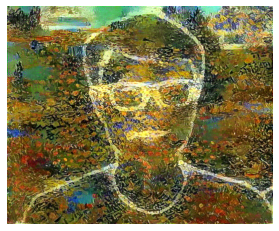

style_transfer     Step: 261ms    | Loss: 7.82e+06 | diff: 71.543%  | lr: 1.000e+00  | epoch: 6  ( 350/1000 )
content_loss 316.1069030761719 style_loss 7819131.0
style_transfer     Step: 246ms    | Loss: 7.82e+06 | diff: 71.550%  | lr: 1.000e+00  | epoch: 6  ( 360/1000 )
content_loss 316.1085205078125 style_loss 7816357.5
style_transfer     Step: 247ms    | Loss: 7.81e+06 | diff: 71.556%  | lr: 1.000e+00  | epoch: 6  ( 370/1000 )
content_loss 316.11761474609375 style_loss 7813645.0
style_transfer     Step: 248ms    | Loss: 7.81e+06 | diff: 71.562%  | lr: 1.000e+00  | epoch: 6  ( 380/1000 )
content_loss 316.1145324707031 style_loss 7811237.0
style_transfer     Step: 248ms    | Loss: 7.81e+06 | diff: 71.569%  | lr: 1.000e+00  | epoch: 6  ( 390/1000 )
content_loss 316.1162414550781 style_loss 7808426.0


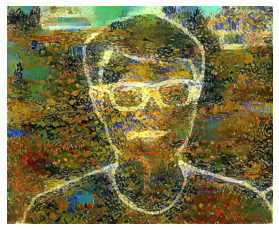

style_transfer     Step: 261ms    | Loss: 7.81e+06 | diff: 71.575%  | lr: 1.000e+00  | epoch: 6  ( 400/1000 )
content_loss 316.1229248046875 style_loss 7806025.0
style_transfer     Step: 247ms    | Loss: 7.8e+06 | diff: 71.581%  | lr: 1.000e+00  | epoch: 6  ( 410/1000 )
content_loss 316.1233825683594 style_loss 7803304.5
style_transfer     Step: 247ms    | Loss: 7.8e+06 | diff: 71.587%  | lr: 1.000e+00  | epoch: 6  ( 420/1000 )
content_loss 316.13360595703125 style_loss 7800983.0
style_transfer     Step: 248ms    | Loss: 7.8e+06 | diff: 71.592%  | lr: 1.000e+00  | epoch: 6  ( 430/1000 )
content_loss 316.135009765625 style_loss 7798467.5
style_transfer     Step: 257ms    | Loss: 7.8e+06 | diff: 71.598%  | lr: 1.000e+00  | epoch: 6  ( 440/1000 )
content_loss 316.13330078125 style_loss 7795808.5


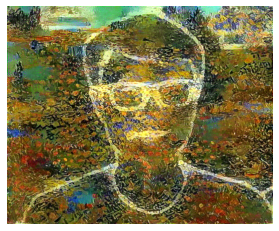

style_transfer     Step: 263ms    | Loss: 7.79e+06 | diff: 71.604%  | lr: 1.000e+00  | epoch: 6  ( 450/1000 )
content_loss 316.1312255859375 style_loss 7793291.0
style_transfer     Step: 249ms    | Loss: 7.79e+06 | diff: 71.611%  | lr: 1.000e+00  | epoch: 6  ( 460/1000 )
content_loss 316.12994384765625 style_loss 7790488.5
style_transfer     Step: 247ms    | Loss: 7.79e+06 | diff: 71.618%  | lr: 1.000e+00  | epoch: 6  ( 470/1000 )
content_loss 316.1397399902344 style_loss 7787823.5
style_transfer     Step: 247ms    | Loss: 7.79e+06 | diff: 71.623%  | lr: 1.000e+00  | epoch: 6  ( 480/1000 )
content_loss 316.1463623046875 style_loss 7785611.0
style_transfer     Step: 246ms    | Loss: 7.78e+06 | diff: 71.630%  | lr: 1.000e+00  | epoch: 6  ( 490/1000 )
content_loss 316.14520263671875 style_loss 7782939.0


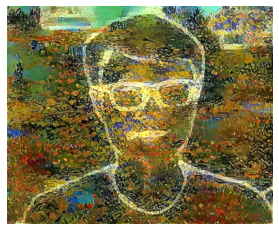

style_transfer     Step: 260ms    | Loss: 7.78e+06 | diff: 71.635%  | lr: 1.000e+00  | epoch: 6  ( 500/1000 )
content_loss 316.14556884765625 style_loss 7780217.0
style_transfer     Step: 247ms    | Loss: 7.78e+06 | diff: 71.641%  | lr: 1.000e+00  | epoch: 6  ( 510/1000 )
content_loss 316.15167236328125 style_loss 7777681.0
style_transfer     Step: 247ms    | Loss: 7.78e+06 | diff: 71.647%  | lr: 1.000e+00  | epoch: 6  ( 520/1000 )
content_loss 316.15435791015625 style_loss 7775347.5
style_transfer     Step: 259ms    | Loss: 7.77e+06 | diff: 71.654%  | lr: 1.000e+00  | epoch: 6  ( 530/1000 )
content_loss 316.1554870605469 style_loss 7772743.5
style_transfer     Step: 247ms    | Loss: 7.77e+06 | diff: 71.657%  | lr: 1.000e+00  | epoch: 6  ( 540/1000 )
content_loss 316.1529846191406 style_loss 7770506.0


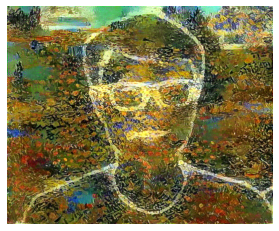

style_transfer     Step: 260ms    | Loss: 7.77e+06 | diff: 71.664%  | lr: 1.000e+00  | epoch: 6  ( 550/1000 )
content_loss 316.1509094238281 style_loss 7767945.5
style_transfer     Step: 247ms    | Loss: 7.77e+06 | diff: 71.670%  | lr: 1.000e+00  | epoch: 6  ( 560/1000 )
content_loss 316.1535339355469 style_loss 7765251.0
style_transfer     Step: 247ms    | Loss: 7.76e+06 | diff: 71.676%  | lr: 1.000e+00  | epoch: 6  ( 570/1000 )
content_loss 316.1505126953125 style_loss 7763031.0
style_transfer     Step: 246ms    | Loss: 7.76e+06 | diff: 71.682%  | lr: 1.000e+00  | epoch: 6  ( 580/1000 )
content_loss 316.1520080566406 style_loss 7760699.0
style_transfer     Step: 249ms    | Loss: 7.76e+06 | diff: 71.686%  | lr: 1.000e+00  | epoch: 6  ( 590/1000 )
content_loss 316.15252685546875 style_loss 7758316.5


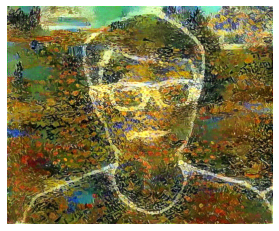

style_transfer     Step: 261ms    | Loss: 7.76e+06 | diff: 71.693%  | lr: 1.000e+00  | epoch: 6  ( 600/1000 )
content_loss 316.1547546386719 style_loss 7755873.0
style_transfer     Step: 247ms    | Loss: 7.75e+06 | diff: 71.698%  | lr: 1.000e+00  | epoch: 6  ( 610/1000 )
content_loss 316.1608581542969 style_loss 7753429.0
style_transfer     Step: 247ms    | Loss: 7.75e+06 | diff: 71.704%  | lr: 1.000e+00  | epoch: 6  ( 620/1000 )
content_loss 316.1617431640625 style_loss 7751051.5
style_transfer     Step: 258ms    | Loss: 7.75e+06 | diff: 71.708%  | lr: 1.000e+00  | epoch: 6  ( 630/1000 )
content_loss 316.16400146484375 style_loss 7748707.5
style_transfer     Step: 248ms    | Loss: 7.75e+06 | diff: 71.715%  | lr: 1.000e+00  | epoch: 6  ( 640/1000 )
content_loss 316.1612243652344 style_loss 7746318.0


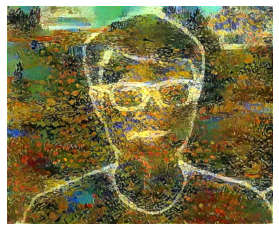

style_transfer     Step: 259ms    | Loss: 7.74e+06 | diff: 71.721%  | lr: 1.000e+00  | epoch: 6  ( 650/1000 )
content_loss 316.16497802734375 style_loss 7744002.0
style_transfer     Step: 247ms    | Loss: 7.74e+06 | diff: 71.726%  | lr: 1.000e+00  | epoch: 6  ( 660/1000 )
content_loss 316.1650390625 style_loss 7741600.5
style_transfer     Step: 247ms    | Loss: 7.74e+06 | diff: 71.732%  | lr: 1.000e+00  | epoch: 6  ( 670/1000 )
content_loss 316.17254638671875 style_loss 7739204.5
style_transfer     Step: 248ms    | Loss: 7.74e+06 | diff: 71.738%  | lr: 1.000e+00  | epoch: 6  ( 680/1000 )
content_loss 316.17047119140625 style_loss 7736658.0
style_transfer     Step: 248ms    | Loss: 7.73e+06 | diff: 71.743%  | lr: 1.000e+00  | epoch: 6  ( 690/1000 )
content_loss 316.16351318359375 style_loss 7734514.0


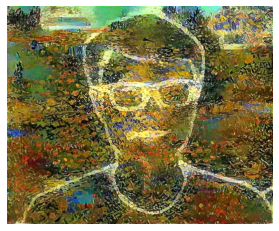

style_transfer     Step: 261ms    | Loss: 7.73e+06 | diff: 71.749%  | lr: 1.000e+00  | epoch: 6  ( 700/1000 )
content_loss 316.1641540527344 style_loss 7732028.0
style_transfer     Step: 247ms    | Loss: 7.73e+06 | diff: 71.755%  | lr: 1.000e+00  | epoch: 6  ( 710/1000 )
content_loss 316.164306640625 style_loss 7729398.5
style_transfer     Step: 247ms    | Loss: 7.73e+06 | diff: 71.761%  | lr: 1.000e+00  | epoch: 6  ( 720/1000 )
content_loss 316.1599426269531 style_loss 7727239.5
style_transfer     Step: 256ms    | Loss: 7.73e+06 | diff: 71.766%  | lr: 1.000e+00  | epoch: 6  ( 730/1000 )
content_loss 316.16510009765625 style_loss 7725033.0
style_transfer     Step: 247ms    | Loss: 7.72e+06 | diff: 71.771%  | lr: 1.000e+00  | epoch: 6  ( 740/1000 )
content_loss 316.1744384765625 style_loss 7722673.0


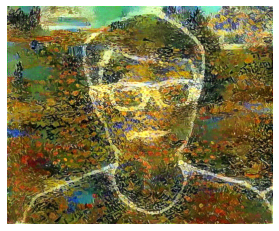

style_transfer     Step: 261ms    | Loss: 7.72e+06 | diff: 71.777%  | lr: 1.000e+00  | epoch: 6  ( 750/1000 )
content_loss 316.17510986328125 style_loss 7720384.5
style_transfer     Step: 247ms    | Loss: 7.72e+06 | diff: 71.784%  | lr: 1.000e+00  | epoch: 6  ( 760/1000 )
content_loss 316.1721496582031 style_loss 7717736.5
style_transfer     Step: 247ms    | Loss: 7.72e+06 | diff: 71.789%  | lr: 1.000e+00  | epoch: 6  ( 770/1000 )
content_loss 316.1768493652344 style_loss 7715373.5
style_transfer     Step: 248ms    | Loss: 7.71e+06 | diff: 71.795%  | lr: 1.000e+00  | epoch: 6  ( 780/1000 )
content_loss 316.1764221191406 style_loss 7712989.0
style_transfer     Step: 247ms    | Loss: 7.71e+06 | diff: 71.800%  | lr: 1.000e+00  | epoch: 6  ( 790/1000 )
content_loss 316.1813659667969 style_loss 7710736.0


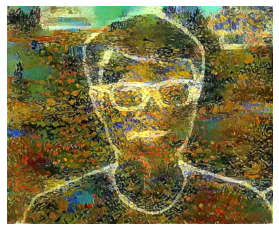

style_transfer     Step: 261ms    | Loss: 7.71e+06 | diff: 71.806%  | lr: 1.000e+00  | epoch: 6  ( 800/1000 )
content_loss 316.17816162109375 style_loss 7708498.0
style_transfer     Step: 247ms    | Loss: 7.71e+06 | diff: 71.812%  | lr: 1.000e+00  | epoch: 6  ( 810/1000 )
content_loss 316.1797180175781 style_loss 7706215.5
style_transfer     Step: 247ms    | Loss: 7.7e+06 | diff: 71.817%  | lr: 1.000e+00  | epoch: 6  ( 820/1000 )
content_loss 316.1765441894531 style_loss 7703948.0
style_transfer     Step: 258ms    | Loss: 7.7e+06 | diff: 71.823%  | lr: 1.000e+00  | epoch: 6  ( 830/1000 )
content_loss 316.1805419921875 style_loss 7701493.5
style_transfer     Step: 248ms    | Loss: 7.7e+06 | diff: 71.829%  | lr: 1.000e+00  | epoch: 6  ( 840/1000 )
content_loss 316.1783142089844 style_loss 7699033.5


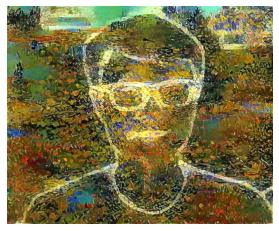

style_transfer     Step: 260ms    | Loss: 7.7e+06 | diff: 71.834%  | lr: 1.000e+00  | epoch: 6  ( 850/1000 )
content_loss 316.1822814941406 style_loss 7696651.5
style_transfer     Step: 247ms    | Loss: 7.69e+06 | diff: 71.839%  | lr: 1.000e+00  | epoch: 6  ( 860/1000 )
content_loss 316.1794128417969 style_loss 7694505.0
style_transfer     Step: 248ms    | Loss: 7.69e+06 | diff: 71.845%  | lr: 1.000e+00  | epoch: 6  ( 870/1000 )
content_loss 316.1841125488281 style_loss 7692287.0
style_transfer     Step: 247ms    | Loss: 7.69e+06 | diff: 71.851%  | lr: 1.000e+00  | epoch: 6  ( 880/1000 )
content_loss 316.1813659667969 style_loss 7689828.0
style_transfer     Step: 246ms    | Loss: 7.69e+06 | diff: 71.856%  | lr: 1.000e+00  | epoch: 6  ( 890/1000 )
content_loss 316.172607421875 style_loss 7687573.0


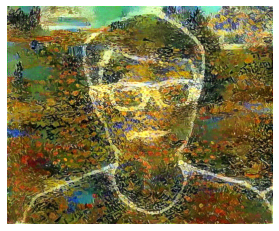

style_transfer     Step: 259ms    | Loss: 7.69e+06 | diff: 71.862%  | lr: 1.000e+00  | epoch: 6  ( 900/1000 )
content_loss 316.182373046875 style_loss 7685224.0
style_transfer     Step: 247ms    | Loss: 7.68e+06 | diff: 71.869%  | lr: 1.000e+00  | epoch: 6  ( 910/1000 )
content_loss 316.1804504394531 style_loss 7682805.5
style_transfer     Step: 256ms    | Loss: 7.68e+06 | diff: 71.874%  | lr: 1.000e+00  | epoch: 6  ( 920/1000 )
content_loss 316.1790466308594 style_loss 7680669.0
style_transfer     Step: 247ms    | Loss: 7.68e+06 | diff: 71.880%  | lr: 1.000e+00  | epoch: 6  ( 930/1000 )
content_loss 316.18280029296875 style_loss 7678260.0
style_transfer     Step: 246ms    | Loss: 7.68e+06 | diff: 71.884%  | lr: 1.000e+00  | epoch: 6  ( 940/1000 )
content_loss 316.1875915527344 style_loss 7676089.0


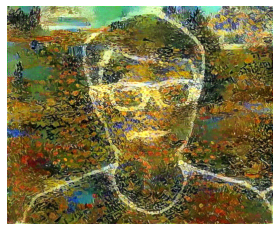

style_transfer     Step: 261ms    | Loss: 7.67e+06 | diff: 71.889%  | lr: 1.000e+00  | epoch: 6  ( 950/1000 )
content_loss 316.1851806640625 style_loss 7673936.0
style_transfer     Step: 247ms    | Loss: 7.67e+06 | diff: 71.895%  | lr: 1.000e+00  | epoch: 6  ( 960/1000 )
content_loss 316.1888427734375 style_loss 7671791.5
style_transfer     Step: 246ms    | Loss: 7.67e+06 | diff: 71.901%  | lr: 1.000e+00  | epoch: 6  ( 970/1000 )
content_loss 316.1844177246094 style_loss 7669290.0
style_transfer     Step: 247ms    | Loss: 7.67e+06 | diff: 71.905%  | lr: 1.000e+00  | epoch: 6  ( 980/1000 )
content_loss 316.1890563964844 style_loss 7667074.5
style_transfer     Step: 246ms    | Loss: 7.67e+06 | diff: 71.911%  | lr: 1.000e+00  | epoch: 6  ( 990/1000 )
content_loss 316.190673828125 style_loss 7664870.0


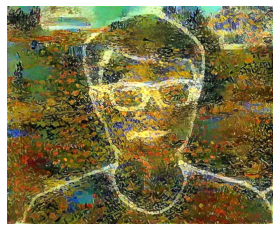

{ content_loss: 3.16e+02, style_loss: 7.66e+06, total_variation_norm_reg_Loss: 5.66, total_losses: 7.66e+06 }
content_loss 316.18878173828125 style_loss 7662847.5
style_transfer     Step: 461ms    | Loss: 7.66e+06 | diff: 71.922%  | lr: 1.000e+00  | epoch: 7  ( 10/1000 )
content_loss 316.1847229003906 style_loss 7660465.5
style_transfer     Step: 246ms    | Loss: 7.66e+06 | diff: 71.927%  | lr: 1.000e+00  | epoch: 7  ( 20/1000 )
content_loss 316.18695068359375 style_loss 7658393.0
style_transfer     Step: 247ms    | Loss: 7.66e+06 | diff: 71.933%  | lr: 1.000e+00  | epoch: 7  ( 30/1000 )
content_loss 316.18829345703125 style_loss 7656082.0
style_transfer     Step: 247ms    | Loss: 7.65e+06 | diff: 71.938%  | lr: 1.000e+00  | epoch: 7  ( 40/1000 )
content_loss 316.18939208984375 style_loss 7653661.5


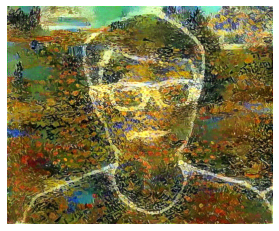

style_transfer     Step: 260ms    | Loss: 7.65e+06 | diff: 71.943%  | lr: 1.000e+00  | epoch: 7  ( 50/1000 )
content_loss 316.1929626464844 style_loss 7651716.5
style_transfer     Step: 247ms    | Loss: 7.65e+06 | diff: 71.949%  | lr: 1.000e+00  | epoch: 7  ( 60/1000 )
content_loss 316.1947326660156 style_loss 7649542.5
style_transfer     Step: 246ms    | Loss: 7.65e+06 | diff: 71.953%  | lr: 1.000e+00  | epoch: 7  ( 70/1000 )
content_loss 316.196533203125 style_loss 7647649.0
style_transfer     Step: 255ms    | Loss: 7.65e+06 | diff: 71.958%  | lr: 1.000e+00  | epoch: 7  ( 80/1000 )
content_loss 316.1944885253906 style_loss 7645630.5
style_transfer     Step: 247ms    | Loss: 7.64e+06 | diff: 71.964%  | lr: 1.000e+00  | epoch: 7  ( 90/1000 )
content_loss 316.1952209472656 style_loss 7643419.5


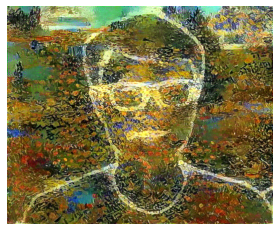

style_transfer     Step: 259ms    | Loss: 7.64e+06 | diff: 71.969%  | lr: 1.000e+00  | epoch: 7  ( 100/1000 )
content_loss 316.1968688964844 style_loss 7641166.5
style_transfer     Step: 248ms    | Loss: 7.64e+06 | diff: 71.974%  | lr: 1.000e+00  | epoch: 7  ( 110/1000 )
content_loss 316.19317626953125 style_loss 7639083.0
style_transfer     Step: 246ms    | Loss: 7.64e+06 | diff: 71.980%  | lr: 1.000e+00  | epoch: 7  ( 120/1000 )
content_loss 316.1917724609375 style_loss 7636832.5
style_transfer     Step: 247ms    | Loss: 7.64e+06 | diff: 71.986%  | lr: 1.000e+00  | epoch: 7  ( 130/1000 )
content_loss 316.1889953613281 style_loss 7634789.0
style_transfer     Step: 247ms    | Loss: 7.63e+06 | diff: 71.991%  | lr: 1.000e+00  | epoch: 7  ( 140/1000 )
content_loss 316.1867980957031 style_loss 7632611.0


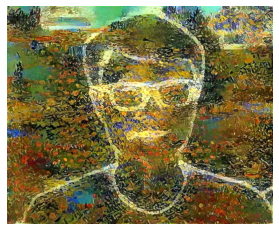

style_transfer     Step: 261ms    | Loss: 7.63e+06 | diff: 71.996%  | lr: 1.000e+00  | epoch: 7  ( 150/1000 )
content_loss 316.19000244140625 style_loss 7630510.5
style_transfer     Step: 248ms    | Loss: 7.63e+06 | diff: 72.001%  | lr: 1.000e+00  | epoch: 7  ( 160/1000 )
content_loss 316.19775390625 style_loss 7628473.0
style_transfer     Step: 247ms    | Loss: 7.63e+06 | diff: 72.008%  | lr: 1.000e+00  | epoch: 7  ( 170/1000 )
content_loss 316.1909484863281 style_loss 7626276.5
style_transfer     Step: 258ms    | Loss: 7.62e+06 | diff: 72.012%  | lr: 1.000e+00  | epoch: 7  ( 180/1000 )
content_loss 316.19085693359375 style_loss 7624218.0
style_transfer     Step: 247ms    | Loss: 7.62e+06 | diff: 72.017%  | lr: 1.000e+00  | epoch: 7  ( 190/1000 )
content_loss 316.1889953613281 style_loss 7622156.0


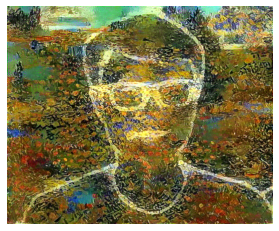

style_transfer     Step: 260ms    | Loss: 7.62e+06 | diff: 72.024%  | lr: 1.000e+00  | epoch: 7  ( 200/1000 )
content_loss 316.19281005859375 style_loss 7619733.5
style_transfer     Step: 248ms    | Loss: 7.62e+06 | diff: 72.028%  | lr: 1.000e+00  | epoch: 7  ( 210/1000 )
content_loss 316.19921875 style_loss 7617664.0
style_transfer     Step: 247ms    | Loss: 7.62e+06 | diff: 72.033%  | lr: 1.000e+00  | epoch: 7  ( 220/1000 )
content_loss 316.1920166015625 style_loss 7615748.0
style_transfer     Step: 247ms    | Loss: 7.61e+06 | diff: 72.039%  | lr: 1.000e+00  | epoch: 7  ( 230/1000 )
content_loss 316.19757080078125 style_loss 7613648.0
style_transfer     Step: 248ms    | Loss: 7.61e+06 | diff: 72.043%  | lr: 1.000e+00  | epoch: 7  ( 240/1000 )
content_loss 316.1991882324219 style_loss 7611545.5


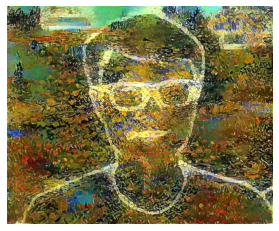

style_transfer     Step: 260ms    | Loss: 7.61e+06 | diff: 72.049%  | lr: 1.000e+00  | epoch: 7  ( 250/1000 )
content_loss 316.19775390625 style_loss 7609466.0
style_transfer     Step: 247ms    | Loss: 7.61e+06 | diff: 72.054%  | lr: 1.000e+00  | epoch: 7  ( 260/1000 )
content_loss 316.20526123046875 style_loss 7607509.0
style_transfer     Step: 247ms    | Loss: 7.61e+06 | diff: 72.058%  | lr: 1.000e+00  | epoch: 7  ( 270/1000 )
content_loss 316.2012023925781 style_loss 7605566.0
style_transfer     Step: 256ms    | Loss: 7.6e+06 | diff: 72.063%  | lr: 1.000e+00  | epoch: 7  ( 280/1000 )
content_loss 316.20062255859375 style_loss 7603686.0
style_transfer     Step: 246ms    | Loss: 7.6e+06 | diff: 72.067%  | lr: 1.000e+00  | epoch: 7  ( 290/1000 )
content_loss 316.2002258300781 style_loss 7601837.0


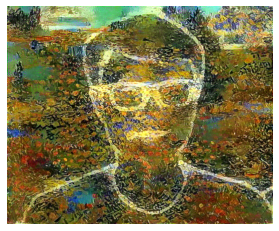

style_transfer     Step: 259ms    | Loss: 7.6e+06 | diff: 72.073%  | lr: 1.000e+00  | epoch: 7  ( 300/1000 )
content_loss 316.20526123046875 style_loss 7599705.0
style_transfer     Step: 246ms    | Loss: 7.6e+06 | diff: 72.078%  | lr: 1.000e+00  | epoch: 7  ( 310/1000 )
content_loss 316.205078125 style_loss 7597532.5
style_transfer     Step: 246ms    | Loss: 7.6e+06 | diff: 72.083%  | lr: 1.000e+00  | epoch: 7  ( 320/1000 )
content_loss 316.1981201171875 style_loss 7595613.5
style_transfer     Step: 246ms    | Loss: 7.59e+06 | diff: 72.090%  | lr: 1.000e+00  | epoch: 7  ( 330/1000 )
content_loss 316.20355224609375 style_loss 7593425.5
style_transfer     Step: 247ms    | Loss: 7.59e+06 | diff: 72.095%  | lr: 1.000e+00  | epoch: 7  ( 340/1000 )
content_loss 316.20556640625 style_loss 7591170.0


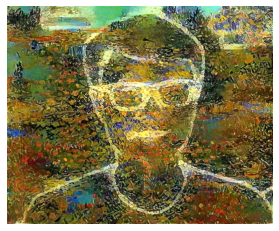

style_transfer     Step: 260ms    | Loss: 7.59e+06 | diff: 72.100%  | lr: 1.000e+00  | epoch: 7  ( 350/1000 )
content_loss 316.2063903808594 style_loss 7589105.5
style_transfer     Step: 247ms    | Loss: 7.59e+06 | diff: 72.106%  | lr: 1.000e+00  | epoch: 7  ( 360/1000 )
content_loss 316.2024841308594 style_loss 7587009.0
style_transfer     Step: 248ms    | Loss: 7.59e+06 | diff: 72.110%  | lr: 1.000e+00  | epoch: 7  ( 370/1000 )
content_loss 316.2050476074219 style_loss 7585057.0
style_transfer     Step: 257ms    | Loss: 7.58e+06 | diff: 72.115%  | lr: 1.000e+00  | epoch: 7  ( 380/1000 )
content_loss 316.2085266113281 style_loss 7582981.0
style_transfer     Step: 247ms    | Loss: 7.58e+06 | diff: 72.120%  | lr: 1.000e+00  | epoch: 7  ( 390/1000 )
content_loss 316.2105712890625 style_loss 7581118.0


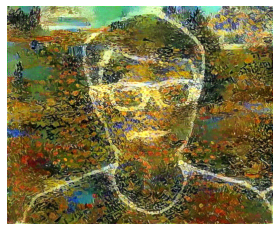

style_transfer     Step: 262ms    | Loss: 7.58e+06 | diff: 72.125%  | lr: 1.000e+00  | epoch: 7  ( 400/1000 )
content_loss 316.2041320800781 style_loss 7578957.5
style_transfer     Step: 247ms    | Loss: 7.58e+06 | diff: 72.131%  | lr: 1.000e+00  | epoch: 7  ( 410/1000 )
content_loss 316.2060852050781 style_loss 7576885.5
style_transfer     Step: 248ms    | Loss: 7.58e+06 | diff: 72.136%  | lr: 1.000e+00  | epoch: 7  ( 420/1000 )
content_loss 316.2147216796875 style_loss 7574951.0
style_transfer     Step: 248ms    | Loss: 7.57e+06 | diff: 72.141%  | lr: 1.000e+00  | epoch: 7  ( 430/1000 )
content_loss 316.21148681640625 style_loss 7572997.5
style_transfer     Step: 249ms    | Loss: 7.57e+06 | diff: 72.146%  | lr: 1.000e+00  | epoch: 7  ( 440/1000 )
content_loss 316.2123107910156 style_loss 7570950.0


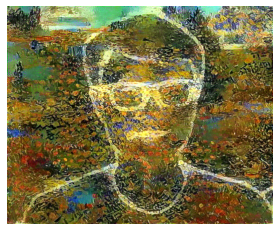

style_transfer     Step: 263ms    | Loss: 7.57e+06 | diff: 72.151%  | lr: 1.000e+00  | epoch: 7  ( 450/1000 )
content_loss 316.2158203125 style_loss 7568782.0
style_transfer     Step: 248ms    | Loss: 7.57e+06 | diff: 72.156%  | lr: 1.000e+00  | epoch: 7  ( 460/1000 )
content_loss 316.2128601074219 style_loss 7566762.5
style_transfer     Step: 248ms    | Loss: 7.57e+06 | diff: 72.161%  | lr: 1.000e+00  | epoch: 7  ( 470/1000 )
content_loss 316.21478271484375 style_loss 7564793.0
style_transfer     Step: 258ms    | Loss: 7.56e+06 | diff: 72.165%  | lr: 1.000e+00  | epoch: 7  ( 480/1000 )
content_loss 316.22259521484375 style_loss 7563051.5
style_transfer     Step: 248ms    | Loss: 7.56e+06 | diff: 72.170%  | lr: 1.000e+00  | epoch: 7  ( 490/1000 )
content_loss 316.2222900390625 style_loss 7561358.5


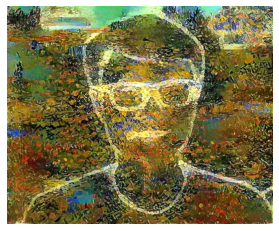

style_transfer     Step: 262ms    | Loss: 7.56e+06 | diff: 72.174%  | lr: 1.000e+00  | epoch: 7  ( 500/1000 )
content_loss 316.22265625 style_loss 7559367.0
style_transfer     Step: 251ms    | Loss: 7.56e+06 | diff: 72.180%  | lr: 1.000e+00  | epoch: 7  ( 510/1000 )
content_loss 316.2235107421875 style_loss 7557226.5
style_transfer     Step: 248ms    | Loss: 7.56e+06 | diff: 72.184%  | lr: 1.000e+00  | epoch: 7  ( 520/1000 )
content_loss 316.2228698730469 style_loss 7555286.0
style_transfer     Step: 248ms    | Loss: 7.55e+06 | diff: 72.189%  | lr: 1.000e+00  | epoch: 7  ( 530/1000 )
content_loss 316.2307434082031 style_loss 7553354.5
style_transfer     Step: 248ms    | Loss: 7.55e+06 | diff: 72.195%  | lr: 1.000e+00  | epoch: 7  ( 540/1000 )
content_loss 316.2318115234375 style_loss 7551252.0


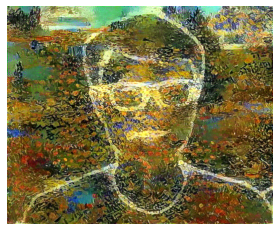

style_transfer     Step: 261ms    | Loss: 7.55e+06 | diff: 72.200%  | lr: 1.000e+00  | epoch: 7  ( 550/1000 )
content_loss 316.2332458496094 style_loss 7549258.5
style_transfer     Step: 248ms    | Loss: 7.55e+06 | diff: 72.204%  | lr: 1.000e+00  | epoch: 7  ( 560/1000 )
content_loss 316.24169921875 style_loss 7547311.0
style_transfer     Step: 248ms    | Loss: 7.55e+06 | diff: 72.209%  | lr: 1.000e+00  | epoch: 7  ( 570/1000 )
content_loss 316.2412109375 style_loss 7545317.5
style_transfer     Step: 259ms    | Loss: 7.54e+06 | diff: 72.213%  | lr: 1.000e+00  | epoch: 7  ( 580/1000 )
content_loss 316.2424621582031 style_loss 7543562.5
style_transfer     Step: 247ms    | Loss: 7.54e+06 | diff: 72.218%  | lr: 1.000e+00  | epoch: 7  ( 590/1000 )
content_loss 316.2438049316406 style_loss 7541865.5


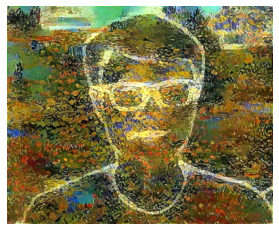

style_transfer     Step: 263ms    | Loss: 7.54e+06 | diff: 72.223%  | lr: 1.000e+00  | epoch: 7  ( 600/1000 )
content_loss 316.2461853027344 style_loss 7540025.5
style_transfer     Step: 249ms    | Loss: 7.54e+06 | diff: 72.228%  | lr: 1.000e+00  | epoch: 7  ( 610/1000 )
content_loss 316.250244140625 style_loss 7538100.5
style_transfer     Step: 248ms    | Loss: 7.54e+06 | diff: 72.232%  | lr: 1.000e+00  | epoch: 7  ( 620/1000 )
content_loss 316.2508239746094 style_loss 7536216.5
style_transfer     Step: 247ms    | Loss: 7.53e+06 | diff: 72.238%  | lr: 1.000e+00  | epoch: 7  ( 630/1000 )
content_loss 316.2491455078125 style_loss 7534281.5
style_transfer     Step: 248ms    | Loss: 7.53e+06 | diff: 72.242%  | lr: 1.000e+00  | epoch: 7  ( 640/1000 )
content_loss 316.2505187988281 style_loss 7532503.0


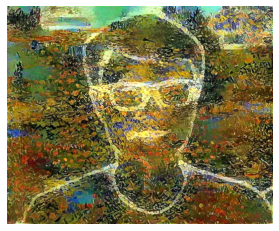

style_transfer     Step: 261ms    | Loss: 7.53e+06 | diff: 72.247%  | lr: 1.000e+00  | epoch: 7  ( 650/1000 )
content_loss 316.2607727050781 style_loss 7530508.0
style_transfer     Step: 248ms    | Loss: 7.53e+06 | diff: 72.251%  | lr: 1.000e+00  | epoch: 7  ( 660/1000 )
content_loss 316.2612609863281 style_loss 7528820.0
style_transfer     Step: 257ms    | Loss: 7.53e+06 | diff: 72.257%  | lr: 1.000e+00  | epoch: 7  ( 670/1000 )
content_loss 316.2646789550781 style_loss 7526888.5
style_transfer     Step: 247ms    | Loss: 7.53e+06 | diff: 72.262%  | lr: 1.000e+00  | epoch: 7  ( 680/1000 )
content_loss 316.2633972167969 style_loss 7525148.0
style_transfer     Step: 248ms    | Loss: 7.52e+06 | diff: 72.265%  | lr: 1.000e+00  | epoch: 7  ( 690/1000 )
content_loss 316.26422119140625 style_loss 7523351.0


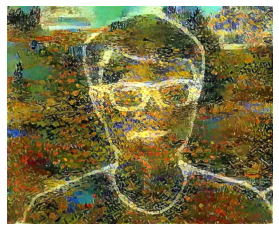

style_transfer     Step: 261ms    | Loss: 7.52e+06 | diff: 72.270%  | lr: 1.000e+00  | epoch: 7  ( 700/1000 )
content_loss 316.2630615234375 style_loss 7521610.0
style_transfer     Step: 248ms    | Loss: 7.52e+06 | diff: 72.274%  | lr: 1.000e+00  | epoch: 7  ( 710/1000 )
content_loss 316.26422119140625 style_loss 7519775.5
style_transfer     Step: 248ms    | Loss: 7.52e+06 | diff: 72.279%  | lr: 1.000e+00  | epoch: 7  ( 720/1000 )
content_loss 316.2652893066406 style_loss 7517824.0
style_transfer     Step: 268ms    | Loss: 7.52e+06 | diff: 72.284%  | lr: 1.000e+00  | epoch: 7  ( 730/1000 )
content_loss 316.2691955566406 style_loss 7515847.5
style_transfer     Step: 259ms    | Loss: 7.51e+06 | diff: 72.288%  | lr: 1.000e+00  | epoch: 7  ( 740/1000 )
content_loss 316.2677001953125 style_loss 7514135.5


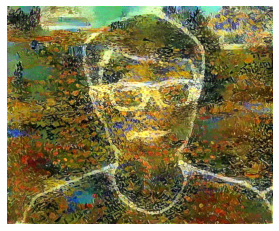

style_transfer     Step: 271ms    | Loss: 7.51e+06 | diff: 72.293%  | lr: 1.000e+00  | epoch: 7  ( 750/1000 )
content_loss 316.26885986328125 style_loss 7512241.5
style_transfer     Step: 247ms    | Loss: 7.51e+06 | diff: 72.298%  | lr: 1.000e+00  | epoch: 7  ( 760/1000 )
content_loss 316.27001953125 style_loss 7510449.5
style_transfer     Step: 248ms    | Loss: 7.51e+06 | diff: 72.302%  | lr: 1.000e+00  | epoch: 7  ( 770/1000 )
content_loss 316.27362060546875 style_loss 7508518.0
style_transfer     Step: 247ms    | Loss: 7.51e+06 | diff: 72.306%  | lr: 1.000e+00  | epoch: 7  ( 780/1000 )
content_loss 316.2738952636719 style_loss 7506904.5
style_transfer     Step: 248ms    | Loss: 7.51e+06 | diff: 72.311%  | lr: 1.000e+00  | epoch: 7  ( 790/1000 )
content_loss 316.2816467285156 style_loss 7505274.0


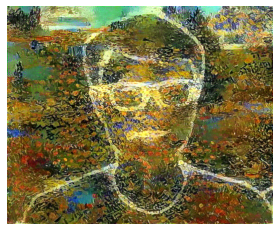

style_transfer     Step: 261ms    | Loss: 7.5e+06 | diff: 72.314%  | lr: 1.000e+00  | epoch: 7  ( 800/1000 )
content_loss 316.283447265625 style_loss 7503926.0
style_transfer     Step: 247ms    | Loss: 7.5e+06 | diff: 72.319%  | lr: 1.000e+00  | epoch: 7  ( 810/1000 )
content_loss 316.2789306640625 style_loss 7502049.0
style_transfer     Step: 248ms    | Loss: 7.5e+06 | diff: 72.323%  | lr: 1.000e+00  | epoch: 7  ( 820/1000 )
content_loss 316.2835388183594 style_loss 7500240.0
style_transfer     Step: 248ms    | Loss: 7.5e+06 | diff: 72.328%  | lr: 1.000e+00  | epoch: 7  ( 830/1000 )
content_loss 316.28656005859375 style_loss 7498369.0
style_transfer     Step: 248ms    | Loss: 7.5e+06 | diff: 72.332%  | lr: 1.000e+00  | epoch: 7  ( 840/1000 )
content_loss 316.2862548828125 style_loss 7496697.0


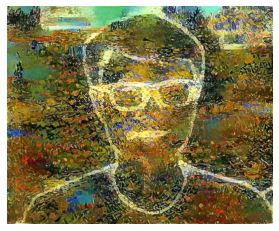

style_transfer     Step: 260ms    | Loss: 7.5e+06 | diff: 72.336%  | lr: 1.000e+00  | epoch: 7  ( 850/1000 )
content_loss 316.2882385253906 style_loss 7494882.5
style_transfer     Step: 248ms    | Loss: 7.49e+06 | diff: 72.341%  | lr: 1.000e+00  | epoch: 7  ( 860/1000 )
content_loss 316.2864990234375 style_loss 7493104.5
style_transfer     Step: 247ms    | Loss: 7.49e+06 | diff: 72.345%  | lr: 1.000e+00  | epoch: 7  ( 870/1000 )
content_loss 316.29150390625 style_loss 7491259.0
style_transfer     Step: 248ms    | Loss: 7.49e+06 | diff: 72.350%  | lr: 1.000e+00  | epoch: 7  ( 880/1000 )
content_loss 316.2900085449219 style_loss 7489488.5
style_transfer     Step: 258ms    | Loss: 7.49e+06 | diff: 72.354%  | lr: 1.000e+00  | epoch: 7  ( 890/1000 )
content_loss 316.2867736816406 style_loss 7487614.5


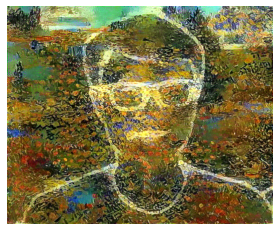

style_transfer     Step: 261ms    | Loss: 7.49e+06 | diff: 72.359%  | lr: 1.000e+00  | epoch: 7  ( 900/1000 )
content_loss 316.291748046875 style_loss 7485889.0
style_transfer     Step: 248ms    | Loss: 7.48e+06 | diff: 72.364%  | lr: 1.000e+00  | epoch: 7  ( 910/1000 )
content_loss 316.2938537597656 style_loss 7484079.5
style_transfer     Step: 248ms    | Loss: 7.48e+06 | diff: 72.369%  | lr: 1.000e+00  | epoch: 7  ( 920/1000 )
content_loss 316.2962951660156 style_loss 7482279.0
style_transfer     Step: 248ms    | Loss: 7.48e+06 | diff: 72.373%  | lr: 1.000e+00  | epoch: 7  ( 930/1000 )
content_loss 316.2985534667969 style_loss 7480602.5
style_transfer     Step: 248ms    | Loss: 7.48e+06 | diff: 72.377%  | lr: 1.000e+00  | epoch: 7  ( 940/1000 )
content_loss 316.30548095703125 style_loss 7478827.0


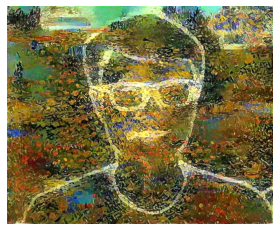

style_transfer     Step: 262ms    | Loss: 7.48e+06 | diff: 72.381%  | lr: 1.000e+00  | epoch: 7  ( 950/1000 )
content_loss 316.3021240234375 style_loss 7477084.0
style_transfer     Step: 248ms    | Loss: 7.48e+06 | diff: 72.385%  | lr: 1.000e+00  | epoch: 7  ( 960/1000 )
content_loss 316.30267333984375 style_loss 7475215.5
style_transfer     Step: 248ms    | Loss: 7.47e+06 | diff: 72.390%  | lr: 1.000e+00  | epoch: 7  ( 970/1000 )
content_loss 316.3045349121094 style_loss 7473385.5
style_transfer     Step: 248ms    | Loss: 7.47e+06 | diff: 72.395%  | lr: 1.000e+00  | epoch: 7  ( 980/1000 )
content_loss 316.3001708984375 style_loss 7471473.0
style_transfer     Step: 248ms    | Loss: 7.47e+06 | diff: 72.399%  | lr: 1.000e+00  | epoch: 7  ( 990/1000 )
content_loss 316.3035888671875 style_loss 7469719.0


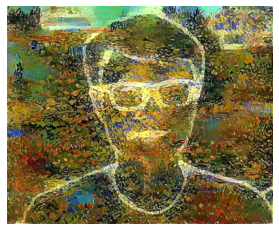

{ content_loss: 3.16e+02, style_loss: 7.47e+06, total_variation_norm_reg_Loss: 5.75, total_losses: 7.47e+06 }
content_loss 316.3072509765625 style_loss 7467970.5
style_transfer     Step: 464ms    | Loss: 7.47e+06 | diff: 72.409%  | lr: 1.000e+00  | epoch: 8  ( 10/1000 )
content_loss 316.3057556152344 style_loss 7466326.5
style_transfer     Step: 266ms    | Loss: 7.47e+06 | diff: 72.412%  | lr: 1.000e+00  | epoch: 8  ( 20/1000 )
content_loss 316.3089294433594 style_loss 7464807.0
style_transfer     Step: 263ms    | Loss: 7.46e+06 | diff: 72.416%  | lr: 1.000e+00  | epoch: 8  ( 30/1000 )
content_loss 316.3021240234375 style_loss 7463174.5
style_transfer     Step: 248ms    | Loss: 7.46e+06 | diff: 72.421%  | lr: 1.000e+00  | epoch: 8  ( 40/1000 )
content_loss 316.3017272949219 style_loss 7461238.5


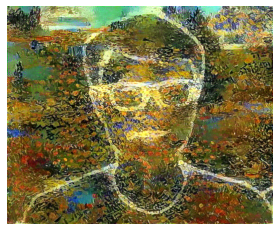

style_transfer     Step: 261ms    | Loss: 7.46e+06 | diff: 72.424%  | lr: 1.000e+00  | epoch: 8  ( 50/1000 )
content_loss 316.3046569824219 style_loss 7459583.0
style_transfer     Step: 248ms    | Loss: 7.46e+06 | diff: 72.429%  | lr: 1.000e+00  | epoch: 8  ( 60/1000 )
content_loss 316.3039855957031 style_loss 7457828.5
style_transfer     Step: 248ms    | Loss: 7.46e+06 | diff: 72.433%  | lr: 1.000e+00  | epoch: 8  ( 70/1000 )
content_loss 316.31201171875 style_loss 7456428.0
style_transfer     Step: 249ms    | Loss: 7.45e+06 | diff: 72.438%  | lr: 1.000e+00  | epoch: 8  ( 80/1000 )
content_loss 316.3046569824219 style_loss 7454384.0
style_transfer     Step: 248ms    | Loss: 7.45e+06 | diff: 72.442%  | lr: 1.000e+00  | epoch: 8  ( 90/1000 )
content_loss 316.30426025390625 style_loss 7452672.0


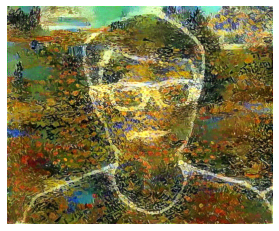

style_transfer     Step: 261ms    | Loss: 7.45e+06 | diff: 72.445%  | lr: 1.000e+00  | epoch: 8  ( 100/1000 )
content_loss 316.29962158203125 style_loss 7451315.0
style_transfer     Step: 249ms    | Loss: 7.45e+06 | diff: 72.449%  | lr: 1.000e+00  | epoch: 8  ( 110/1000 )
content_loss 316.2991943359375 style_loss 7449587.0
style_transfer     Step: 247ms    | Loss: 7.45e+06 | diff: 72.454%  | lr: 1.000e+00  | epoch: 8  ( 120/1000 )
content_loss 316.3040771484375 style_loss 7448006.0
style_transfer     Step: 249ms    | Loss: 7.45e+06 | diff: 72.458%  | lr: 1.000e+00  | epoch: 8  ( 130/1000 )
content_loss 316.307861328125 style_loss 7446316.5
style_transfer     Step: 248ms    | Loss: 7.44e+06 | diff: 72.463%  | lr: 1.000e+00  | epoch: 8  ( 140/1000 )
content_loss 316.3074035644531 style_loss 7444551.5


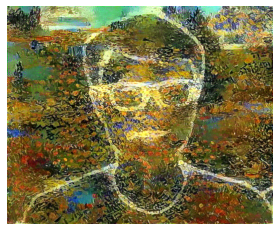

style_transfer     Step: 263ms    | Loss: 7.44e+06 | diff: 72.466%  | lr: 1.000e+00  | epoch: 8  ( 150/1000 )
content_loss 316.31024169921875 style_loss 7442970.0
style_transfer     Step: 249ms    | Loss: 7.44e+06 | diff: 72.471%  | lr: 1.000e+00  | epoch: 8  ( 160/1000 )
content_loss 316.3125915527344 style_loss 7441288.5
style_transfer     Step: 248ms    | Loss: 7.44e+06 | diff: 72.475%  | lr: 1.000e+00  | epoch: 8  ( 170/1000 )
content_loss 316.3154602050781 style_loss 7439459.5
style_transfer     Step: 249ms    | Loss: 7.44e+06 | diff: 72.480%  | lr: 1.000e+00  | epoch: 8  ( 180/1000 )
content_loss 316.31060791015625 style_loss 7437650.0
style_transfer     Step: 248ms    | Loss: 7.44e+06 | diff: 72.484%  | lr: 1.000e+00  | epoch: 8  ( 190/1000 )
content_loss 316.3120422363281 style_loss 7435902.0


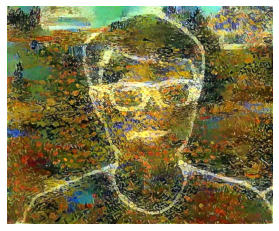

style_transfer     Step: 261ms    | Loss: 7.43e+06 | diff: 72.488%  | lr: 1.000e+00  | epoch: 8  ( 200/1000 )
content_loss 316.31146240234375 style_loss 7434386.5
style_transfer     Step: 249ms    | Loss: 7.43e+06 | diff: 72.492%  | lr: 1.000e+00  | epoch: 8  ( 210/1000 )
content_loss 316.31341552734375 style_loss 7432792.0
style_transfer     Step: 248ms    | Loss: 7.43e+06 | diff: 72.496%  | lr: 1.000e+00  | epoch: 8  ( 220/1000 )
content_loss 316.3121337890625 style_loss 7431157.0
style_transfer     Step: 249ms    | Loss: 7.43e+06 | diff: 72.500%  | lr: 1.000e+00  | epoch: 8  ( 230/1000 )
content_loss 316.3097839355469 style_loss 7429574.5
style_transfer     Step: 248ms    | Loss: 7.43e+06 | diff: 72.505%  | lr: 1.000e+00  | epoch: 8  ( 240/1000 )
content_loss 316.3115234375 style_loss 7427863.5


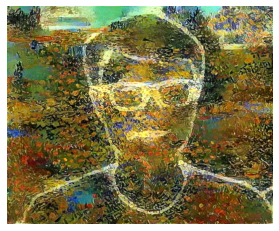

style_transfer     Step: 261ms    | Loss: 7.43e+06 | diff: 72.508%  | lr: 1.000e+00  | epoch: 8  ( 250/1000 )
content_loss 316.31353759765625 style_loss 7426329.5
style_transfer     Step: 249ms    | Loss: 7.43e+06 | diff: 72.513%  | lr: 1.000e+00  | epoch: 8  ( 260/1000 )
content_loss 316.31207275390625 style_loss 7424725.5
style_transfer     Step: 248ms    | Loss: 7.42e+06 | diff: 72.517%  | lr: 1.000e+00  | epoch: 8  ( 270/1000 )
content_loss 316.3158874511719 style_loss 7423085.0
style_transfer     Step: 248ms    | Loss: 7.42e+06 | diff: 72.521%  | lr: 1.000e+00  | epoch: 8  ( 280/1000 )
content_loss 316.32208251953125 style_loss 7421516.0
style_transfer     Step: 248ms    | Loss: 7.42e+06 | diff: 72.526%  | lr: 1.000e+00  | epoch: 8  ( 290/1000 )
content_loss 316.3194274902344 style_loss 7419658.5


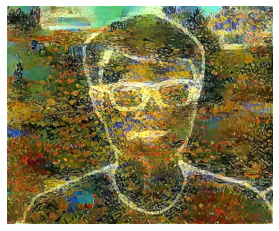

style_transfer     Step: 262ms    | Loss: 7.42e+06 | diff: 72.529%  | lr: 1.000e+00  | epoch: 8  ( 300/1000 )
content_loss 316.3215026855469 style_loss 7418066.5
style_transfer     Step: 248ms    | Loss: 7.42e+06 | diff: 72.534%  | lr: 1.000e+00  | epoch: 8  ( 310/1000 )
content_loss 316.32281494140625 style_loss 7416244.0
style_transfer     Step: 248ms    | Loss: 7.41e+06 | diff: 72.539%  | lr: 1.000e+00  | epoch: 8  ( 320/1000 )
content_loss 316.32391357421875 style_loss 7414663.5
style_transfer     Step: 257ms    | Loss: 7.41e+06 | diff: 72.543%  | lr: 1.000e+00  | epoch: 8  ( 330/1000 )
content_loss 316.32220458984375 style_loss 7412957.5
style_transfer     Step: 247ms    | Loss: 7.41e+06 | diff: 72.547%  | lr: 1.000e+00  | epoch: 8  ( 340/1000 )
content_loss 316.3243408203125 style_loss 7411350.5


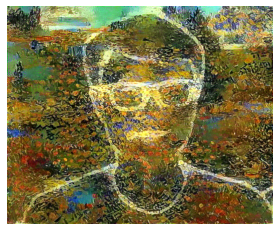

style_transfer     Step: 261ms    | Loss: 7.41e+06 | diff: 72.551%  | lr: 1.000e+00  | epoch: 8  ( 350/1000 )
content_loss 316.3244934082031 style_loss 7409765.5
style_transfer     Step: 247ms    | Loss: 7.41e+06 | diff: 72.555%  | lr: 1.000e+00  | epoch: 8  ( 360/1000 )
content_loss 316.3250427246094 style_loss 7408098.0
style_transfer     Step: 247ms    | Loss: 7.41e+06 | diff: 72.560%  | lr: 1.000e+00  | epoch: 8  ( 370/1000 )
content_loss 316.32550048828125 style_loss 7406493.5
style_transfer     Step: 248ms    | Loss: 7.41e+06 | diff: 72.564%  | lr: 1.000e+00  | epoch: 8  ( 380/1000 )
content_loss 316.32666015625 style_loss 7404879.5
style_transfer     Step: 248ms    | Loss: 7.4e+06 | diff: 72.568%  | lr: 1.000e+00  | epoch: 8  ( 390/1000 )
content_loss 316.32244873046875 style_loss 7403293.5


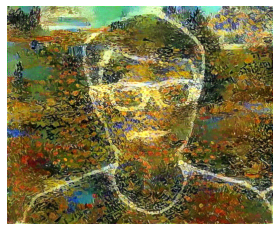

style_transfer     Step: 261ms    | Loss: 7.4e+06 | diff: 72.572%  | lr: 1.000e+00  | epoch: 8  ( 400/1000 )
content_loss 316.3255615234375 style_loss 7401667.0
style_transfer     Step: 248ms    | Loss: 7.4e+06 | diff: 72.577%  | lr: 1.000e+00  | epoch: 8  ( 410/1000 )
content_loss 316.32611083984375 style_loss 7399934.5
style_transfer     Step: 258ms    | Loss: 7.4e+06 | diff: 72.581%  | lr: 1.000e+00  | epoch: 8  ( 420/1000 )
content_loss 316.324951171875 style_loss 7398356.0
style_transfer     Step: 248ms    | Loss: 7.4e+06 | diff: 72.586%  | lr: 1.000e+00  | epoch: 8  ( 430/1000 )
content_loss 316.328369140625 style_loss 7396751.0
style_transfer     Step: 249ms    | Loss: 7.4e+06 | diff: 72.590%  | lr: 1.000e+00  | epoch: 8  ( 440/1000 )
content_loss 316.3289489746094 style_loss 7395118.0


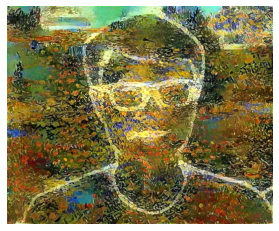

style_transfer     Step: 261ms    | Loss: 7.39e+06 | diff: 72.594%  | lr: 1.000e+00  | epoch: 8  ( 450/1000 )
content_loss 316.33343505859375 style_loss 7393506.5
style_transfer     Step: 249ms    | Loss: 7.39e+06 | diff: 72.598%  | lr: 1.000e+00  | epoch: 8  ( 460/1000 )
content_loss 316.3345642089844 style_loss 7391912.5
style_transfer     Step: 258ms    | Loss: 7.39e+06 | diff: 72.602%  | lr: 1.000e+00  | epoch: 8  ( 470/1000 )
content_loss 316.3360290527344 style_loss 7390410.5
style_transfer     Step: 248ms    | Loss: 7.39e+06 | diff: 72.606%  | lr: 1.000e+00  | epoch: 8  ( 480/1000 )
content_loss 316.3362121582031 style_loss 7388814.5
style_transfer     Step: 249ms    | Loss: 7.39e+06 | diff: 72.610%  | lr: 1.000e+00  | epoch: 8  ( 490/1000 )
content_loss 316.33856201171875 style_loss 7387242.0


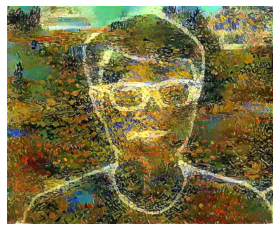

style_transfer     Step: 262ms    | Loss: 7.39e+06 | diff: 72.614%  | lr: 1.000e+00  | epoch: 8  ( 500/1000 )
content_loss 316.34149169921875 style_loss 7385640.5
style_transfer     Step: 250ms    | Loss: 7.38e+06 | diff: 72.618%  | lr: 1.000e+00  | epoch: 8  ( 510/1000 )
content_loss 316.3391418457031 style_loss 7384219.0
style_transfer     Step: 258ms    | Loss: 7.38e+06 | diff: 72.622%  | lr: 1.000e+00  | epoch: 8  ( 520/1000 )
content_loss 316.3417053222656 style_loss 7382688.0
style_transfer     Step: 248ms    | Loss: 7.38e+06 | diff: 72.626%  | lr: 1.000e+00  | epoch: 8  ( 530/1000 )
content_loss 316.34307861328125 style_loss 7381229.0
style_transfer     Step: 248ms    | Loss: 7.38e+06 | diff: 72.630%  | lr: 1.000e+00  | epoch: 8  ( 540/1000 )
content_loss 316.34442138671875 style_loss 7379753.0


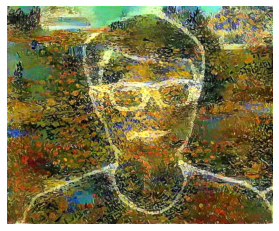

style_transfer     Step: 262ms    | Loss: 7.38e+06 | diff: 72.634%  | lr: 1.000e+00  | epoch: 8  ( 550/1000 )
content_loss 316.34588623046875 style_loss 7378336.5
style_transfer     Step: 249ms    | Loss: 7.38e+06 | diff: 72.638%  | lr: 1.000e+00  | epoch: 8  ( 560/1000 )
content_loss 316.3450927734375 style_loss 7376694.5
style_transfer     Step: 258ms    | Loss: 7.38e+06 | diff: 72.642%  | lr: 1.000e+00  | epoch: 8  ( 570/1000 )
content_loss 316.3477783203125 style_loss 7375314.0
style_transfer     Step: 249ms    | Loss: 7.37e+06 | diff: 72.645%  | lr: 1.000e+00  | epoch: 8  ( 580/1000 )
content_loss 316.3492126464844 style_loss 7373967.5
style_transfer     Step: 249ms    | Loss: 7.37e+06 | diff: 72.649%  | lr: 1.000e+00  | epoch: 8  ( 590/1000 )
content_loss 316.34942626953125 style_loss 7372435.5


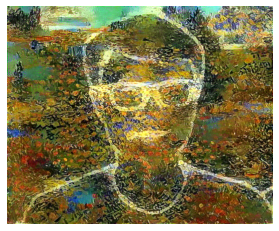

style_transfer     Step: 293ms    | Loss: 7.37e+06 | diff: 72.653%  | lr: 1.000e+00  | epoch: 8  ( 600/1000 )
content_loss 316.346435546875 style_loss 7370797.0
style_transfer     Step: 267ms    | Loss: 7.37e+06 | diff: 72.657%  | lr: 1.000e+00  | epoch: 8  ( 610/1000 )
content_loss 316.3485107421875 style_loss 7369468.5
style_transfer     Step: 258ms    | Loss: 7.37e+06 | diff: 72.661%  | lr: 1.000e+00  | epoch: 8  ( 620/1000 )
content_loss 316.3481750488281 style_loss 7368112.5
style_transfer     Step: 249ms    | Loss: 7.37e+06 | diff: 72.665%  | lr: 1.000e+00  | epoch: 8  ( 630/1000 )
content_loss 316.3467102050781 style_loss 7366469.5
style_transfer     Step: 248ms    | Loss: 7.37e+06 | diff: 72.670%  | lr: 1.000e+00  | epoch: 8  ( 640/1000 )
content_loss 316.3482971191406 style_loss 7364943.0


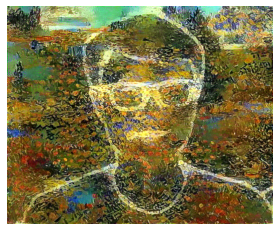

style_transfer     Step: 262ms    | Loss: 7.36e+06 | diff: 72.673%  | lr: 1.000e+00  | epoch: 8  ( 650/1000 )
content_loss 316.3546142578125 style_loss 7363452.5
style_transfer     Step: 249ms    | Loss: 7.36e+06 | diff: 72.678%  | lr: 1.000e+00  | epoch: 8  ( 660/1000 )
content_loss 316.3511657714844 style_loss 7361894.0
style_transfer     Step: 258ms    | Loss: 7.36e+06 | diff: 72.682%  | lr: 1.000e+00  | epoch: 8  ( 670/1000 )
content_loss 316.3558349609375 style_loss 7360421.0
style_transfer     Step: 249ms    | Loss: 7.36e+06 | diff: 72.686%  | lr: 1.000e+00  | epoch: 8  ( 680/1000 )
content_loss 316.3587646484375 style_loss 7358846.0
style_transfer     Step: 248ms    | Loss: 7.36e+06 | diff: 72.689%  | lr: 1.000e+00  | epoch: 8  ( 690/1000 )
content_loss 316.3611145019531 style_loss 7357516.0


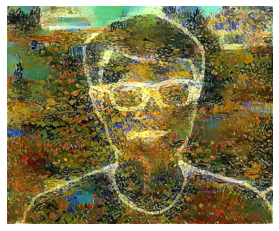

style_transfer     Step: 261ms    | Loss: 7.36e+06 | diff: 72.694%  | lr: 1.000e+00  | epoch: 8  ( 700/1000 )
content_loss 316.3606262207031 style_loss 7356135.5
style_transfer     Step: 248ms    | Loss: 7.35e+06 | diff: 72.697%  | lr: 1.000e+00  | epoch: 8  ( 710/1000 )
content_loss 316.36309814453125 style_loss 7354616.0
style_transfer     Step: 257ms    | Loss: 7.35e+06 | diff: 72.701%  | lr: 1.000e+00  | epoch: 8  ( 720/1000 )
content_loss 316.3651123046875 style_loss 7353219.5
style_transfer     Step: 248ms    | Loss: 7.35e+06 | diff: 72.705%  | lr: 1.000e+00  | epoch: 8  ( 730/1000 )
content_loss 316.36309814453125 style_loss 7351682.0
style_transfer     Step: 247ms    | Loss: 7.35e+06 | diff: 72.709%  | lr: 1.000e+00  | epoch: 8  ( 740/1000 )
content_loss 316.36419677734375 style_loss 7350358.0


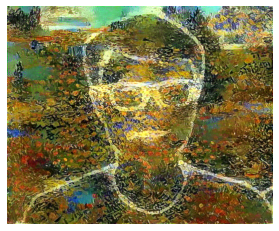

style_transfer     Step: 262ms    | Loss: 7.35e+06 | diff: 72.713%  | lr: 1.000e+00  | epoch: 8  ( 750/1000 )
content_loss 316.3674621582031 style_loss 7348885.5
style_transfer     Step: 249ms    | Loss: 7.35e+06 | diff: 72.716%  | lr: 1.000e+00  | epoch: 8  ( 760/1000 )
content_loss 316.3676452636719 style_loss 7347421.5
style_transfer     Step: 259ms    | Loss: 7.35e+06 | diff: 72.721%  | lr: 1.000e+00  | epoch: 8  ( 770/1000 )
content_loss 316.37164306640625 style_loss 7345932.0
style_transfer     Step: 249ms    | Loss: 7.34e+06 | diff: 72.725%  | lr: 1.000e+00  | epoch: 8  ( 780/1000 )
content_loss 316.37152099609375 style_loss 7344492.0
style_transfer     Step: 248ms    | Loss: 7.34e+06 | diff: 72.729%  | lr: 1.000e+00  | epoch: 8  ( 790/1000 )
content_loss 316.3697509765625 style_loss 7342953.5


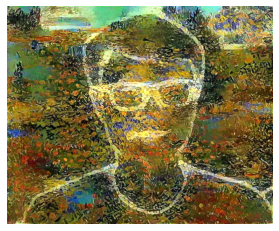

style_transfer     Step: 262ms    | Loss: 7.34e+06 | diff: 72.732%  | lr: 1.000e+00  | epoch: 8  ( 800/1000 )
content_loss 316.3663024902344 style_loss 7341478.0
style_transfer     Step: 248ms    | Loss: 7.34e+06 | diff: 72.736%  | lr: 1.000e+00  | epoch: 8  ( 810/1000 )
content_loss 316.3677062988281 style_loss 7340065.5
style_transfer     Step: 258ms    | Loss: 7.34e+06 | diff: 72.740%  | lr: 1.000e+00  | epoch: 8  ( 820/1000 )
content_loss 316.37164306640625 style_loss 7338551.0
style_transfer     Step: 248ms    | Loss: 7.34e+06 | diff: 72.743%  | lr: 1.000e+00  | epoch: 8  ( 830/1000 )
content_loss 316.37152099609375 style_loss 7337404.0
style_transfer     Step: 248ms    | Loss: 7.34e+06 | diff: 72.747%  | lr: 1.000e+00  | epoch: 8  ( 840/1000 )
content_loss 316.3750305175781 style_loss 7335913.5


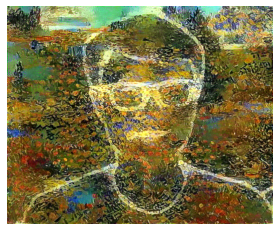

style_transfer     Step: 262ms    | Loss: 7.34e+06 | diff: 72.750%  | lr: 1.000e+00  | epoch: 8  ( 850/1000 )
content_loss 316.3743591308594 style_loss 7334724.5
style_transfer     Step: 248ms    | Loss: 7.33e+06 | diff: 72.755%  | lr: 1.000e+00  | epoch: 8  ( 860/1000 )
content_loss 316.37689208984375 style_loss 7333089.5
style_transfer     Step: 259ms    | Loss: 7.33e+06 | diff: 72.759%  | lr: 1.000e+00  | epoch: 8  ( 870/1000 )
content_loss 316.3731994628906 style_loss 7331567.0
style_transfer     Step: 248ms    | Loss: 7.33e+06 | diff: 72.763%  | lr: 1.000e+00  | epoch: 8  ( 880/1000 )
content_loss 316.377685546875 style_loss 7330139.0
style_transfer     Step: 268ms    | Loss: 7.33e+06 | diff: 72.767%  | lr: 1.000e+00  | epoch: 8  ( 890/1000 )
content_loss 316.3807373046875 style_loss 7328612.5


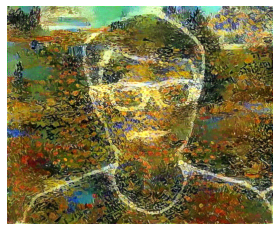

style_transfer     Step: 270ms    | Loss: 7.33e+06 | diff: 72.771%  | lr: 1.000e+00  | epoch: 8  ( 900/1000 )
content_loss 316.38323974609375 style_loss 7327211.5
style_transfer     Step: 248ms    | Loss: 7.33e+06 | diff: 72.775%  | lr: 1.000e+00  | epoch: 8  ( 910/1000 )
content_loss 316.3851013183594 style_loss 7325853.0
style_transfer     Step: 258ms    | Loss: 7.32e+06 | diff: 72.779%  | lr: 1.000e+00  | epoch: 8  ( 920/1000 )
content_loss 316.384765625 style_loss 7324311.5
style_transfer     Step: 247ms    | Loss: 7.32e+06 | diff: 72.783%  | lr: 1.000e+00  | epoch: 8  ( 930/1000 )
content_loss 316.38787841796875 style_loss 7322860.5
style_transfer     Step: 248ms    | Loss: 7.32e+06 | diff: 72.787%  | lr: 1.000e+00  | epoch: 8  ( 940/1000 )
content_loss 316.3900146484375 style_loss 7321418.5


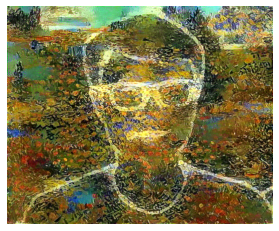

style_transfer     Step: 261ms    | Loss: 7.32e+06 | diff: 72.791%  | lr: 1.000e+00  | epoch: 8  ( 950/1000 )
content_loss 316.3867492675781 style_loss 7319994.0
style_transfer     Step: 248ms    | Loss: 7.32e+06 | diff: 72.795%  | lr: 1.000e+00  | epoch: 8  ( 960/1000 )
content_loss 316.38751220703125 style_loss 7318433.5
style_transfer     Step: 259ms    | Loss: 7.32e+06 | diff: 72.800%  | lr: 1.000e+00  | epoch: 8  ( 970/1000 )
content_loss 316.3866271972656 style_loss 7316888.5
style_transfer     Step: 248ms    | Loss: 7.32e+06 | diff: 72.804%  | lr: 1.000e+00  | epoch: 8  ( 980/1000 )
content_loss 316.3879699707031 style_loss 7315403.0
style_transfer     Step: 248ms    | Loss: 7.31e+06 | diff: 72.808%  | lr: 1.000e+00  | epoch: 8  ( 990/1000 )
content_loss 316.3860778808594 style_loss 7313895.5


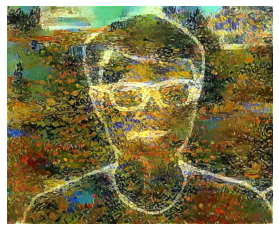

{ content_loss: 3.16e+02, style_loss: 7.31e+06, total_variation_norm_reg_Loss: 5.84, total_losses: 7.31e+06 }
content_loss 316.38623046875 style_loss 7312533.5
style_transfer     Step: 473ms    | Loss: 7.31e+06 | diff: 72.815%  | lr: 1.000e+00  | epoch: 9  ( 10/1000 )
content_loss 316.38616943359375 style_loss 7311019.0
style_transfer     Step: 248ms    | Loss: 7.31e+06 | diff: 72.820%  | lr: 1.000e+00  | epoch: 9  ( 20/1000 )
content_loss 316.3868408203125 style_loss 7309563.5
style_transfer     Step: 248ms    | Loss: 7.31e+06 | diff: 72.824%  | lr: 1.000e+00  | epoch: 9  ( 30/1000 )
content_loss 316.38726806640625 style_loss 7308021.5
style_transfer     Step: 249ms    | Loss: 7.31e+06 | diff: 72.828%  | lr: 1.000e+00  | epoch: 9  ( 40/1000 )
content_loss 316.38690185546875 style_loss 7306589.0


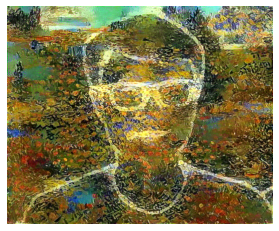

style_transfer     Step: 262ms    | Loss: 7.31e+06 | diff: 72.832%  | lr: 1.000e+00  | epoch: 9  ( 50/1000 )
content_loss 316.3899230957031 style_loss 7305253.0
style_transfer     Step: 260ms    | Loss: 7.3e+06 | diff: 72.836%  | lr: 1.000e+00  | epoch: 9  ( 60/1000 )
content_loss 316.3907775878906 style_loss 7303804.0
style_transfer     Step: 248ms    | Loss: 7.3e+06 | diff: 72.840%  | lr: 1.000e+00  | epoch: 9  ( 70/1000 )
content_loss 316.39202880859375 style_loss 7302206.0
style_transfer     Step: 249ms    | Loss: 7.3e+06 | diff: 72.844%  | lr: 1.000e+00  | epoch: 9  ( 80/1000 )
content_loss 316.3914489746094 style_loss 7300748.5
style_transfer     Step: 250ms    | Loss: 7.3e+06 | diff: 72.848%  | lr: 1.000e+00  | epoch: 9  ( 90/1000 )
content_loss 316.3924865722656 style_loss 7299570.5


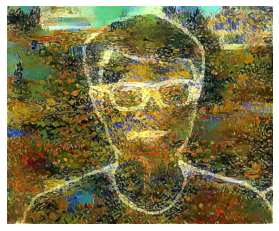

style_transfer     Step: 262ms    | Loss: 7.3e+06 | diff: 72.852%  | lr: 1.000e+00  | epoch: 9  ( 100/1000 )
content_loss 316.39080810546875 style_loss 7298118.0
style_transfer     Step: 260ms    | Loss: 7.3e+06 | diff: 72.856%  | lr: 1.000e+00  | epoch: 9  ( 110/1000 )
content_loss 316.3941650390625 style_loss 7296612.5
style_transfer     Step: 247ms    | Loss: 7.3e+06 | diff: 72.860%  | lr: 1.000e+00  | epoch: 9  ( 120/1000 )
content_loss 316.39959716796875 style_loss 7295475.5
style_transfer     Step: 248ms    | Loss: 7.29e+06 | diff: 72.863%  | lr: 1.000e+00  | epoch: 9  ( 130/1000 )
content_loss 316.3943786621094 style_loss 7294078.0
style_transfer     Step: 248ms    | Loss: 7.29e+06 | diff: 72.867%  | lr: 1.000e+00  | epoch: 9  ( 140/1000 )
content_loss 316.3968200683594 style_loss 7292722.5


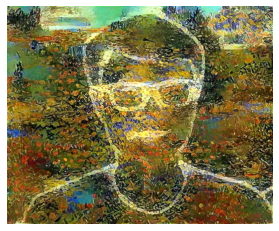

style_transfer     Step: 262ms    | Loss: 7.29e+06 | diff: 72.871%  | lr: 1.000e+00  | epoch: 9  ( 150/1000 )
content_loss 316.39447021484375 style_loss 7291208.0
style_transfer     Step: 258ms    | Loss: 7.29e+06 | diff: 72.875%  | lr: 1.000e+00  | epoch: 9  ( 160/1000 )
content_loss 316.39404296875 style_loss 7289871.0
style_transfer     Step: 248ms    | Loss: 7.29e+06 | diff: 72.878%  | lr: 1.000e+00  | epoch: 9  ( 170/1000 )
content_loss 316.396728515625 style_loss 7288526.0
style_transfer     Step: 262ms    | Loss: 7.29e+06 | diff: 72.882%  | lr: 1.000e+00  | epoch: 9  ( 180/1000 )
content_loss 316.3903503417969 style_loss 7287146.0
style_transfer     Step: 258ms    | Loss: 7.29e+06 | diff: 72.885%  | lr: 1.000e+00  | epoch: 9  ( 190/1000 )
content_loss 316.3927917480469 style_loss 7285921.5


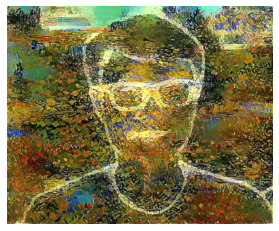

style_transfer     Step: 263ms    | Loss: 7.28e+06 | diff: 72.889%  | lr: 1.000e+00  | epoch: 9  ( 200/1000 )
content_loss 316.392578125 style_loss 7284517.5
style_transfer     Step: 259ms    | Loss: 7.28e+06 | diff: 72.893%  | lr: 1.000e+00  | epoch: 9  ( 210/1000 )
content_loss 316.39697265625 style_loss 7283118.0
style_transfer     Step: 249ms    | Loss: 7.28e+06 | diff: 72.897%  | lr: 1.000e+00  | epoch: 9  ( 220/1000 )
content_loss 316.3946533203125 style_loss 7281737.0
style_transfer     Step: 249ms    | Loss: 7.28e+06 | diff: 72.900%  | lr: 1.000e+00  | epoch: 9  ( 230/1000 )
content_loss 316.3951110839844 style_loss 7280481.0
style_transfer     Step: 248ms    | Loss: 7.28e+06 | diff: 72.904%  | lr: 1.000e+00  | epoch: 9  ( 240/1000 )
content_loss 316.39202880859375 style_loss 7278978.5


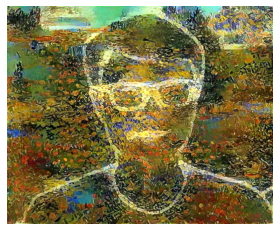

style_transfer     Step: 263ms    | Loss: 7.28e+06 | diff: 72.908%  | lr: 1.000e+00  | epoch: 9  ( 250/1000 )
content_loss 316.39227294921875 style_loss 7277667.5
style_transfer     Step: 259ms    | Loss: 7.28e+06 | diff: 72.911%  | lr: 1.000e+00  | epoch: 9  ( 260/1000 )
content_loss 316.38690185546875 style_loss 7276343.5
style_transfer     Step: 249ms    | Loss: 7.28e+06 | diff: 72.916%  | lr: 1.000e+00  | epoch: 9  ( 270/1000 )
content_loss 316.3885192871094 style_loss 7274785.0
style_transfer     Step: 249ms    | Loss: 7.27e+06 | diff: 72.919%  | lr: 1.000e+00  | epoch: 9  ( 280/1000 )
content_loss 316.3851318359375 style_loss 7273519.5
style_transfer     Step: 248ms    | Loss: 7.27e+06 | diff: 72.924%  | lr: 1.000e+00  | epoch: 9  ( 290/1000 )
content_loss 316.3830261230469 style_loss 7272116.5


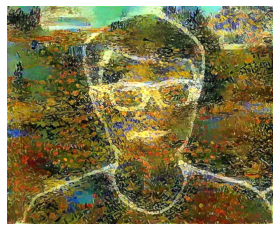

style_transfer     Step: 266ms    | Loss: 7.27e+06 | diff: 72.927%  | lr: 1.000e+00  | epoch: 9  ( 300/1000 )
content_loss 316.3863830566406 style_loss 7270782.5
style_transfer     Step: 260ms    | Loss: 7.27e+06 | diff: 72.931%  | lr: 1.000e+00  | epoch: 9  ( 310/1000 )
content_loss 316.3876037597656 style_loss 7269486.5
style_transfer     Step: 249ms    | Loss: 7.27e+06 | diff: 72.935%  | lr: 1.000e+00  | epoch: 9  ( 320/1000 )
content_loss 316.388671875 style_loss 7268043.5
style_transfer     Step: 249ms    | Loss: 7.27e+06 | diff: 72.938%  | lr: 1.000e+00  | epoch: 9  ( 330/1000 )
content_loss 316.3913269042969 style_loss 7266643.0
style_transfer     Step: 248ms    | Loss: 7.27e+06 | diff: 72.942%  | lr: 1.000e+00  | epoch: 9  ( 340/1000 )
content_loss 316.3902893066406 style_loss 7265295.0


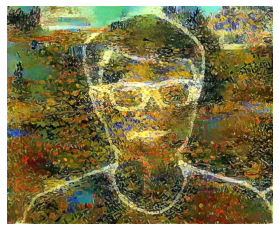

style_transfer     Step: 263ms    | Loss: 7.26e+06 | diff: 72.945%  | lr: 1.000e+00  | epoch: 9  ( 350/1000 )
content_loss 316.393310546875 style_loss 7264135.5
style_transfer     Step: 258ms    | Loss: 7.26e+06 | diff: 72.948%  | lr: 1.000e+00  | epoch: 9  ( 360/1000 )
content_loss 316.39208984375 style_loss 7262777.0
style_transfer     Step: 250ms    | Loss: 7.26e+06 | diff: 72.952%  | lr: 1.000e+00  | epoch: 9  ( 370/1000 )
content_loss 316.393798828125 style_loss 7261483.0
style_transfer     Step: 249ms    | Loss: 7.26e+06 | diff: 72.956%  | lr: 1.000e+00  | epoch: 9  ( 380/1000 )
content_loss 316.39483642578125 style_loss 7260213.0
style_transfer     Step: 249ms    | Loss: 7.26e+06 | diff: 72.960%  | lr: 1.000e+00  | epoch: 9  ( 390/1000 )
content_loss 316.39654541015625 style_loss 7258823.0


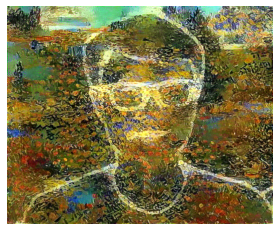

style_transfer     Step: 264ms    | Loss: 7.26e+06 | diff: 72.963%  | lr: 1.000e+00  | epoch: 9  ( 400/1000 )
content_loss 316.400390625 style_loss 7257498.0
style_transfer     Step: 260ms    | Loss: 7.26e+06 | diff: 72.967%  | lr: 1.000e+00  | epoch: 9  ( 410/1000 )
content_loss 316.4038391113281 style_loss 7256285.5
style_transfer     Step: 249ms    | Loss: 7.26e+06 | diff: 72.970%  | lr: 1.000e+00  | epoch: 9  ( 420/1000 )
content_loss 316.39923095703125 style_loss 7255005.5
style_transfer     Step: 249ms    | Loss: 7.25e+06 | diff: 72.974%  | lr: 1.000e+00  | epoch: 9  ( 430/1000 )
content_loss 316.404052734375 style_loss 7253694.0
style_transfer     Step: 249ms    | Loss: 7.25e+06 | diff: 72.977%  | lr: 1.000e+00  | epoch: 9  ( 440/1000 )
content_loss 316.405517578125 style_loss 7252390.0


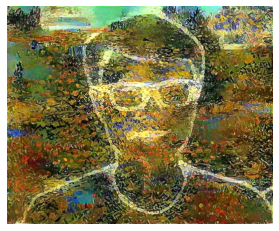

style_transfer     Step: 263ms    | Loss: 7.25e+06 | diff: 72.980%  | lr: 1.000e+00  | epoch: 9  ( 450/1000 )
content_loss 316.4041748046875 style_loss 7251244.5
style_transfer     Step: 263ms    | Loss: 7.25e+06 | diff: 72.983%  | lr: 1.000e+00  | epoch: 9  ( 460/1000 )
content_loss 316.404541015625 style_loss 7250114.0
style_transfer     Step: 269ms    | Loss: 7.25e+06 | diff: 72.986%  | lr: 1.000e+00  | epoch: 9  ( 470/1000 )
content_loss 316.40447998046875 style_loss 7248896.5
style_transfer     Step: 263ms    | Loss: 7.25e+06 | diff: 72.990%  | lr: 1.000e+00  | epoch: 9  ( 480/1000 )
content_loss 316.404296875 style_loss 7247520.0
style_transfer     Step: 248ms    | Loss: 7.25e+06 | diff: 72.994%  | lr: 1.000e+00  | epoch: 9  ( 490/1000 )
content_loss 316.4090576171875 style_loss 7246241.0


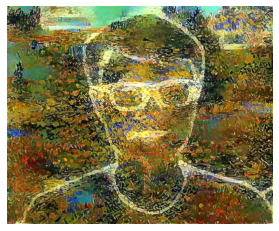

style_transfer     Step: 262ms    | Loss: 7.25e+06 | diff: 72.997%  | lr: 1.000e+00  | epoch: 9  ( 500/1000 )
content_loss 316.40521240234375 style_loss 7244954.5
style_transfer     Step: 259ms    | Loss: 7.24e+06 | diff: 73.002%  | lr: 1.000e+00  | epoch: 9  ( 510/1000 )
content_loss 316.40484619140625 style_loss 7243620.0
style_transfer     Step: 248ms    | Loss: 7.24e+06 | diff: 73.005%  | lr: 1.000e+00  | epoch: 9  ( 520/1000 )
content_loss 316.4065246582031 style_loss 7242333.5
style_transfer     Step: 248ms    | Loss: 7.24e+06 | diff: 73.008%  | lr: 1.000e+00  | epoch: 9  ( 530/1000 )
content_loss 316.407958984375 style_loss 7240926.5
style_transfer     Step: 248ms    | Loss: 7.24e+06 | diff: 73.012%  | lr: 1.000e+00  | epoch: 9  ( 540/1000 )
content_loss 316.4065856933594 style_loss 7239627.5


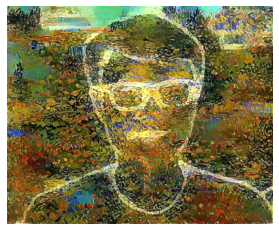

style_transfer     Step: 264ms    | Loss: 7.24e+06 | diff: 73.016%  | lr: 1.000e+00  | epoch: 9  ( 550/1000 )
content_loss 316.40423583984375 style_loss 7238164.0
style_transfer     Step: 259ms    | Loss: 7.24e+06 | diff: 73.020%  | lr: 1.000e+00  | epoch: 9  ( 560/1000 )
content_loss 316.4061279296875 style_loss 7236921.0
style_transfer     Step: 248ms    | Loss: 7.24e+06 | diff: 73.023%  | lr: 1.000e+00  | epoch: 9  ( 570/1000 )
content_loss 316.4086608886719 style_loss 7235727.5
style_transfer     Step: 249ms    | Loss: 7.23e+06 | diff: 73.027%  | lr: 1.000e+00  | epoch: 9  ( 580/1000 )
content_loss 316.4075927734375 style_loss 7234406.5
style_transfer     Step: 248ms    | Loss: 7.23e+06 | diff: 73.030%  | lr: 1.000e+00  | epoch: 9  ( 590/1000 )
content_loss 316.4093933105469 style_loss 7233184.0


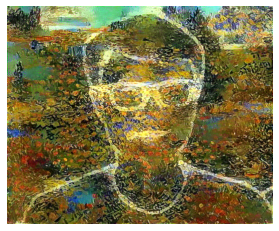

style_transfer     Step: 264ms    | Loss: 7.23e+06 | diff: 73.033%  | lr: 1.000e+00  | epoch: 9  ( 600/1000 )
content_loss 316.4082946777344 style_loss 7231894.5
style_transfer     Step: 249ms    | Loss: 7.23e+06 | diff: 73.037%  | lr: 1.000e+00  | epoch: 9  ( 610/1000 )
content_loss 316.40606689453125 style_loss 7230635.0
style_transfer     Step: 249ms    | Loss: 7.23e+06 | diff: 73.041%  | lr: 1.000e+00  | epoch: 9  ( 620/1000 )
content_loss 316.410888671875 style_loss 7229329.0
style_transfer     Step: 249ms    | Loss: 7.23e+06 | diff: 73.044%  | lr: 1.000e+00  | epoch: 9  ( 630/1000 )
content_loss 316.4097900390625 style_loss 7228083.0
style_transfer     Step: 249ms    | Loss: 7.23e+06 | diff: 73.048%  | lr: 1.000e+00  | epoch: 9  ( 640/1000 )
content_loss 316.4101257324219 style_loss 7226929.5


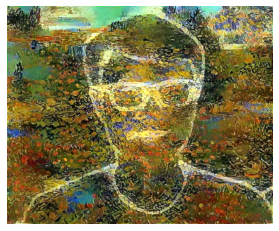

style_transfer     Step: 271ms    | Loss: 7.23e+06 | diff: 73.051%  | lr: 1.000e+00  | epoch: 9  ( 650/1000 )
content_loss 316.4084777832031 style_loss 7225665.0
style_transfer     Step: 249ms    | Loss: 7.22e+06 | diff: 73.055%  | lr: 1.000e+00  | epoch: 9  ( 660/1000 )
content_loss 316.40753173828125 style_loss 7224369.5
style_transfer     Step: 250ms    | Loss: 7.22e+06 | diff: 73.058%  | lr: 1.000e+00  | epoch: 9  ( 670/1000 )
content_loss 316.40887451171875 style_loss 7223166.0
style_transfer     Step: 248ms    | Loss: 7.22e+06 | diff: 73.061%  | lr: 1.000e+00  | epoch: 9  ( 680/1000 )
content_loss 316.4073181152344 style_loss 7222009.0
style_transfer     Step: 249ms    | Loss: 7.22e+06 | diff: 73.065%  | lr: 1.000e+00  | epoch: 9  ( 690/1000 )
content_loss 316.40948486328125 style_loss 7220741.0


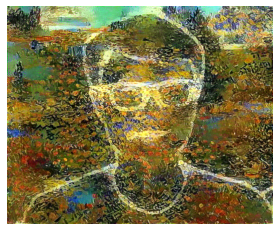

style_transfer     Step: 273ms    | Loss: 7.22e+06 | diff: 73.069%  | lr: 1.000e+00  | epoch: 9  ( 700/1000 )
content_loss 316.40771484375 style_loss 7219550.0
style_transfer     Step: 249ms    | Loss: 7.22e+06 | diff: 73.071%  | lr: 1.000e+00  | epoch: 9  ( 710/1000 )
content_loss 316.40765380859375 style_loss 7218392.5
style_transfer     Step: 249ms    | Loss: 7.22e+06 | diff: 73.075%  | lr: 1.000e+00  | epoch: 9  ( 720/1000 )
content_loss 316.41009521484375 style_loss 7217110.5
style_transfer     Step: 248ms    | Loss: 7.22e+06 | diff: 73.078%  | lr: 1.000e+00  | epoch: 9  ( 730/1000 )
content_loss 316.4105224609375 style_loss 7215851.0
style_transfer     Step: 249ms    | Loss: 7.21e+06 | diff: 73.082%  | lr: 1.000e+00  | epoch: 9  ( 740/1000 )
content_loss 316.40997314453125 style_loss 7214590.5


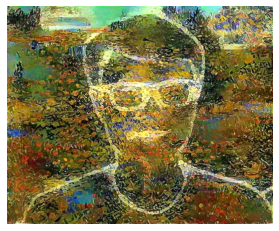

style_transfer     Step: 281ms    | Loss: 7.21e+06 | diff: 73.086%  | lr: 1.000e+00  | epoch: 9  ( 750/1000 )
content_loss 316.4115905761719 style_loss 7213279.5
style_transfer     Step: 268ms    | Loss: 7.21e+06 | diff: 73.089%  | lr: 1.000e+00  | epoch: 9  ( 760/1000 )
content_loss 316.41278076171875 style_loss 7212160.0
style_transfer     Step: 268ms    | Loss: 7.21e+06 | diff: 73.092%  | lr: 1.000e+00  | epoch: 9  ( 770/1000 )
content_loss 316.4143981933594 style_loss 7210864.0
style_transfer     Step: 248ms    | Loss: 7.21e+06 | diff: 73.095%  | lr: 1.000e+00  | epoch: 9  ( 780/1000 )
content_loss 316.41387939453125 style_loss 7209732.5
style_transfer     Step: 250ms    | Loss: 7.21e+06 | diff: 73.099%  | lr: 1.000e+00  | epoch: 9  ( 790/1000 )
content_loss 316.41094970703125 style_loss 7208482.0


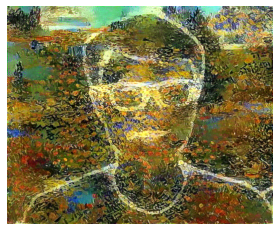

style_transfer     Step: 262ms    | Loss: 7.21e+06 | diff: 73.102%  | lr: 1.000e+00  | epoch: 9  ( 800/1000 )
content_loss 316.4129943847656 style_loss 7207193.0
style_transfer     Step: 249ms    | Loss: 7.21e+06 | diff: 73.105%  | lr: 1.000e+00  | epoch: 9  ( 810/1000 )
content_loss 316.41009521484375 style_loss 7206042.0
style_transfer     Step: 256ms    | Loss: 7.21e+06 | diff: 73.109%  | lr: 1.000e+00  | epoch: 9  ( 820/1000 )
content_loss 316.4117126464844 style_loss 7204976.5
style_transfer     Step: 288ms    | Loss: 7.2e+06 | diff: 73.112%  | lr: 1.000e+00  | epoch: 9  ( 830/1000 )
content_loss 316.40936279296875 style_loss 7203786.0
style_transfer     Step: 258ms    | Loss: 7.2e+06 | diff: 73.115%  | lr: 1.000e+00  | epoch: 9  ( 840/1000 )
content_loss 316.4060974121094 style_loss 7202425.5


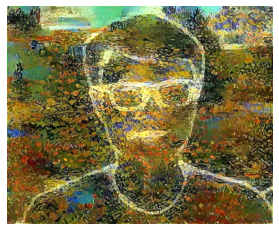

style_transfer     Step: 264ms    | Loss: 7.2e+06 | diff: 73.119%  | lr: 1.000e+00  | epoch: 9  ( 850/1000 )
content_loss 316.4090576171875 style_loss 7201237.0
style_transfer     Step: 251ms    | Loss: 7.2e+06 | diff: 73.122%  | lr: 1.000e+00  | epoch: 9  ( 860/1000 )
content_loss 316.4100646972656 style_loss 7200119.0
style_transfer     Step: 249ms    | Loss: 7.2e+06 | diff: 73.126%  | lr: 1.000e+00  | epoch: 9  ( 870/1000 )
content_loss 316.4122314453125 style_loss 7198858.5
style_transfer     Step: 250ms    | Loss: 7.2e+06 | diff: 73.129%  | lr: 1.000e+00  | epoch: 9  ( 880/1000 )
content_loss 316.41552734375 style_loss 7197666.5
style_transfer     Step: 250ms    | Loss: 7.2e+06 | diff: 73.132%  | lr: 1.000e+00  | epoch: 9  ( 890/1000 )
content_loss 316.41845703125 style_loss 7196581.0


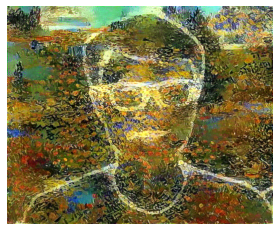

style_transfer     Step: 264ms    | Loss: 7.2e+06 | diff: 73.136%  | lr: 1.000e+00  | epoch: 9  ( 900/1000 )
content_loss 316.4170227050781 style_loss 7195322.5
style_transfer     Step: 257ms    | Loss: 7.19e+06 | diff: 73.139%  | lr: 1.000e+00  | epoch: 9  ( 910/1000 )
content_loss 316.41778564453125 style_loss 7194107.0
style_transfer     Step: 276ms    | Loss: 7.19e+06 | diff: 73.143%  | lr: 1.000e+00  | epoch: 9  ( 920/1000 )
content_loss 316.4208679199219 style_loss 7192916.0
style_transfer     Step: 249ms    | Loss: 7.19e+06 | diff: 73.145%  | lr: 1.000e+00  | epoch: 9  ( 930/1000 )
content_loss 316.4183044433594 style_loss 7191821.0
style_transfer     Step: 252ms    | Loss: 7.19e+06 | diff: 73.149%  | lr: 1.000e+00  | epoch: 9  ( 940/1000 )
content_loss 316.4212341308594 style_loss 7190640.0


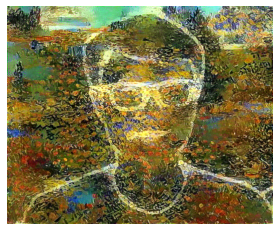

style_transfer     Step: 307ms    | Loss: 7.19e+06 | diff: 73.152%  | lr: 1.000e+00  | epoch: 9  ( 950/1000 )
content_loss 316.4197082519531 style_loss 7189490.5
style_transfer     Step: 250ms    | Loss: 7.19e+06 | diff: 73.155%  | lr: 1.000e+00  | epoch: 9  ( 960/1000 )
content_loss 316.4202880859375 style_loss 7188333.5
style_transfer     Step: 249ms    | Loss: 7.19e+06 | diff: 73.159%  | lr: 1.000e+00  | epoch: 9  ( 970/1000 )
content_loss 316.4228210449219 style_loss 7187270.5
style_transfer     Step: 249ms    | Loss: 7.19e+06 | diff: 73.161%  | lr: 1.000e+00  | epoch: 9  ( 980/1000 )
content_loss 316.4199523925781 style_loss 7186141.5
style_transfer     Step: 249ms    | Loss: 7.19e+06 | diff: 73.165%  | lr: 1.000e+00  | epoch: 9  ( 990/1000 )
content_loss 316.4220275878906 style_loss 7185025.5


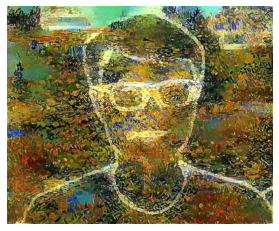

Yor model is a Tensor not a nn.Module, it has saved as numpy array(*.npy) successfully. 

In [ ]:
plan.start_now()